
"I am deeply grateful to **Mr. Mohammad Hossein Najafi** for his invaluable guidance and support throughout this project. His expertise was essential to its success."

#**Title: Bank Customer Credit Risk Assessment**

**Author:** Fateme Khanipour

**Description:**

This machine learning project focuses on predicting the creditworthiness of bank customers. By utilizing a dataset containing various customer attributes, a classification model is developed to identify customers with a high risk of defaulting on their loans. The project aims to assist the bank in making informed lending decisions and mitigating credit risk.

# **Methods**

**Data Exploration and Preparation**


*   **Data Cleaning:** Fill in missing values, Remove redundant columns.
*  **Data Analysis:** Check correlation, Statistical analysis,analyze columns, and identify outliers.

*   **Data Distribution:** Check for normal distribution.

**Feature Engineering**


*   **Feature Selection:** Employ filter and wrapper methods.
*  **Data Preprocessing:**  Using the Columns Transformer apply Box-Cox transformation for numerical columns and target encoding for categorical columns.

*  **Data balancing:** Data resampling with ADASYN technique




**Model Building and Evaluation:**



* **Pipeline Creation:** Define a pipeline including data scaling, feature engineering, and model selection.  

*  **Model Training:**Test Random Forest, Logistic Regression, XG Boost, Voting and MLP models.

*   **Hyperparameter Tuning:**  Optimize model parameters.Using Random Search and Grid Search and Optuna algorithms

*   **Cross-Validation:**  Evaluate model performance using cross-validation.(StratifiedKFold, RepeatedKFold,KFold)

*  **Model Evaluation:** Checking the performance of the model on the test data.

**Clustering:**


*  **Dimensionality Reduction:** PCA, TSNE, UMAP

*  **clustering:** KMeans, DBSCAN, OPTICS, Kmode

















In [ ]:
%load_ext watermark
# %watermark  -a 'Fateme Khanipour' -u -d -v -p pandas,plotly,seaborn,matplotlib,numpy,scipy,mlxtend,scikit-learn
%watermark  -u -d -v -p pandas,plotly,seaborn,matplotlib,numpy,scipy,mlxtend,scikit-learn

Last updated: 2024-05-17

Python implementation: CPython
Python version       : 3.10.12
IPython version      : 7.34.0

pandas      : 2.0.3
plotly      : 5.15.0
seaborn     : 0.13.1
matplotlib  : 3.7.1
numpy       : 1.25.2
scipy       : 1.11.4
mlxtend     : 0.22.0
scikit-learn: 1.2.2



# **Import Libraries**

In [ ]:
import warnings
warnings.filterwarnings('ignore')
import math
from random import randint
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.cm import ScalarMappable
import plotly.graph_objects as go
import plotly.express as px
import seaborn as sns
import scipy.stats as stats
from scipy.stats import uniform
from scipy.stats import skew, kurtosis, pearsonr
from scipy.stats import spearmanr, kendalltau, pointbiserialr
import associations as am
from dython.nominal import associations
from collections import Counter
from tqdm import tqdm
%matplotlib inline

In [ ]:
from sklearn.feature_selection import VarianceThreshold, mutual_info_classif,f_classif,  SelectKBest, SelectPercentile, chi2
from sklearn.feature_selection import SelectFromModel, RFE
from mlxtend.feature_selection import SequentialFeatureSelector
from mlxtend.feature_selection import SequentialFeatureSelector as SFS
from mlxtend.plotting import plot_sequential_feature_selection as plot_sfs
from mlxtend.feature_selection import ExhaustiveFeatureSelector
from mlxtend.feature_selection import ExhaustiveFeatureSelector as EFS
from imblearn.over_sampling import SMOTE, RandomOverSampler, ADASYN
from imblearn.combine import SMOTETomek
import category_encoders as ce
from skopt import BayesSearchCV



In [ ]:
# from category_encoders import TargetEncoder (leave-one-out (loo) encoding)
from sklearn.preprocessing import (Normalizer, StandardScaler, MinMaxScaler, LabelEncoder, StandardScaler,
                                   OneHotEncoder,
                                   OrdinalEncoder, TargetEncoder, PowerTransformer, power_transform,
                                   FunctionTransformer, RobustScaler)

from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline, make_pipeline


from sklearn.model_selection import (TunedThresholdClassifierCV, train_test_split,
                                     StratifiedKFold, cross_val_score, ParameterGrid, StratifiedShuffleSplit,
                                    GridSearchCV, KFold, RandomizedSearchCV, RepeatedKFold)

from sklearn.metrics import (davies_bouldin_score, calinski_harabasz_score, silhouette_score,
                             adjusted_rand_score, jaccard_score, v_measure_score, adjusted_mutual_info_score)

from sklearn.metrics import (accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, roc_curve,
                             confusion_matrix, ConfusionMatrixDisplay, classification_report)

from sklearn.decomposition import PCA, FactorAnalysis
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.manifold import TSNE
import umap
from umap import UMAP
from mpl_toolkits.mplot3d import Axes3D
from sklearn.neighbors import NearestNeighbors, KNeighborsClassifier, LocalOutlierFactor
from kneed import KneeLocator
import optuna
import shap
from optuna.samplers import TPESampler
from optuna.integration import OptunaSearchCV
from sklearn.cluster import KMeans, DBSCAN, OPTICS
from yellowbrick.cluster import KElbowVisualizer
from kmodes.kmodes import KModes
from kmodes.kprototypes import KPrototypes
from sklearn_extra.cluster import KMedoids
from sklearn.linear_model import LogisticRegression
import lightgbm as lgb
from sklearn.tree import DecisionTreeClassifier
from lightgbm import LGBMClassifier
from xgboost import XGBClassifier
from sklearn.ensemble import IsolationForest, RandomForestClassifier, VotingClassifier
# from mlflow.xgboost import XGBoostModel
from sklearn.inspection import permutation_importance




# **Data Cleaning and EDA**

In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split


In [ ]:
from google.colab import files
uploaded = files.upload()

KeyboardInterrupt: 

In [ ]:
data = pd.read_csv("/content/train.csv")
data.head()

,loan_amnt,funded_amnt,pymnt_plan,grade,sub_grade_num,short_emp,emp_length_num,home_ownership,dti,purpose,...,delinq_2yrs,delinq_2yrs_zero,inq_last_6mths,last_delinq_none,last_major_derog_none,open_acc,pub_rec,pub_rec_zero,revol_util,bad_loans
0,5000,5000,n,B,0.4,0,11,RENT,27.65,credit_card,...,0.0,1.0,1.0,1,1,3.0,0.0,1.0,83.7,0
1,2400,2400,n,C,1.0,0,11,RENT,8.72,small_business,...,0.0,1.0,2.0,1,1,2.0,0.0,1.0,98.5,0
2,5000,5000,n,A,0.8,0,4,RENT,11.20,wedding,...,0.0,1.0,3.0,1,1,9.0,0.0,1.0,28.3,0
3,3000,3000,n,E,0.2,0,10,RENT,5.35,car,...,0.0,1.0,2.0,1,1,4.0,0.0,1.0,87.5,0
4,5600,5600,n,F,0.4,0,5,OWN,5.55,small_business,...,0.0,1.0,2.0,1,1,11.0,0.0,1.0,32.6,1


In [ ]:
all_columns = data.columns
all_columns

Index(['loan_amnt', 'funded_amnt', 'pymnt_plan', 'grade', 'sub_grade_num',
       'short_emp', 'emp_length_num', 'home_ownership', 'dti', 'purpose',
       'payment_inc_ratio', 'delinq_2yrs', 'delinq_2yrs_zero',
       'inq_last_6mths', 'last_delinq_none', 'last_major_derog_none',
       'open_acc', 'pub_rec', 'pub_rec_zero', 'revol_util', 'bad_loans'],
      dtype='object')

In [ ]:
print("shape :",data.shape)

shape : (81738, 21)


In [ ]:
print(data.isna().sum())

loan_amnt                 0
funded_amnt               0
pymnt_plan                0
grade                     0
sub_grade_num             0
short_emp                 0
emp_length_num            0
home_ownership            0
dti                       0
purpose                   0
payment_inc_ratio         1
delinq_2yrs              16
delinq_2yrs_zero         16
inq_last_6mths           16
last_delinq_none          0
last_major_derog_none     0
open_acc                 16
pub_rec                  16
pub_rec_zero             16
revol_util                0
bad_loans                 0
dtype: int64


In [ ]:
#data = data.dropna()
#Nan values were omitted due to small numbers compared to the data set

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 81738 entries, 0 to 81737
Data columns (total 21 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   loan_amnt              81738 non-null  int64  
 1   funded_amnt            81738 non-null  int64  
 2   pymnt_plan             81738 non-null  object 
 3   grade                  81738 non-null  object 
 4   sub_grade_num          81738 non-null  float64
 5   short_emp              81738 non-null  int64  
 6   emp_length_num         81738 non-null  int64  
 7   home_ownership         81738 non-null  object 
 8   dti                    81738 non-null  float64
 9   purpose                81738 non-null  object 
 10  payment_inc_ratio      81737 non-null  float64
 11  delinq_2yrs            81722 non-null  float64
 12  delinq_2yrs_zero       81722 non-null  float64
 13  inq_last_6mths         81722 non-null  float64
 14  last_delinq_none       81738 non-null  int64  
 15  la

**Separate numeric and categorical columns**

In [ ]:
# list(set(data.dtypes.tolist()))
# data_num = data.select_dtypes(include = ['float64', 'int64'])
data_num = data.select_dtypes(include = 'number')

In [ ]:
# Select columns that have exactly 2 unique values and are of object type
# categorical_columns = data.select_dtypes(include=['object']).columns
category_columns = [col for col in data.columns if data[col].nunique() == 2 or data[col].dtype == 'O']

# Add the 'sub_grade_num' column to the list
category_columns.append('sub_grade_num')

# Convert the selected columns to the 'category' data type
data[category_columns] = data[category_columns].astype('category')

In [ ]:
description = data_num.describe().T.round(3)

# Calculate skewness and kurtosis for each numeric column
skewness = data_num.skew().round(3)
kurt = data_num.kurtosis().round(3)
var = data_num.var().round(3)

# Add skewness and kurtosis to the description DataFrame
description['Skewness'] = skewness
description['Kurtosis'] = kurt
description['var'] = var
description

,count,mean,std,min,25%,50%,75%,max,Skewness,Kurtosis,var
loan_amnt,81738.0,12810.487,7936.486,500.000,6625.000,11000.000,17600.000,35000.000,0.888,0.273,6.298781e+07
funded_amnt,81738.0,12735.071,7888.874,500.000,6600.000,10950.000,17475.000,35000.000,0.900,0.317,6.223434e+07
sub_grade_num,81738.0,0.598,0.279,0.200,0.400,0.600,0.800,1.000,-0.001,-1.267,7.800000e-02
short_emp,81738.0,0.123,0.328,0.000,0.000,0.000,0.000,1.000,2.295,3.269,1.080000e-01
emp_length_num,81738.0,6.382,3.735,0.000,3.000,6.000,11.000,11.000,-0.065,-1.418,1.395200e+01
dti,81738.0,15.496,7.490,0.000,9.880,15.270,20.840,39.880,0.166,-0.545,5.609500e+01
payment_inc_ratio,81737.0,7.556,4.124,0.029,4.356,6.954,10.206,54.171,0.667,0.282,1.700900e+01
delinq_2yrs,81722.0,0.211,0.661,0.000,0.000,0.000,0.000,29.000,6.488,98.291,4.370000e-01
delinq_2yrs_zero,81722.0,0.858,0.349,0.000,1.000,1.000,1.000,1.000,-2.057,2.231,1.210000e-01
inq_last_6mths,81722.0,0.983,1.261,0.000,0.000,1.000,2.000,32.000,2.626,22.579,1.589000e+00


In [ ]:
category_summary = data.describe(include='category')
category_summary

,pymnt_plan,grade,sub_grade_num,short_emp,home_ownership,purpose,delinq_2yrs_zero,last_delinq_none,last_major_derog_none,pub_rec_zero,bad_loans
count,81738,81738,81738.0,81738,81738,81738,81722.0,81738,81738,81722.0,81738
unique,1,7,5.0,2,4,12,2.0,2,2,2.0,2
top,n,B,0.8,0,MORTGAGE,debt_consolidation,1.0,1,1,1.0,0
freq,81738,24775,17073.0,71682,39583,45428,70156.0,48157,71497,74165.0,66266


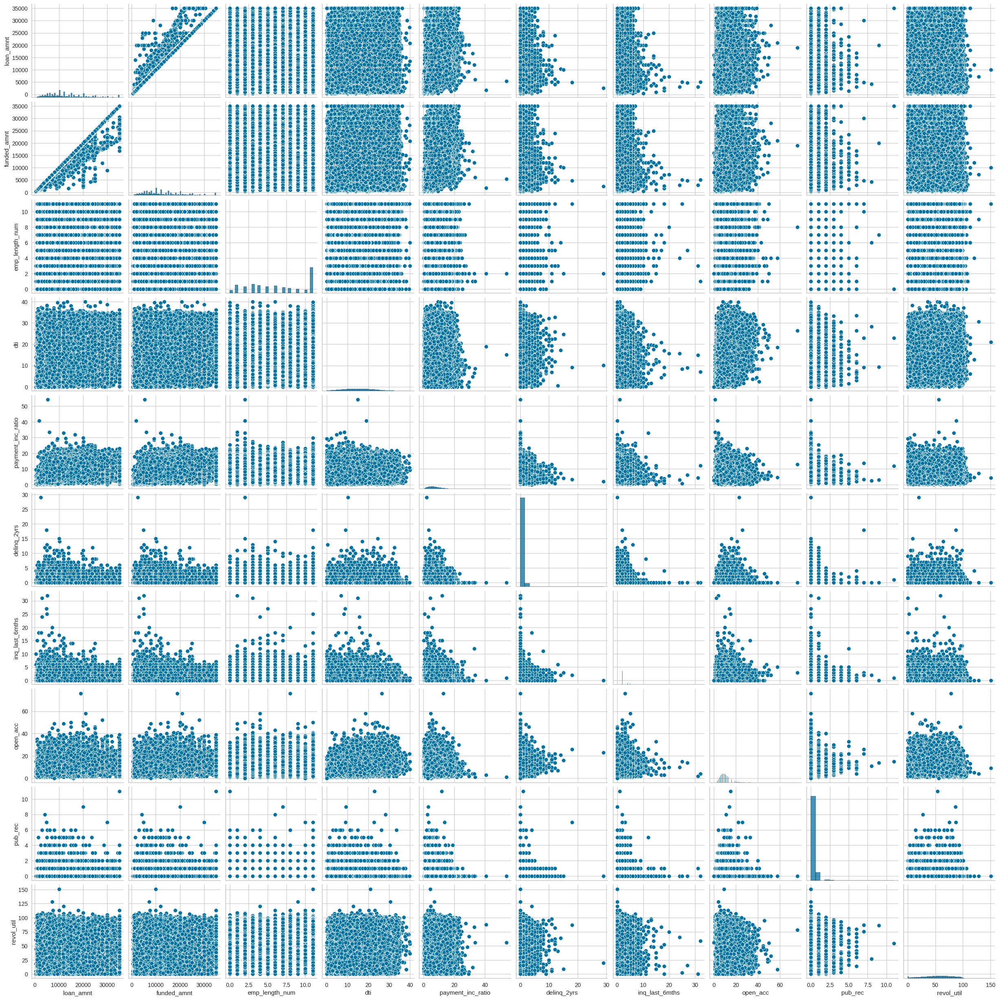

In [ ]:
sns.pairplot(data)

array([[<Axes: title={'center': 'loan_amnt'}>,
        <Axes: title={'center': 'funded_amnt'}>,
        <Axes: title={'center': 'sub_grade_num'}>,
        <Axes: title={'center': 'short_emp'}>],
       [<Axes: title={'center': 'emp_length_num'}>,
        <Axes: title={'center': 'dti'}>,
        <Axes: title={'center': 'payment_inc_ratio'}>,
        <Axes: title={'center': 'delinq_2yrs'}>],
       [<Axes: title={'center': 'delinq_2yrs_zero'}>,
        <Axes: title={'center': 'inq_last_6mths'}>,
        <Axes: title={'center': 'last_delinq_none'}>,
        <Axes: title={'center': 'last_major_derog_none'}>],
       [<Axes: title={'center': 'open_acc'}>,
        <Axes: title={'center': 'pub_rec'}>,
        <Axes: title={'center': 'pub_rec_zero'}>,
        <Axes: title={'center': 'revol_util'}>],
       [<Axes: title={'center': 'bad_loans'}>, <Axes: >, <Axes: >,
        <Axes: >]], dtype=object)

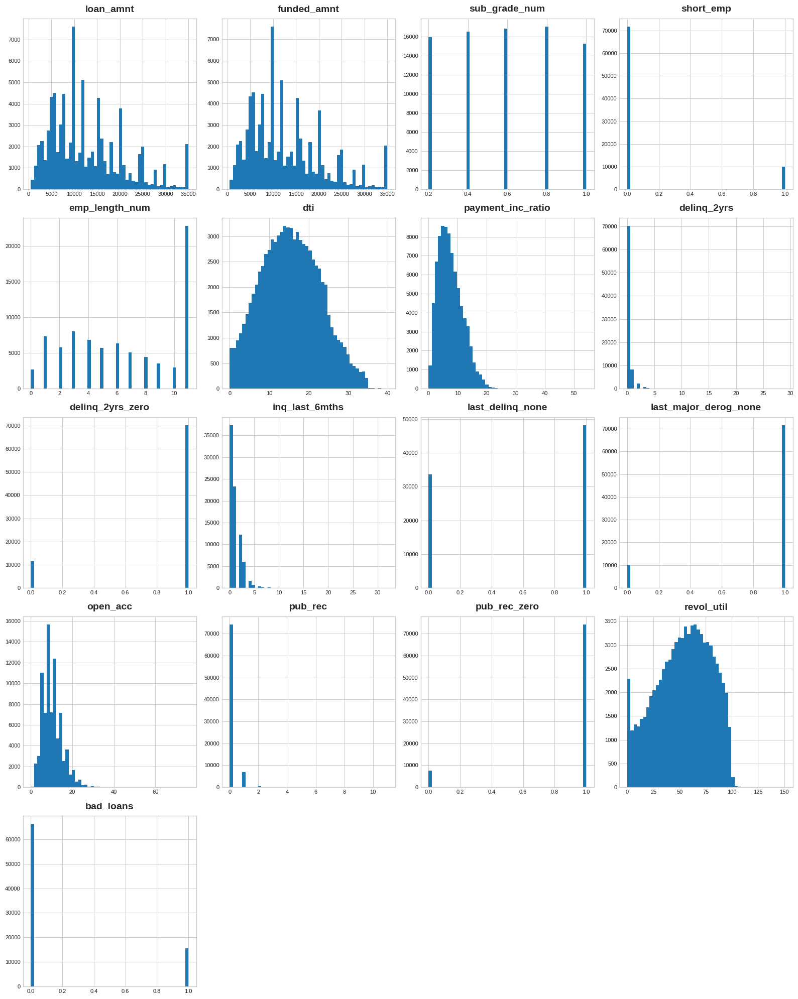

In [ ]:
data_num.hist(figsize=(16, 20), bins=50, xlabelsize=8, ylabelsize=8)

**Separate binary and number columns**

Upon reviewing the description table and data distribution chart, it becomes evident that columns with missing values deviate from a normal distribution. Consequently, these columns are imputed with the median value. As for columns containing categorical data, they are filled with the mode value

In [ ]:
# Extract binary columns
# binary_columns = data.select_dtypes(include=['bool', 'int64']).columns
binary_columns = [col for col in all_columns if data[col].nunique() == 2]
# Identify columns with missing values
columns_with_missing_values = data.columns[data.isnull().any()].tolist()
columns_with_missing_values

['payment_inc_ratio',
 'delinq_2yrs',
 'delinq_2yrs_zero',
 'inq_last_6mths',
 'open_acc',
 'pub_rec',
 'pub_rec_zero']

In [ ]:
# Create sets from binary_columns and columns_with_missing_values to facilitate set operations.
set1 = set(binary_columns)
set2 = set(columns_with_missing_values)
# Find common columns
common_columns = list(set1.intersection(set2))
# Find columns with missing values but not binary
num_columns = [item for item in columns_with_missing_values if item not in common_columns]
# Display the results
print("Common Columns:", common_columns)
print("num_columns:", num_columns)

Common Columns: ['delinq_2yrs_zero', 'pub_rec_zero']
num_columns: ['payment_inc_ratio', 'delinq_2yrs', 'inq_last_6mths', 'open_acc', 'pub_rec']


**Filling in missing values**

In [ ]:
#Filling numerical values with the median
for column in num_columns:
    median_value = data[column].median()
    data[column].fillna(median_value, inplace=True)

#Filling the columns of the category with mode
for col in common_columns:
    mode_value = data[col].mode()[0]
    data[col].fillna(mode_value, inplace=True)

**Unique for each column**

In [ ]:
data.nunique()

loan_amnt                 1186
funded_amnt               1200
pymnt_plan                   1
grade                        7
sub_grade_num                5
short_emp                    2
emp_length_num              12
home_ownership               4
dti                       3525
purpose                     12
payment_inc_ratio        66879
delinq_2yrs                 18
delinq_2yrs_zero             2
inq_last_6mths              25
last_delinq_none             2
last_major_derog_none        2
open_acc                    53
pub_rec                     11
pub_rec_zero                 2
revol_util                1115
bad_loans                    2
dtype: int64

In [ ]:
columns=['grade','short_emp','home_ownership', 'purpose',
        'delinq_2yrs_zero', 'last_delinq_none','last_major_derog_none','pub_rec_zero','bad_loans','open_acc','pub_rec','inq_last_6mths',
        'delinq_2yrs','emp_length_num','sub_grade_num']

for col in columns:
    print(f"*{col} column*")
    print(f"Number of Unique's in {col} Column :{data[col].nunique()}")
    print(f"Value of Unique's in {col} Columns :\n{data[col].value_counts()}")
    print('-------------------------------------------------------------------------')

*grade column*
Number of Unique's in grade Column :7
Value of Unique's in grade Columns :
B    24775
C    19928
A    14812
D    12847
E     6022
F     2611
G      743
Name: grade, dtype: int64
-------------------------------------------------------------------------
*short_emp column*
Number of Unique's in short_emp Column :2
Value of Unique's in short_emp Columns :
0    71682
1    10056
Name: short_emp, dtype: int64
-------------------------------------------------------------------------
*home_ownership column*
Number of Unique's in home_ownership Column :4
Value of Unique's in home_ownership Columns :
MORTGAGE    39583
RENT        35400
OWN          6639
OTHER         116
Name: home_ownership, dtype: int64
-------------------------------------------------------------------------
*purpose column*
Number of Unique's in purpose Column :12
Value of Unique's in purpose Columns :
debt_consolidation    45428
credit_card           14722
other                  6107
home_improvement       499

**Checking for duplicate columns and rows**

In [ ]:
# Check for duplicate columns
duplicate_columns = data.columns[data.columns.duplicated()]
print("Duplicate Columns:", duplicate_columns)
# Check for duplicate rows
duplicate_rows = data[data.duplicated()]
print("Duplicate Rows:", duplicate_rows)

Duplicate Columns: Index([], dtype='object')
Duplicate Rows: Empty DataFrame
Columns: [loan_amnt, funded_amnt, pymnt_plan, grade, sub_grade_num, short_emp, emp_length_num, home_ownership, dti, purpose, payment_inc_ratio, delinq_2yrs, delinq_2yrs_zero, inq_last_6mths, last_delinq_none, last_major_derog_none, open_acc, pub_rec, pub_rec_zero, revol_util, bad_loans]
Index: []

[0 rows x 21 columns]


**Remove redundant columns**

The "pymnt_plan" column has the same value in all rows, and the "funded_amnt" column is very similar to the "loan_amnt" column, so we delete both of them.

In [ ]:
columns_to_delete = ['funded_amnt','pymnt_plan']
data= data.drop(columns=columns_to_delete)
#funded_amnt:Very similar to the loanـamnt column
#pymnt: had the same value in all rows

**Categorical Variable Distributions: Pie Plots and Count Plots**

This code generates a set of pie plots and count plots to visualize the distributions of categorical variables in the dataset. This code aims to offer a quick visual exploration of the distributions of categorical variables in a dataset. Pie plots provide a percentage breakdown of categories, while count plots display the absolute counts. This visualization approach aids in understanding the distribution and prevalence of different categories within each categorical variable.


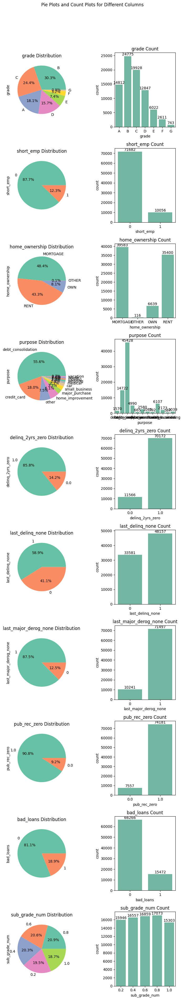

In [ ]:
# Set a common color palette
sns.set_palette('Set2')

columns_to_visualize = category_columns

num_rows = len(columns_to_visualize)
num_cols = 2
fig, axes = plt.subplots(num_rows, num_cols, figsize=(7, 4 * num_rows))
fig.suptitle('Pie Plots and Count Plots for Different Columns')

for i, column in enumerate(columns_to_visualize):
    data[column].value_counts().plot.pie(ax=axes[i, 0], autopct='%1.1f%%')
    axes[i, 0].set_title(f'{column} Distribution')

    sns.countplot(data=data, x=column, ax=axes[i, 1])
    axes[i, 1].set_title(f'{column} Count')

    # Add annotations to count plots
    for p in axes[i, 1].patches:
        height = p.get_height()
        axes[i, 1].annotate(f'{int(height)}', (p.get_x() + p.get_width() / 2., height),
                            ha='center', va='bottom', fontsize=10)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

Crosstabulation: Creates a contingency table using pd.crosstab, counting the co-occurrence of categories in col1 and col2.
Percentage Calculation: Calculates the percentage of each category within each group of col1.
Visualization: Generates a stacked bar chart using matplotlib.pyplot, showcasing the percentages for each category of col2 across different groups of col1.

In [ ]:
def visualize_relationship(data, col1, col2):
  """
  Visualize the relationship between two columns using a stacked bar chart.

  Args:
    data: A pandas DataFrame.
    col1: The first column name.
    col2: The second column name.
  """
  # Create a crosstab table
  table = pd.crosstab(data[col1], data[col2])

  # Calculate percentages
  table_pct = table.apply(lambda x: x / x.sum() * 100, axis=1)

  # Create a bar chart
  plt.figure(figsize=(8, 6))
  table_pct.plot(kind="bar", stacked=False, color=['skyblue', 'lightcoral'])
  plt.xlabel(f"{col1.title()}")
  plt.ylabel("Percentage")
  plt.title(f"Relationship Between {col1.title()} and {col2.title()}")
  plt.xticks(rotation=0)
  plt.legend(title=f"{col2.title()}")
  plt.tight_layout()
  plt.show()


<Figure size 800x600 with 0 Axes>

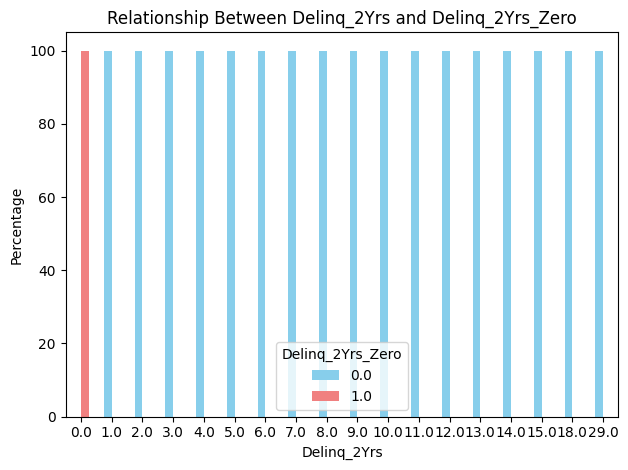

In [ ]:
visualize_relationship(data, 'delinq_2yrs', 'delinq_2yrs_zero')

<Figure size 800x600 with 0 Axes>

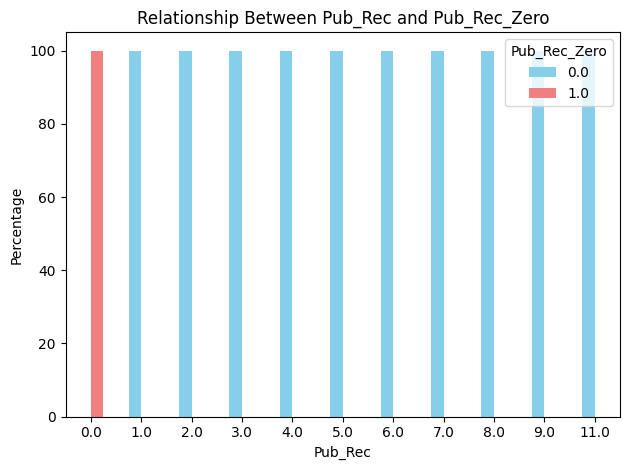

In [ ]:
visualize_relationship(data, 'pub_rec', 'pub_rec_zero')

**correlation of continuous variables**

This code defines a function, plot_correlation_heatmaps, that takes a DataFrame (data) as input and generates a set of heatmaps to visualize correlations between variables using different correlation methods. Three correlation methods are employed: Pearson, Spearman, and Kendall. These methods capture different types of relationships between variables.

In [ ]:
def plot_correlation_heatmaps(data):
    # Define correlation methods
    correlation_methods = ['pearson', 'spearman', 'kendall']

    # Plotting Heatmaps
    plt.figure(figsize=(15, len(correlation_methods) * 5))

    for i, method in enumerate(correlation_methods, 1):
        # Calculate correlation
        corr_matrix = data_num.corr(method=method)

        # Plot the heatmap
        plt.subplot(len(correlation_methods), 1, i)
        sns.heatmap(corr_matrix, annot=True, cmap= 'Blues', fmt=".2f")
        plt.title(f'{method.capitalize()} Correlation')

    plt.tight_layout()
    plt.show()

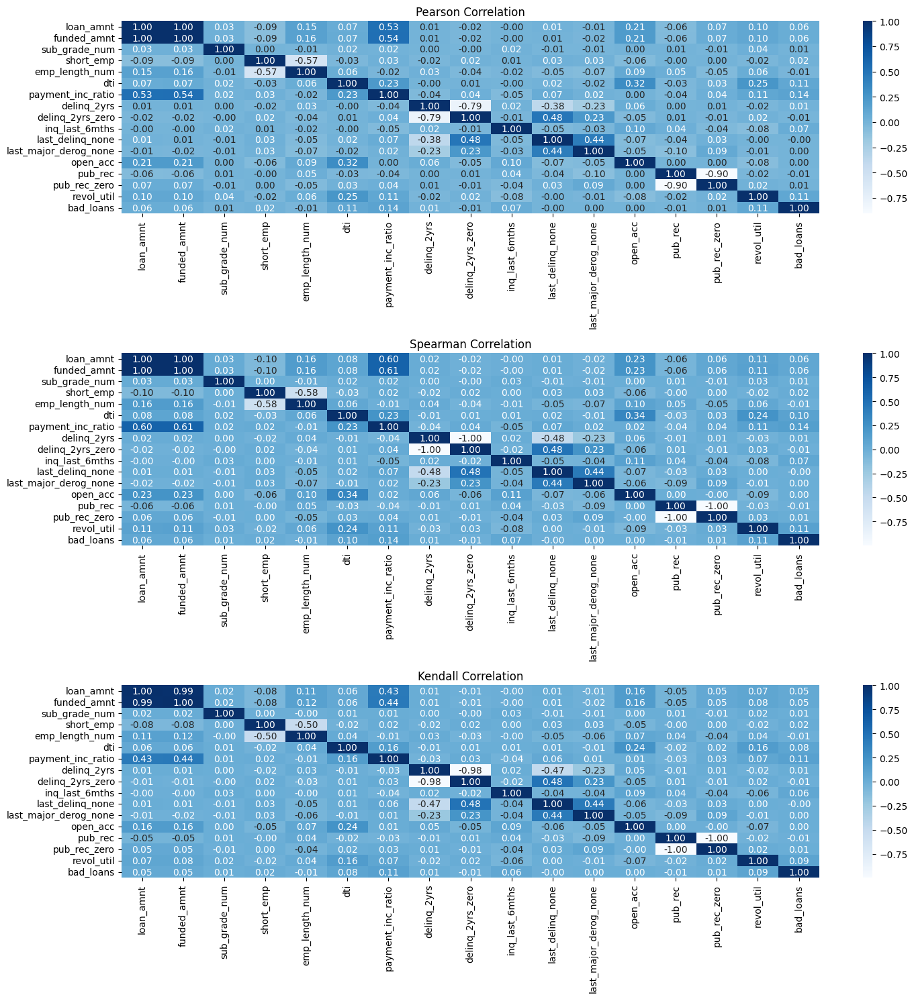

In [ ]:
plot_correlation_heatmaps(data_num)

**Correlation of categorical variables**

This code calculates Cramér's V, a measure of association, for pairs of categorical variables in data set. Cramér's V ranges from 0 to 1, where 0 indicates no association and 1 indicates a strong association. Higher values indicate a stronger relationship between variables.

In [ ]:
data_cat = data.select_dtypes(include = 'category')
data_cat.head()

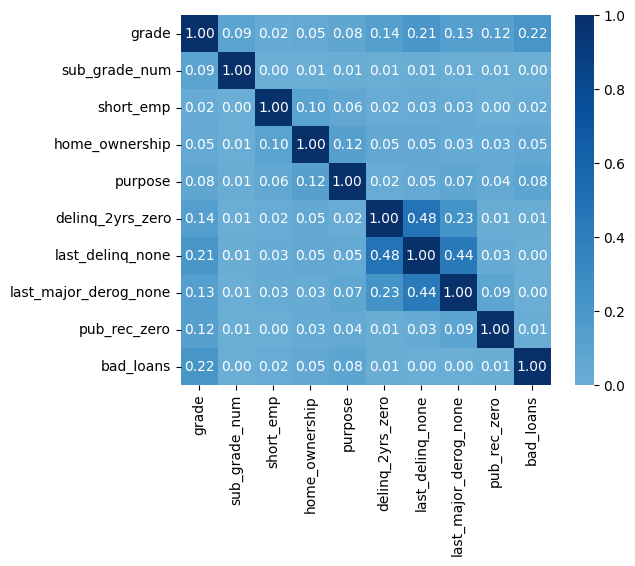

In [ ]:
cramers_v = associations(data_cat,
             nom_nom_assoc = 'cramer',
            cmap = "Blues")

**Visualizing Loan Amount Distribution Across Categories**

This function generates a set of boxplots to visualize the distribution of loan amounts across different categories within a specified data frame.

In [ ]:
def plot_loan_amount_by_category(data, category_column='grade'):
    # Get unique values in the specified category column
    unique_categories = data[category_column].unique()

    # Set up the layout for subplots
    num_rows = 2
    num_cols = (len(unique_categories) + num_rows - 1) // num_rows
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(16, 5* num_rows), sharey=True)
    fig.suptitle('Loan Amount Range for Different Categories', y=1.02)
    axes = axes.flatten()

    # Iterate through unique categories and create boxplots
    for i, category in enumerate(unique_categories):
        # Extract data for the current category
        category_data = data[data[category_column] == category]

        # Create a boxplot for the current category
        sns.boxplot(data=category_data, x=category_column, y='loan_amnt', ax=axes[i])

        # Set title and axis labels for the subplot
        axes[i].set_title(f'{category_column.capitalize()} {category}')

        # Rotate x-axis labels for better readability
        axes[i].tick_params(axis='x', rotation=90)  # You can adjust the rotation angle

        axes[i].set_xlabel(f'{category_column.capitalize()}')
        axes[i].set_ylabel('Loan Amount')

    # Turn off extra subplots if there are fewer unique categories than total subplots
    for j in range(len(unique_categories), len(axes)):
        axes[j].axis('off')

    # Adjust layout and display the plot
    plt.tight_layout()
    plt.show()


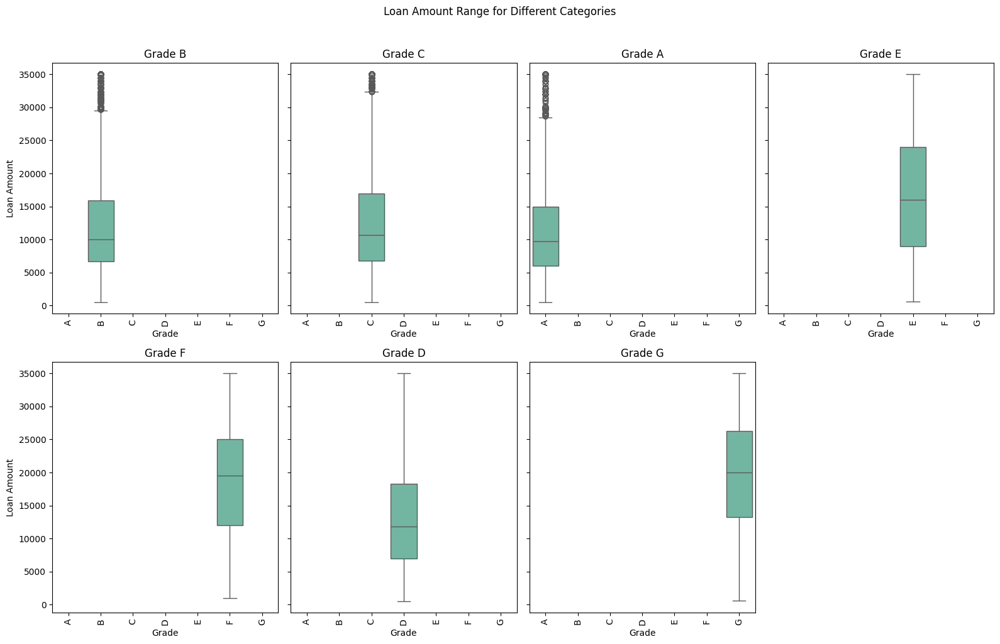

In [ ]:
plot_loan_amount_by_category(data, category_column='grade')

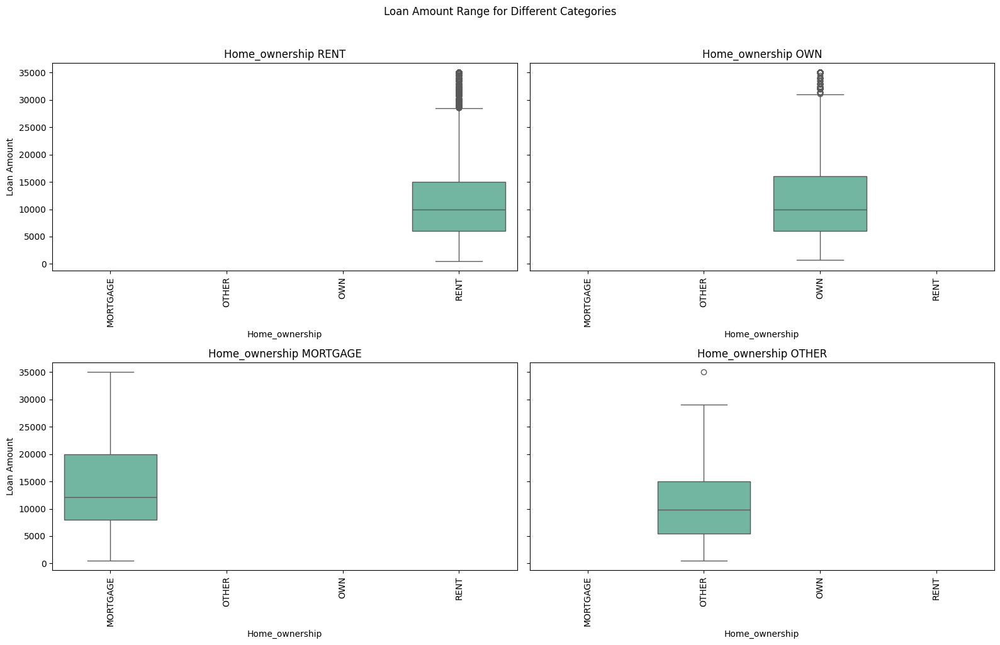

In [ ]:
plot_loan_amount_by_category(data, category_column='home_ownership')

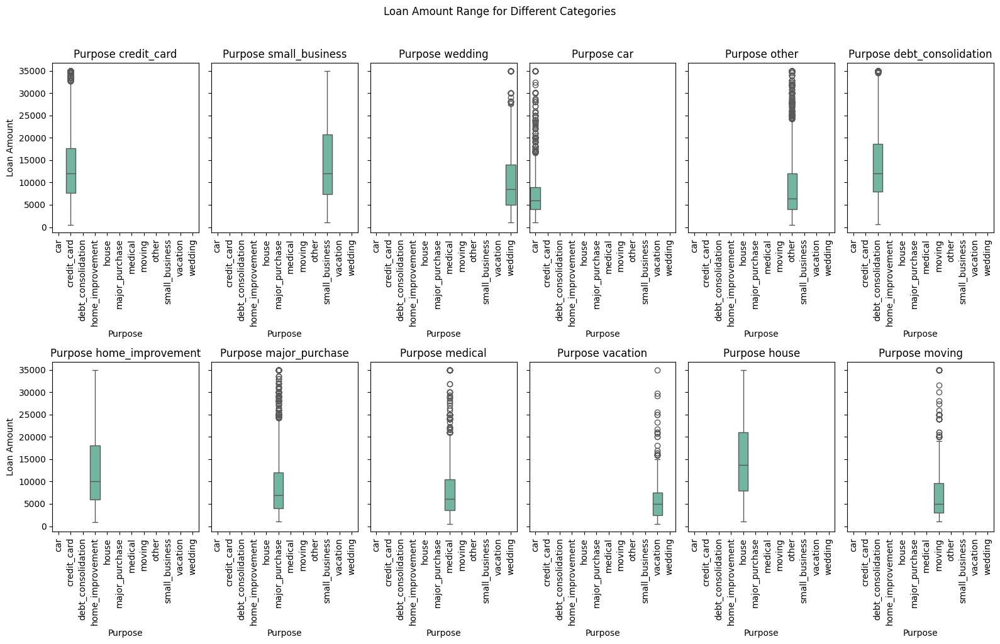

In [ ]:
plot_loan_amount_by_category(data, category_column='purpose')

**Scatterplot:** "Exploring the Relationship between Loan Amount, Payment-to-Income Ratio, and Loan Status"

The scatter plot examines the association between the loan amount (loan_amnt) and the payment-to-income ratio (payment_inc_ratio) for loans categorized by their status (bad_loans). Each point represents an individual loan, and the color indicates whether the loan is classified as 'bad' or 'good.'


In [ ]:
def create_scatter_plot(x, y, hue, data):
    """
    Create a scatter plot using Seaborn.

    Parameters:
    - x: The variable for the x-axis.
    - y: The variable for the y-axis.
    - hue: The variable to differentiate points by color.
    - data: The input DataFrame.

    Returns:
    - None (displays the plot).
    """
    sns.scatterplot(x=x, y=y, hue=hue, data=data)
    plt.title(f'Scatter Plot: {x} vs. {y} (Color by {hue})')
    plt.show()

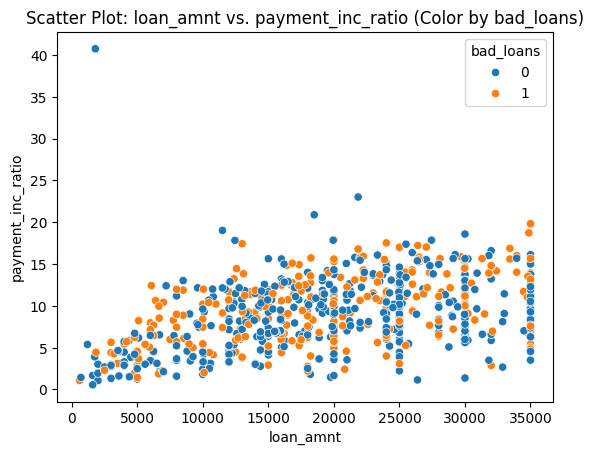

In [ ]:
create_scatter_plot(x="loan_amnt", y="payment_inc_ratio", hue="bad_loans", data= data[data['grade']=='G'])


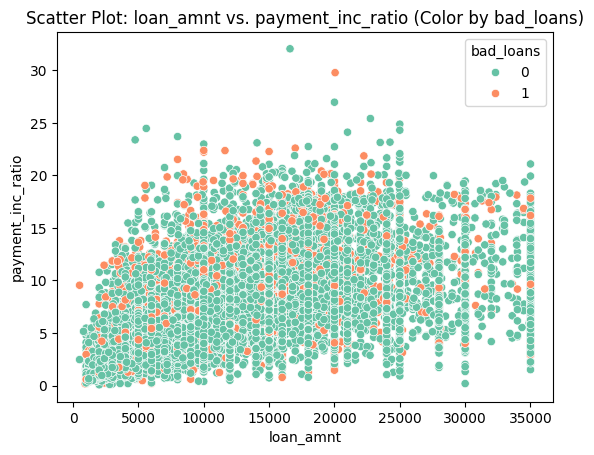

In [ ]:
create_scatter_plot(x="loan_amnt", y="payment_inc_ratio", hue="bad_loans", data= data[data['grade']=='B'])

**Count Analysis with Hue: Visualizing the Distribution of Categorical Data for Grade Column**


The provided function, plot_count_with_hue, generates a count plot with hue (color differentiation) for a categorical variable .The count plot with hue differentiation is designed to explore the distribution of categories within a specified x-axis column and how this distribution varies across different levels of the hue column. Each bar in the plot represents the count of occurrences for a specific category in the x-axis column, and colors represent different levels of the hue column.

In [ ]:
def plot_count_with_hue(data, x_col, hue_col, title):
    plt.figure(figsize=(16, 4))
    ax = sns.countplot(data=data, x=x_col, hue=hue_col, palette='Set2')

    for p in ax.patches:
        height = p.get_height()
        ax.annotate('{}'.format(int(height)),
                    (p.get_x() + p.get_width() / 2, height),
                    ha='center', va='bottom', fontsize=7)

    plt.title(title)
    plt.xlabel(x_col)
    plt.ylabel('Count')
    plt.show()

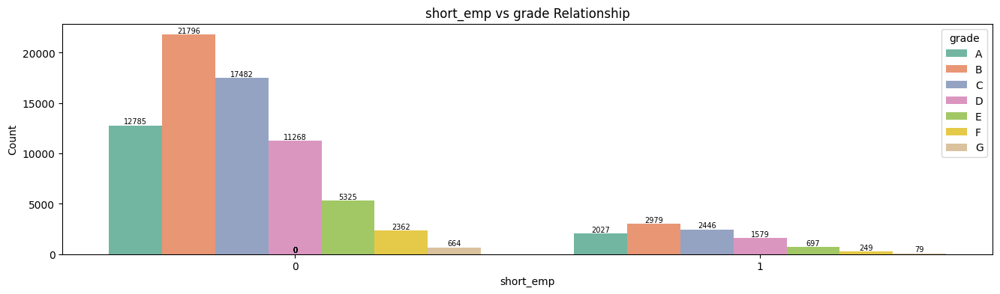

In [ ]:
plot_count_with_hue(data=data, x_col='short_emp', hue_col='grade', title='short_emp vs grade Relationship')

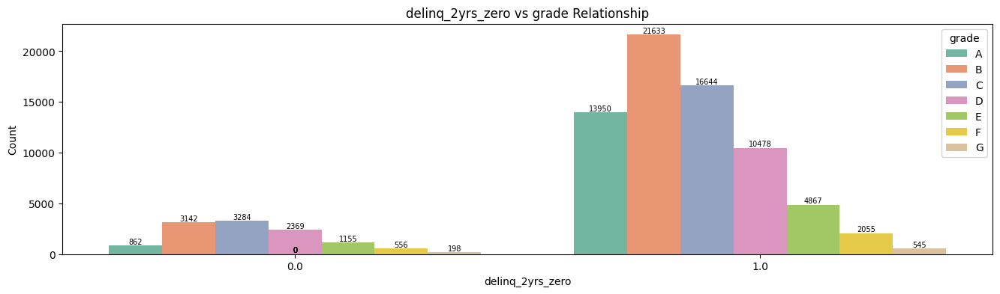

In [ ]:
plot_count_with_hue(data=data, x_col='delinq_2yrs_zero', hue_col='grade', title='delinq_2yrs_zero vs grade Relationship')

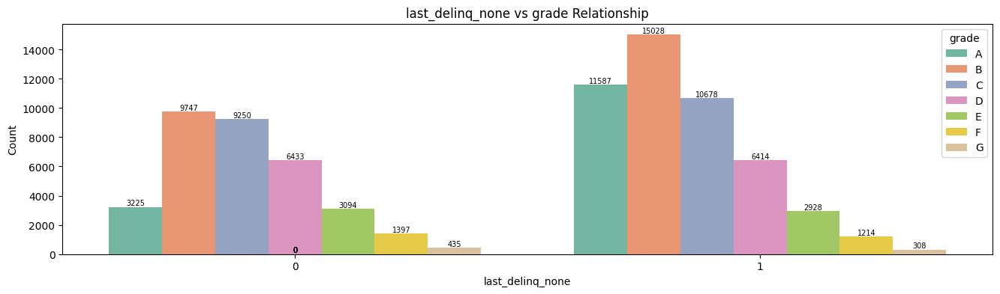

In [ ]:
plot_count_with_hue(data=data, x_col='last_delinq_none', hue_col='grade', title='last_delinq_none vs grade Relationship')

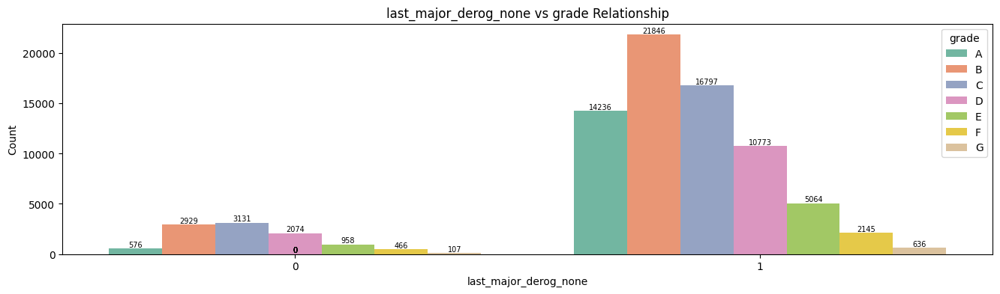

In [ ]:
plot_count_with_hue(data=data, x_col='last_major_derog_none', hue_col='grade', title='last_major_derog_none vs grade Relationship')

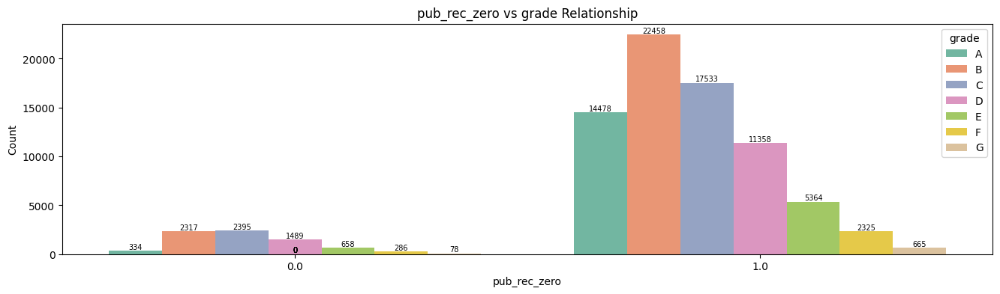

In [ ]:
plot_count_with_hue(data=data, x_col='pub_rec_zero', hue_col='grade', title='pub_rec_zero vs grade Relationship')

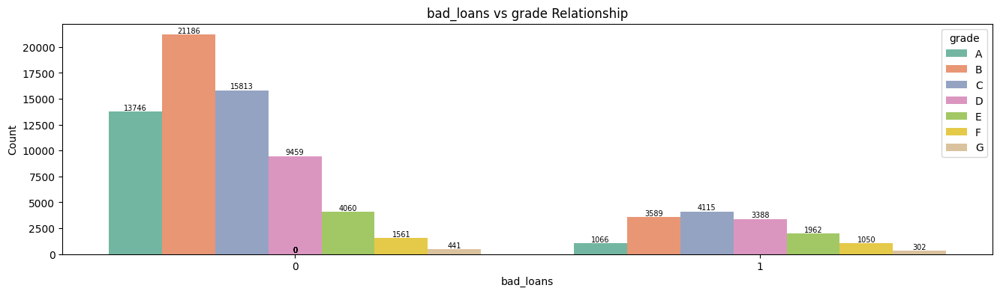

In [ ]:
plot_count_with_hue(data=data, x_col='bad_loans', hue_col='grade', title='bad_loans vs grade Relationship')

**Analyzing Total Loan Amounts by Grade**



The code aggregates the total loan amounts for each loan grade and presents the results in a descending order, providing a comprehensive overview of the distribution of loan amounts across different grades.

**Result:** "The total loan amount in Grade B is the highest, indicating that this group has the highest number of individuals."

In [ ]:
# Calculate and print the total loan amounts by grade
loan_sum = data.groupby('grade')['loan_amnt'].sum().reset_index()
loan_sum_sorted = loan_sum.sort_values(by='loan_amnt', ascending=False)
# loan_sum_sorted['loan_amnt'] = loan_sum_sorted['loan_amnt'].apply('{:,.0f}'.format)
print(loan_sum_sorted)


  grade  loan_amnt
1     B  296048475
2     C  252180425
3     D  171754400
0     A  160589325
4     E  102162200
5     F   49533725
6     G   14835050


In [ ]:
def plot_custom_bar(data, x_col, y_col, palette="Set1", figsize=(8, 6), title=None, x_label=None, y_label=None, x_label_rotation=0):

    plt.figure(figsize=figsize)
    custom_palette = sns.color_palette(palette)

    # Use sns.barplot directly and pass the palette argument
    ax = sns.barplot(data=data, x=x_col, y=y_col, palette=custom_palette)

    plt.title(title or f'{y_col} by {x_col}')
    plt.xlabel(x_label or x_col.capitalize())
    plt.ylabel(y_label or y_col.capitalize())

    # Rotate x-axis labels
    ax.set_xticklabels(ax.get_xticklabels(), rotation=x_label_rotation, ha='right')

    # Annotate each bar with its value
    for p in ax.patches:
        height = p.get_height()
        ax.annotate('{}'.format(height),
                    (p.get_x() + p.get_width() / 2, height),
                    ha='center', va='bottom', fontsize=8)

    # Automatically adjust layout for better spacing
    plt.tight_layout()

    plt.show()


# plt.figure(figsize=(10, 6))
# sns.barplot(data=data, x='grade', y='loan_amnt', estimator=sum)
# plt.title('Sum of Loan Amounts by Grade')
# plt.xlabel('Loan Grade')
# plt.ylabel('Sum of Loan Amounts')
# plt.show()

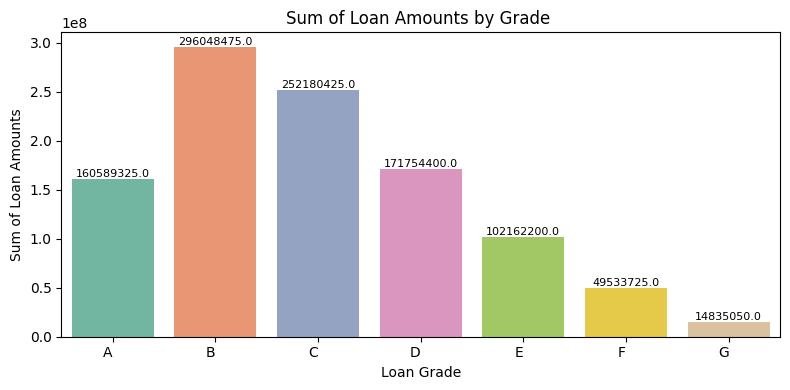

In [ ]:
plot_custom_bar(data=loan_sum_sorted, x_col='grade', y_col='loan_amnt', palette="Set2",
                figsize=(8, 4), title='Sum of Loan Amounts by Grade ',
                x_label='Loan Grade', y_label='Sum of Loan Amounts')

**Analyzing Average Loan Amounts by Grade**

The provided code calculates the average loan amount for each loan grade.

**Result:**"The highest average loan amount is found in Grade G, indicating that individuals in this group have the largest loan amounts."

In [ ]:
loan_ave = data.groupby('grade')['loan_amnt'].mean().reset_index()
loan_ave_sorted = loan_ave.sort_values(by='loan_amnt', ascending=False).round(3)
print(loan_ave_sorted)

  grade  loan_amnt
6     G  19966.420
5     F  18971.170
4     E  16964.829
3     D  13369.222
2     C  12654.578
1     B  11949.484
0     A  10841.839


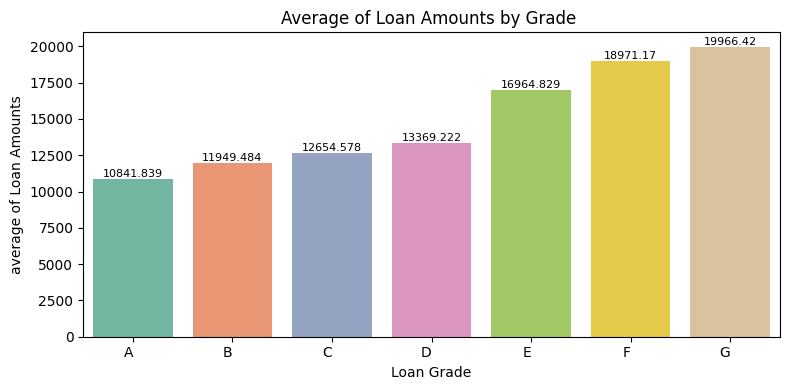

In [ ]:
plot_custom_bar(data=loan_ave_sorted, x_col='grade', y_col='loan_amnt', palette="Set2",
                figsize=(8, 4), title='Average of Loan Amounts by Grade ',
                x_label='Loan Grade', y_label='average of Loan Amounts')

**Distribution of Average Numerical Features Across Loan Grades**

The code aims to provide a concise overview of loan grade dynamics by representing the distribution of average numerical features using pie charts.

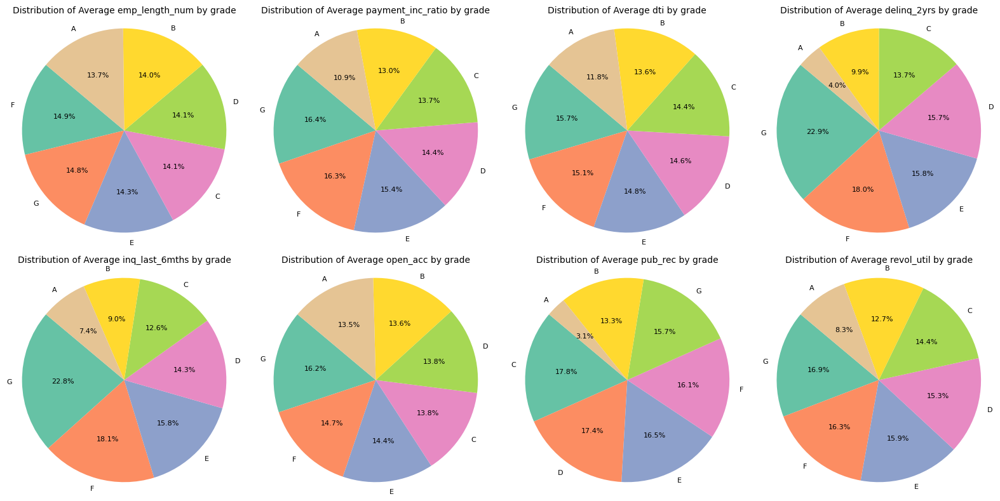

In [ ]:
def generate_custom_pie_chart(data, column1, column2, custom_colors=None, text_size=8, ax=None):
    # Calculate mean by column1 for the specified column2
    data_by_column = data.groupby(column1)[column2].mean().reset_index()
    data_by_column = data_by_column.sort_values(by=column2, ascending=False)

    labels = data_by_column[column1]
    values = data_by_column[column2]

    # Use custom colors if provided, otherwise use default colors
    if custom_colors:
        ax.pie(values, labels=labels, autopct='%1.1f%%', startangle=140, colors=custom_colors, textprops={'fontsize': text_size})
    else:
        ax.pie(values, labels=labels, autopct='%1.1f%%', startangle=140, textprops={'fontsize': text_size})

    ax.set_title(f'Distribution of Average {column2} by {column1}', fontsize=10)
    ax.axis('equal')



fig, axes = plt.subplots(2, 4, figsize=(16, 8))
common_column1 = 'grade'
column2_values = ['emp_length_num','payment_inc_ratio','dti', 'delinq_2yrs', 'inq_last_6mths', 'open_acc', 'pub_rec','revol_util']
for i, ax in enumerate(axes.flatten()):
    if i < len(column2_values):
        generate_custom_pie_chart(data, column1=common_column1, column2=column2_values[i], custom_colors=sns.color_palette('Set2'), text_size=8, ax=ax)
plt.tight_layout()
plt.show()


**Count Analysis with Hue: Visualizing the Distribution of Categorical Data for Home_ownership Column**

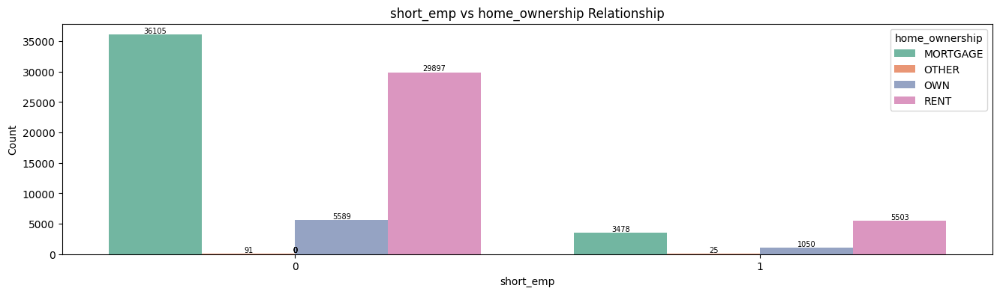

In [ ]:
plot_count_with_hue(data=data, x_col='short_emp', hue_col='home_ownership', title='short_emp vs home_ownership Relationship')

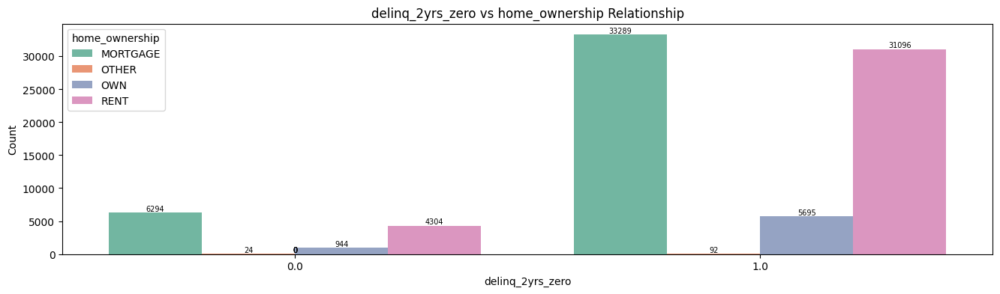

In [ ]:
plot_count_with_hue(data=data, x_col='delinq_2yrs_zero', hue_col='home_ownership', title='delinq_2yrs_zero vs home_ownership Relationship')

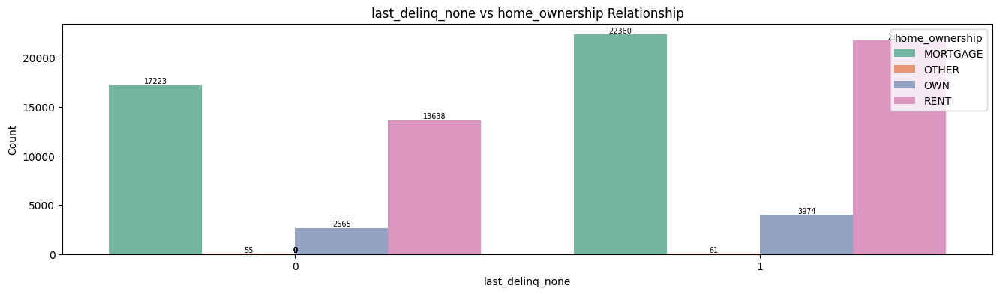

In [ ]:
plot_count_with_hue(data=data, x_col='last_delinq_none', hue_col='home_ownership', title='last_delinq_none vs home_ownership Relationship')

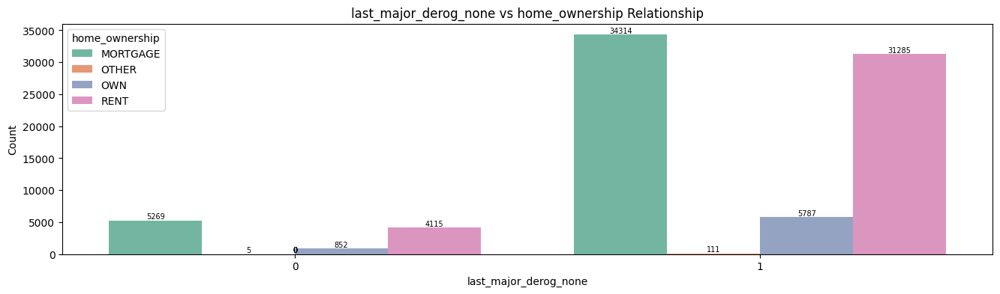

In [ ]:
plot_count_with_hue(data=data, x_col='last_major_derog_none', hue_col='home_ownership',
                    title='last_major_derog_none vs home_ownership Relationship')

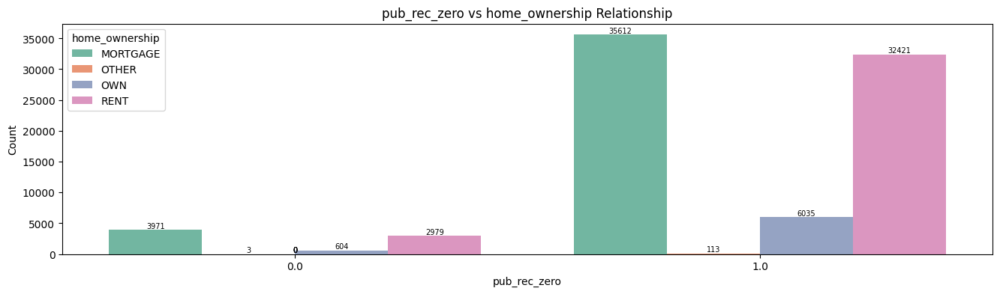

In [ ]:
plot_count_with_hue(data=data, x_col='pub_rec_zero', hue_col='home_ownership', title='pub_rec_zero vs home_ownership Relationship')

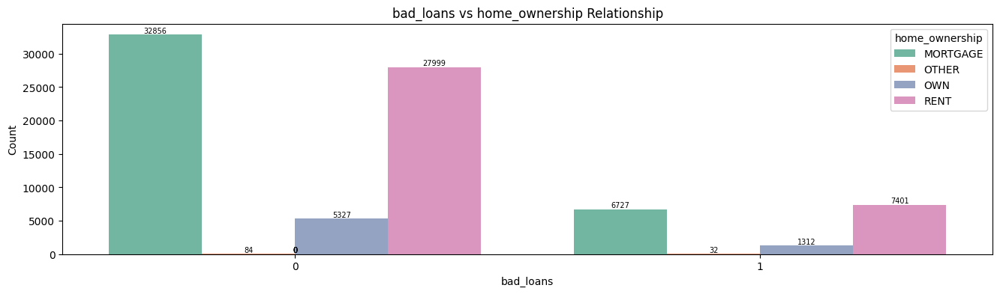

In [ ]:
plot_count_with_hue(data=data, x_col='bad_loans', hue_col='home_ownership', title='bad_loans vs home_ownership Relationship')

**Analyzing Total Loan Amounts by Homeownership**



In [ ]:
loan_sum_home = data.groupby('home_ownership')['loan_amnt'].sum().reset_index()
loan_sum_home_sorted = loan_sum_home.sort_values(by='loan_amnt', ascending=False)
print(loan_sum_home_sorted)

  home_ownership  loan_amnt
0       MORTGAGE  566085375
3           RENT  399034350
2            OWN   80738775
1          OTHER    1245100


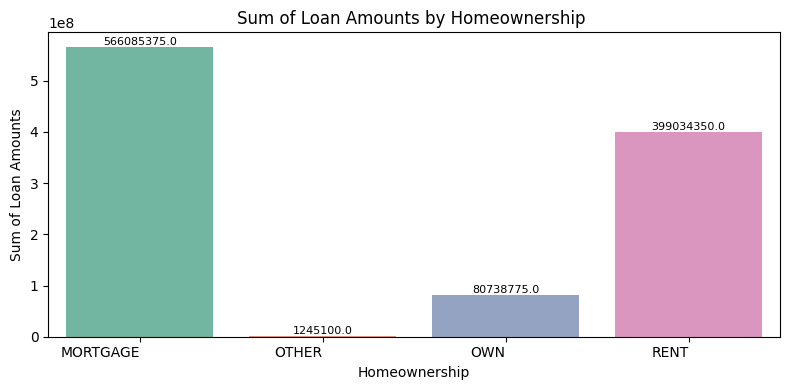

In [ ]:
plot_custom_bar(data=loan_sum_home, x_col='home_ownership', y_col='loan_amnt', palette="Set2",
                figsize=(8, 4), title='Sum of Loan Amounts by Homeownership ',
                x_label='Homeownership', y_label='Sum of Loan Amounts')

**Analyzing Average Loan Amounts by Home_ownership**

In [ ]:
loan_ave_home = data.groupby('home_ownership')['loan_amnt'].mean().reset_index()
loan_ave_home_sorted = loan_ave_home.sort_values(by='loan_amnt', ascending=False).round(3)
# loan_ave_home_sorted['loan_amnt'] = loan_ave_home_sorted['loan_amnt'].round(3)
print(loan_ave_home_sorted)

  home_ownership  loan_amnt
0       MORTGAGE  14301.225
2            OWN  12161.286
3           RENT  11272.157
1          OTHER  10733.621


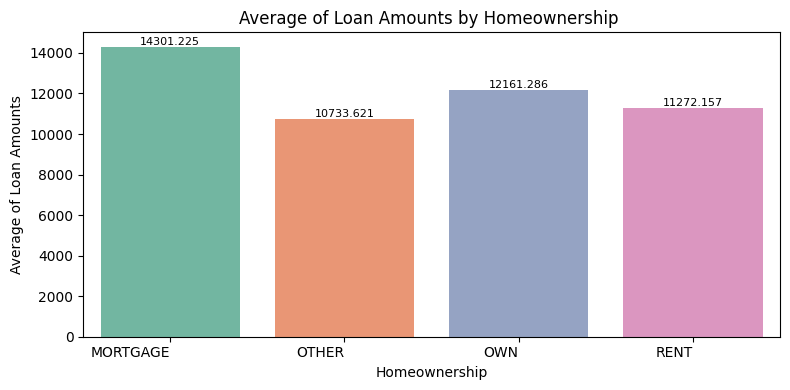

In [ ]:
plot_custom_bar(data=loan_ave_home_sorted, x_col='home_ownership', y_col='loan_amnt', palette="Set2",
                figsize=(8, 4), title='Average of Loan Amounts by Homeownership ',
                x_label='Homeownership', y_label='Average of Loan Amounts')

**Distribution of Average Numerical Features by Homeownership**

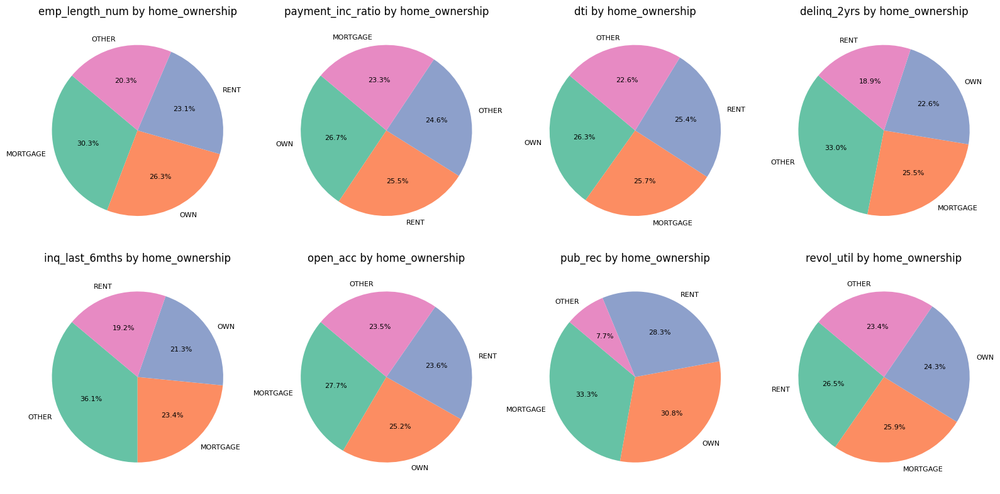

In [ ]:
fig, axes = plt.subplots(2, 4, figsize=(16, 8))

# Specify the common value for column1 (home_ownership)
common_column1 = 'home_ownership'

# Specify the values for column2 in each subplot
column2_values = ['emp_length_num','payment_inc_ratio','dti', 'delinq_2yrs', 'inq_last_6mths', 'open_acc', 'pub_rec','revol_util']

# Iterate through subplots and generate pie charts
for i, ax in enumerate(axes.flatten()):
    if i < len(column2_values):
        plt.sca(ax)
        generate_custom_pie_chart(data, column1=common_column1, column2=column2_values[i], custom_colors=sns.color_palette('Set2'), text_size=8, ax=ax)
        plt.title(f'{column2_values[i]} by {common_column1}')

# Adjust layout
plt.tight_layout()
plt.show()

**Count Analysis with Hue: Visualizing the Distribution of Categorical Data for purpose Column**

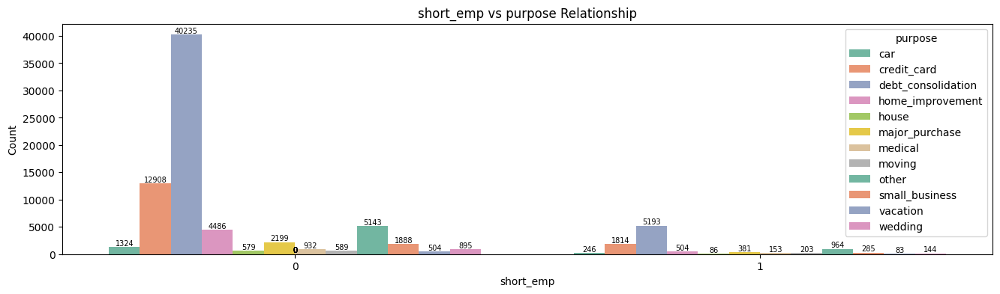

In [ ]:
plot_count_with_hue(data=data, x_col='short_emp', hue_col='purpose', title='short_emp vs purpose Relationship')

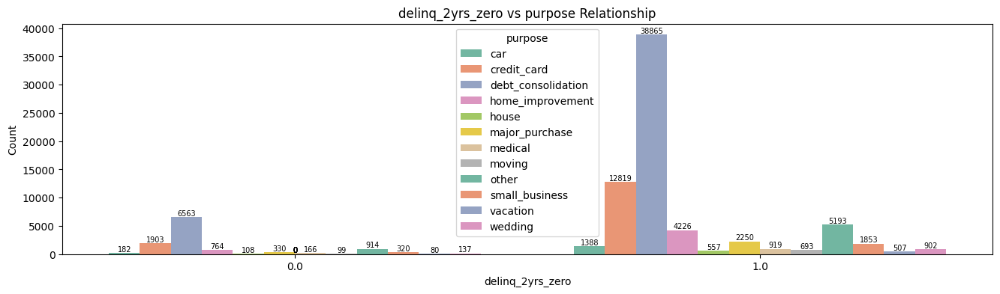

In [ ]:
plot_count_with_hue(data=data, x_col='delinq_2yrs_zero', hue_col='purpose', title='delinq_2yrs_zero vs purpose Relationship')

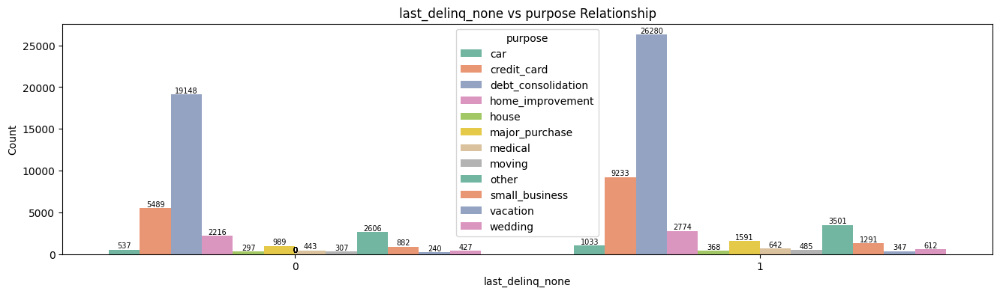

In [ ]:
plot_count_with_hue(data=data, x_col='last_delinq_none', hue_col='purpose', title='last_delinq_none vs purpose Relationship')

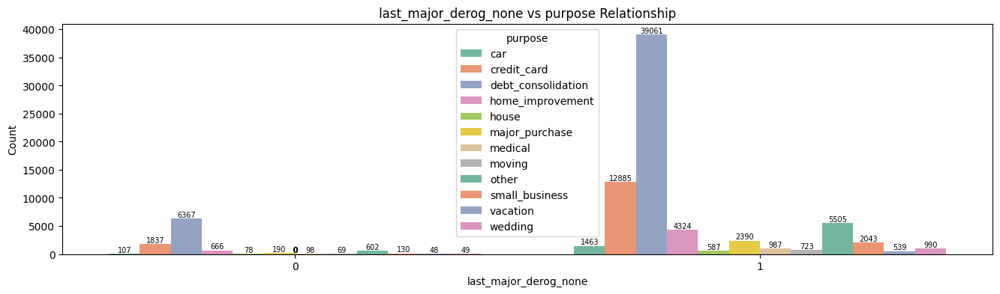

In [ ]:
plot_count_with_hue(data=data, x_col='last_major_derog_none', hue_col='purpose', title='last_major_derog_none vs purpose Relationship')

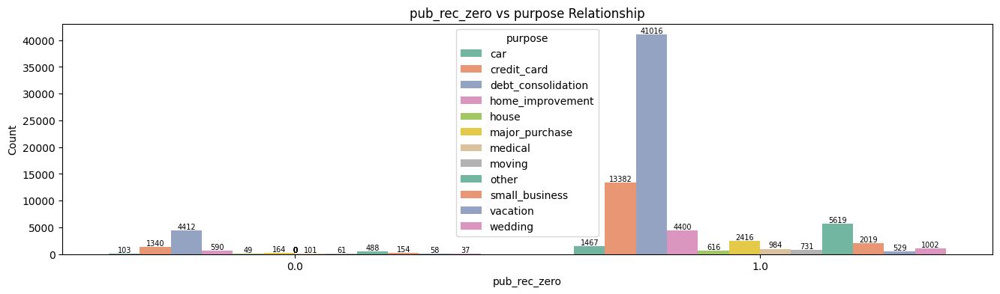

In [ ]:
plot_count_with_hue(data=data, x_col='pub_rec_zero', hue_col='purpose', title='pub_rec_zero vs purpose Relationship')

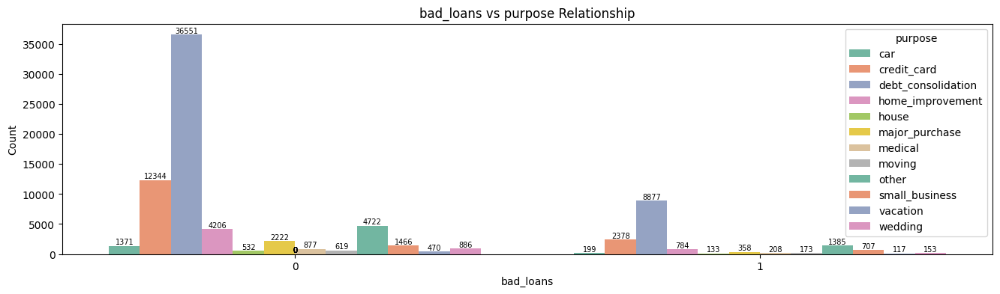

In [ ]:
plot_count_with_hue(data=data, x_col='bad_loans', hue_col='purpose', title='bad_loans vs purpose Relationship')

**Analyzing Total Loan Amounts by Purpose**

In [ ]:
loan_sum_purpose = data.groupby('purpose')['loan_amnt'].sum().reset_index()
loan_sum_purpose = loan_sum_purpose.sort_values(by='loan_amnt', ascending=False)
print(loan_sum_purpose)

               purpose  loan_amnt
2   debt_consolidation  629330250
1          credit_card  193908025
3     home_improvement   63561275
8                other   53561325
9       small_business   32033550
5       major_purchase   24103275
0                  car   11701775
11             wedding   10690200
4                house   10082575
6              medical    9193150
7               moving    5591775
10            vacation    3346425


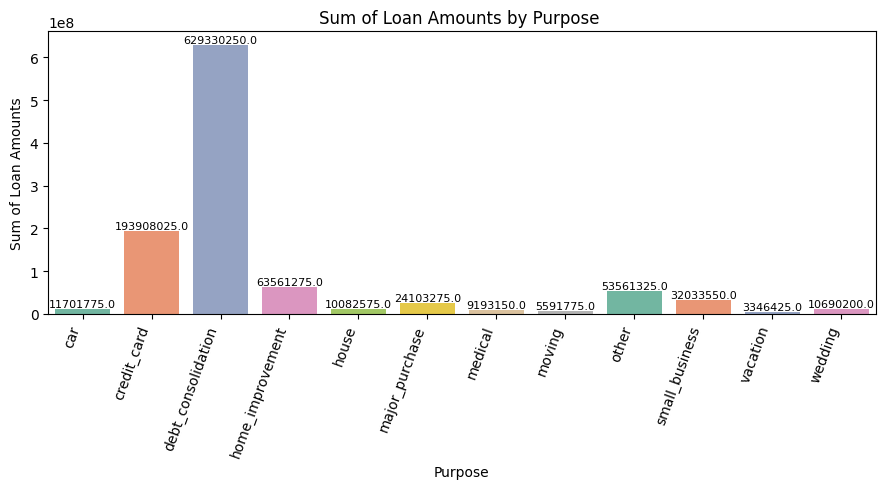

In [ ]:
plot_custom_bar(data=loan_sum_purpose, x_col='purpose', y_col='loan_amnt', palette="Set2",
                figsize=(9, 5), title='Sum of Loan Amounts by Purpose ',
                x_label='Purpose', y_label='Sum of Loan Amounts',x_label_rotation=70)

**Analyzing Average Loan Amounts by Purpose**

In [ ]:
loan_ave_purpose = data.groupby('purpose')['loan_amnt'].mean().reset_index()
loan_ave_purpose = loan_ave_purpose.sort_values(by='loan_amnt', ascending=False).round(3)
print(loan_ave_purpose)

               purpose  loan_amnt
4                house  15161.767
9       small_business  14741.624
2   debt_consolidation  13853.356
1          credit_card  13171.310
3     home_improvement  12737.730
11             wedding  10288.932
5       major_purchase   9342.355
8                other   8770.481
6              medical   8472.949
0                  car   7453.360
7               moving   7060.322
10            vacation   5700.894


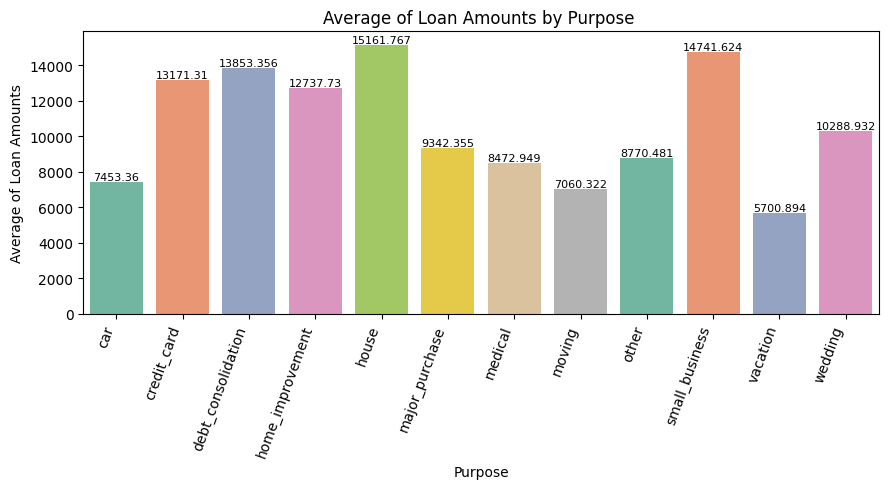

In [ ]:
plot_custom_bar(data=loan_ave_purpose, x_col='purpose', y_col='loan_amnt', palette="Set2",
                figsize=(9, 5), title='Average of Loan Amounts by Purpose ',
                x_label='Purpose', y_label='Average of Loan Amounts',x_label_rotation=70)

**Distribution of Average Numerical Features by Purpose**

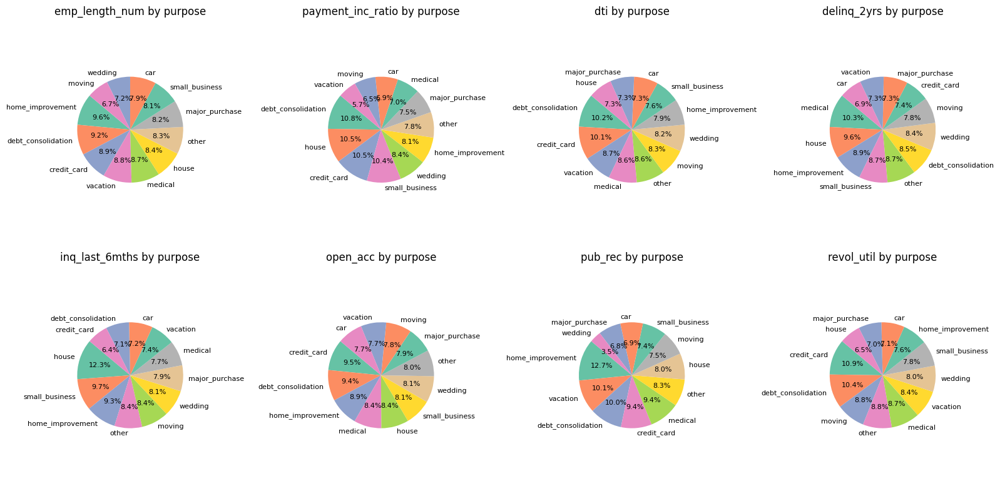

In [ ]:
fig, axes = plt.subplots(2, 4, figsize=(16, 8))

# Specify the common value for column1 (home_ownership)
common_column1 = 'purpose'

# Specify the values for column2 in each subplot
column2_values = ['emp_length_num','payment_inc_ratio','dti', 'delinq_2yrs', 'inq_last_6mths', 'open_acc', 'pub_rec','revol_util']

# Iterate through subplots and generate pie charts
for i, ax in enumerate(axes.flatten()):
    if i < len(column2_values):
        plt.sca(ax)
        generate_custom_pie_chart(data, column1=common_column1, column2=column2_values[i], custom_colors=sns.color_palette('Set2'), text_size=8, ax=ax)
        plt.title(f'{column2_values[i]} by {common_column1}')

# Adjust layout
plt.tight_layout()
plt.show()

**Count Analysis with Hue: Visualizing the Distribution of Categorical Data for sub_grade_num Column**

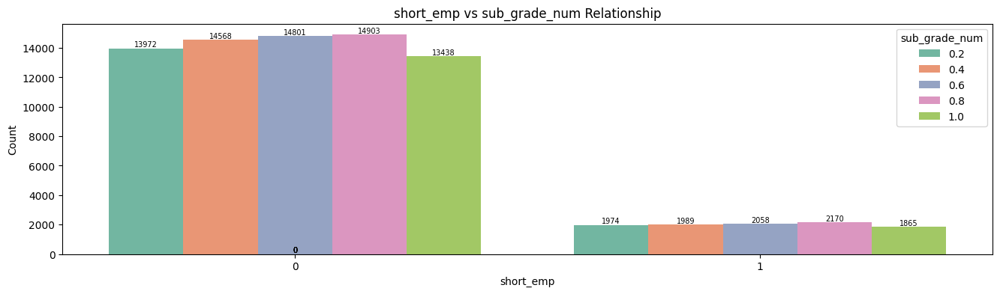

In [ ]:
plot_count_with_hue(data=data, x_col='short_emp', hue_col='sub_grade_num', title='short_emp vs sub_grade_num Relationship')

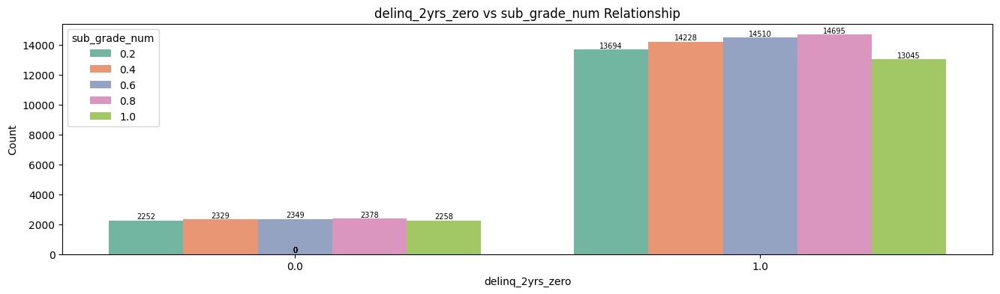

In [ ]:
plot_count_with_hue(data=data, x_col='delinq_2yrs_zero', hue_col='sub_grade_num', title='delinq_2yrs_zero vs sub_grade_num Relationship')

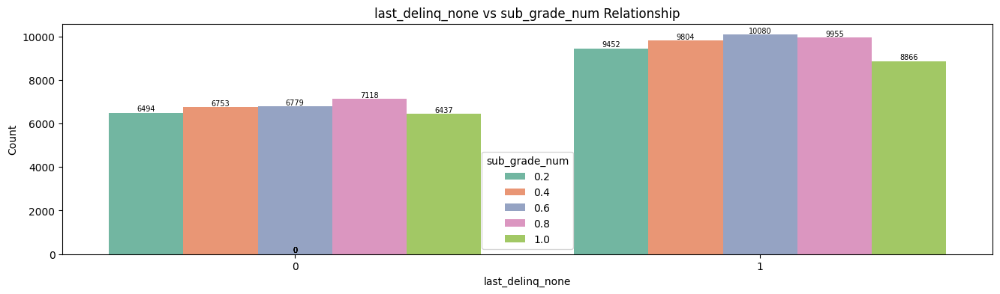

In [ ]:
plot_count_with_hue(data=data, x_col='last_delinq_none', hue_col='sub_grade_num', title='last_delinq_none vs sub_grade_num Relationship')

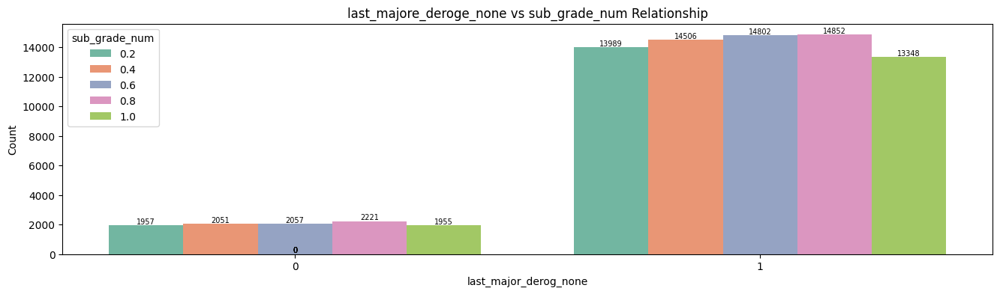

In [ ]:
plot_count_with_hue(data=data, x_col='last_major_derog_none', hue_col='sub_grade_num', title='last_majore_deroge_none vs sub_grade_num Relationship')

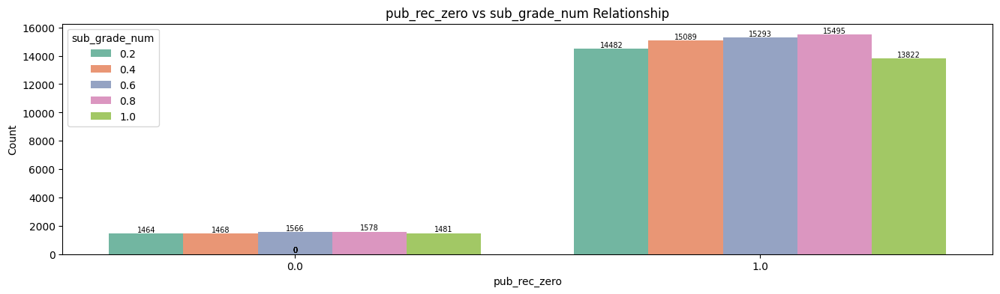

In [ ]:
plot_count_with_hue(data=data, x_col='pub_rec_zero', hue_col='sub_grade_num', title='pub_rec_zero vs sub_grade_num Relationship')

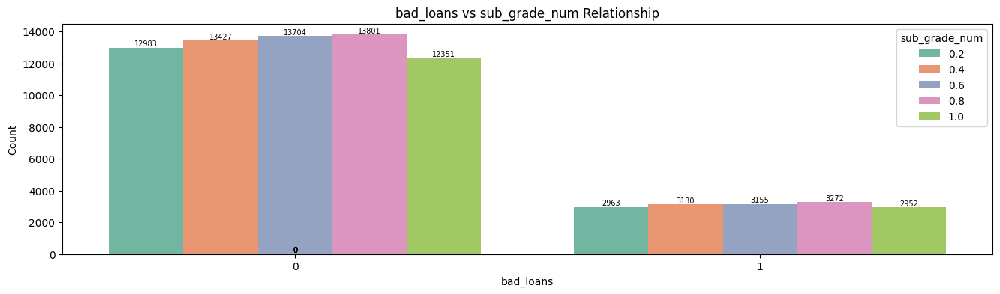

In [ ]:
plot_count_with_hue(data=data, x_col='bad_loans', hue_col='sub_grade_num', title='bad_loans vs sub_grade_num Relationship')

**Analyzing Total Loan Amounts by Sub_grade_num**

In [ ]:
loan_sum_sub_grade = data.groupby('sub_grade_num')['loan_amnt'].sum().reset_index()
loan_sum_sub_grade = loan_sum_sub_grade.sort_values(by='loan_amnt', ascending=False)
print(loan_sum_sub_grade)

  sub_grade_num  loan_amnt
3           0.8  222440475
2           0.6  214878475
1           0.4  208779025
4           1.0  201444850
0           0.2  199560775


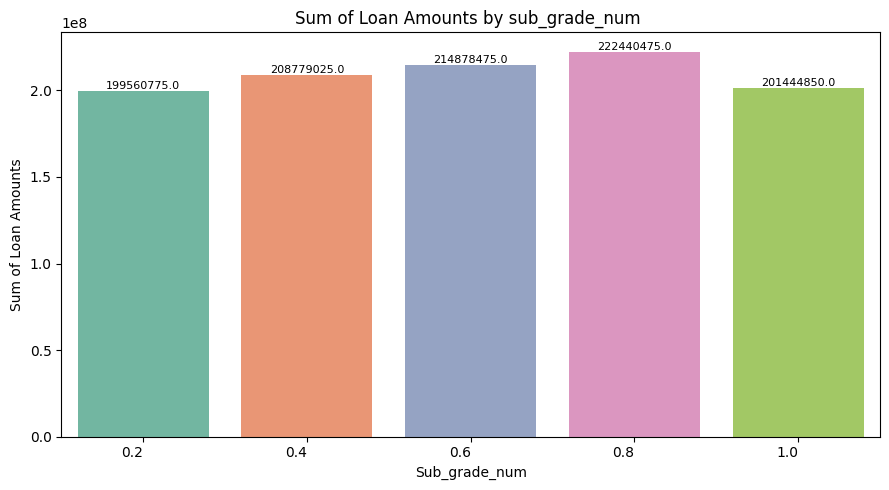

In [ ]:
plot_custom_bar(data=loan_sum_sub_grade, x_col='sub_grade_num', y_col='loan_amnt', palette="Set2",
                figsize=(9, 5), title='Sum of Loan Amounts by sub_grade_num ',
                x_label='Sub_grade_num', y_label='Sum of Loan Amounts',x_label_rotation=0)

**Analyzing Average Loan Amounts by Sub_grade_num**

In [ ]:
loan_ave_sub_grade = data.groupby('sub_grade_num')['loan_amnt'].mean().reset_index()
loan_ave_sub_grade = loan_ave_sub_grade.sort_values(by='loan_amnt', ascending=False).round(3)
print(loan_ave_sub_grade)

  sub_grade_num  loan_amnt
4           1.0  13163.749
3           0.8  13028.787
2           0.6  12745.624
1           0.4  12609.713
0           0.2  12514.786


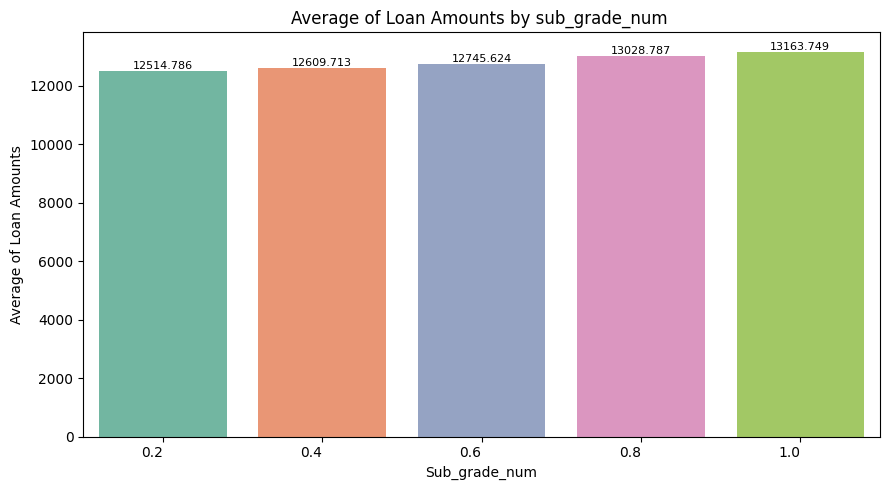

In [ ]:
plot_custom_bar(data=loan_ave_sub_grade, x_col='sub_grade_num', y_col='loan_amnt', palette="Set2",
                figsize=(9, 5), title='Average of Loan Amounts by sub_grade_num ',
                x_label='Sub_grade_num', y_label='Average of Loan Amounts',x_label_rotation=0)

**Distribution of Average Numerical Features by Sub_grade_num**

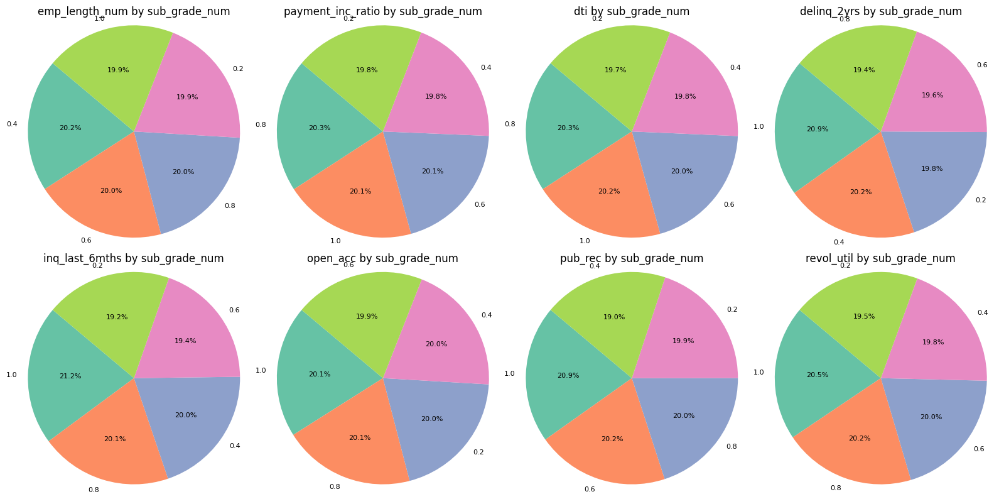

In [ ]:
fig, axes = plt.subplots(2, 4, figsize=(16, 8))

# Specify the common value for column1 (home_ownership)
common_column1 = 'sub_grade_num'

# Specify the values for column2 in each subplot
column2_values = ['emp_length_num','payment_inc_ratio','dti', 'delinq_2yrs', 'inq_last_6mths', 'open_acc', 'pub_rec','revol_util']

# Iterate through subplots and generate pie charts
for i, ax in enumerate(axes.flatten()):
    if i < len(column2_values):
        plt.sca(ax)
        generate_custom_pie_chart(data, column1=common_column1, column2=column2_values[i], custom_colors=sns.color_palette('Set2'), text_size=8, ax=ax)
        plt.title(f'{column2_values[i]} by {common_column1}')

# Adjust layout
plt.tight_layout()
plt.show()

"Upon examining the 'sub-grade_num' column in this section and reviewing the correlation table of the categorical variables drawn above, we observe that there is no significant difference in any of the values within this column. Therefore, it is suggested that this column be deleted."

In [ ]:
# Assuming 'data' is the DataFrame
data = data.drop('sub_grade_num', axis=1)
# data.head(3)


**Heatmap Analysis of Loan Amount Differences Across Grade, Purpose, and Homeownership**

In this section, we calculate the difference between pairs of categorical columns (Grade, Purpose, and Homeownership) based on the 'loan amount' column. Using the function defined below, we determine the count of occurrences for each unique combination and display the results in a heatmap chart. The heatmap highlights each table's lowest and highest values with distinct colors.

**The total loan amount in each grade based on the purpose**

In [ ]:
def plot_heatmap_with_min_max(data, index, columns, values, aggfunc,cmap='YlGnBu'):
    pivot_table = data.pivot_table(index=index, columns=columns, values=values, aggfunc=aggfunc)
    min_value = pivot_table.min().min()
    max_value = pivot_table.max().max()

    plt.figure(figsize=(10, 8))
    #cmap = sns.light_palette("green", as_cmap=True)
    sns.heatmap(pivot_table, cmap='YlGnBu', annot=True, fmt='.2f', linewidths=.5, cbar=False)

    for i in range(len(pivot_table)):
        for j in range(len(pivot_table.columns)):
            value = pivot_table.iloc[i, j]
            if value == min_value:
                plt.text(j + 0.5, i + 0.5, f'{value:.2f}', color='red',
                         ha='center', va='center', fontsize=10, fontweight='bold')
            elif value == max_value:
                plt.text(j + 0.5, i + 0.5, f'{value:.2f}', color='red',
                         ha='center', va='center', fontsize=10, fontweight='bold')

    plt.title(f'{aggfunc} by {index} and {columns}')
    plt.xlabel(columns)
    plt.ylabel(index)
    plt.xticks(rotation=45)
    plt.show()

In [ ]:
total_loan1 = data.groupby(['purpose','grade'])['loan_amnt'].sum().unstack('purpose')
total_loan1
# total_loan_amounts = data.groupby(['grade', 'purpose'])['loan_amnt'].sum().reset_index()
# total_sorted = total_loan_amounts.sort_values(by='loan_amnt', ascending=False)

purpose,car,credit_card,debt_consolidation,home_improvement,house,major_purchase,medical,moving,other,small_business,vacation,wedding
grade,,,,,,,,,,,,
A,3942150,33992625,82001275,13930300,1824575,6831775,1909425,969650,8053450,4309900,721200,2103000
B,3487350,63793150,175498950,18253800,2511525,6777075,1995875,1388625,12144700,6435675,874050,2887700
C,1989150,49949250,157667300,13833000,2071650,4585900,1624300,918750,10814000,5758075,768575,2200475
D,1288775,26244550,108539200,8375850,1426975,3179925,1789150,1044500,10851475,6497550,645075,1871375
E,616400,12417550,66340300,5957600,1037750,1612275,1180450,799450,6275875,4616775,266550,1041225
F,351800,5872975,31157875,2134575,773375,909025,459700,337525,4119875,2940825,52275,423900
G,26150,1637925,8125350,1076150,436725,207300,234250,133275,1301950,1474750,18700,162525


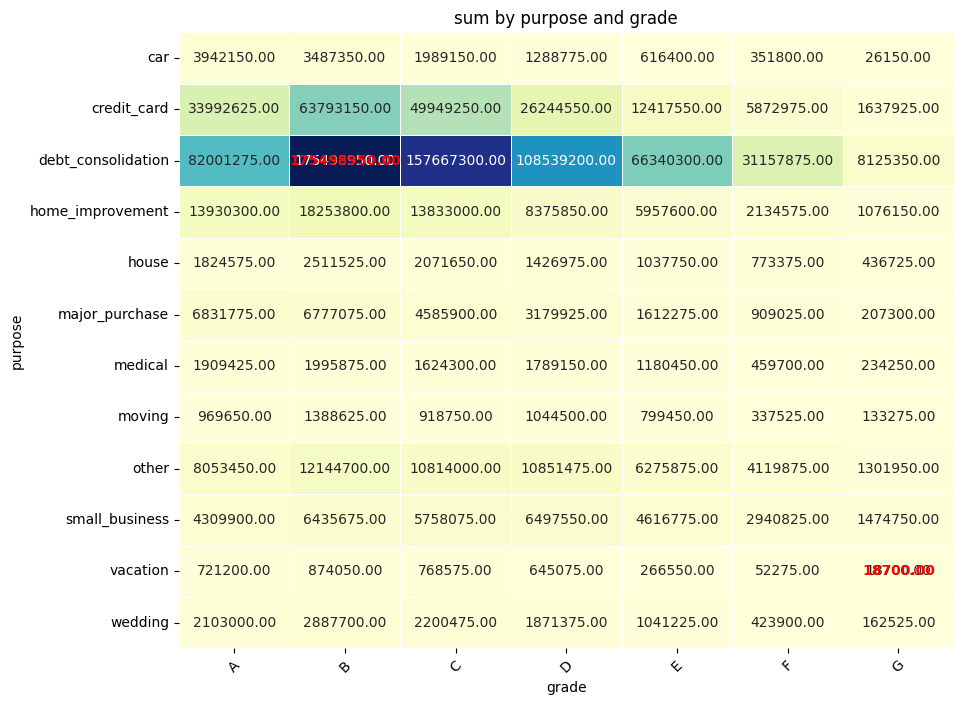

In [ ]:
plot_heatmap_with_min_max(data, index='purpose', columns='grade', values='loan_amnt',aggfunc='sum')

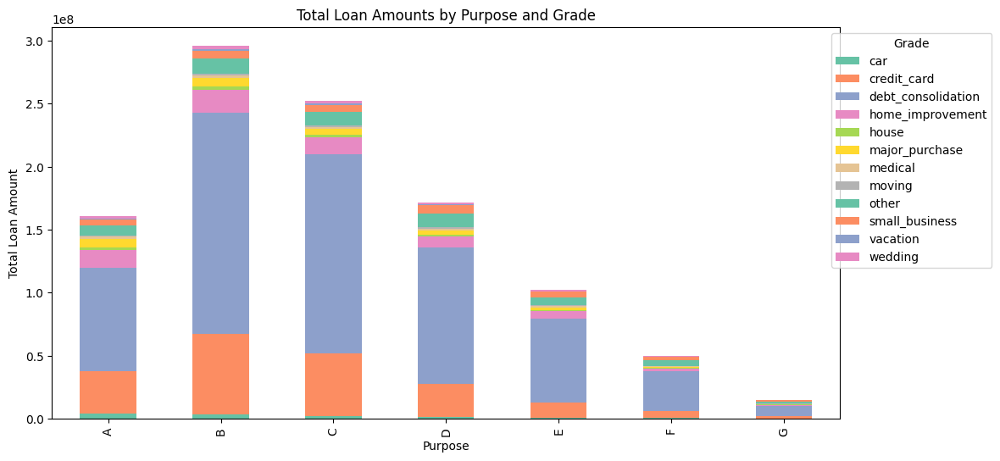

In [ ]:
ax = total_loan1.plot(kind='bar', stacked=True, figsize=(12, 6),color=sns.color_palette("Set2"))

plt.title('Total Loan Amounts by Purpose and Grade')
plt.xlabel('Purpose')
plt.ylabel('Total Loan Amount')
plt.legend(title='Grade', loc='upper right', bbox_to_anchor=(1.2, 1))
plt.show()

# custom_palette = sns.color_palette("Set1")
# fig = plt.figure(figsize=(16, 6))
# plt.title('Total Loan Amounts by Grade and Purpose')
# ax = sns.barplot(y='loan_amnt', x='grade', hue='purpose', data=data,estimator=sum, palette=custom_palette)
# ax.set(xlabel='Loan Amount', ylabel='Grade')
# fig.tight_layout()
# plt.show()

**The average loan amount in each grade based on the purpose**

In [ ]:
average_loan1 = data.groupby(['purpose', 'grade'])['loan_amnt'].mean().unstack('purpose')
average_loan1 = average_loan1.applymap(lambda x: '{:.2f}'.format(x))
average_loan1

purpose,car,credit_card,debt_consolidation,home_improvement,house,major_purchase,medical,moving,other,small_business,vacation,wedding
grade,,,,,,,,,,,,
A,6581.22,11749.96,12028.94,10798.68,12583.28,7962.44,8301.85,6780.77,7354.75,11341.84,5505.34,9103.90
B,7597.71,12144.14,12636.73,12292.12,14773.68,9438.82,8080.47,6943.12,8445.55,13548.79,5750.33,9957.59
C,7422.20,13394.81,13419.64,12541.25,15232.72,9063.04,7219.11,6515.96,8149.21,14467.53,5957.95,10140.44
D,8004.81,14271.10,14491.21,13466.00,15180.59,10063.05,8207.11,6782.47,8737.10,15470.36,5708.63,10513.34
E,11630.19,18701.13,18614.00,18108.21,18531.25,13215.37,10176.29,7471.50,10271.48,17356.30,5439.80,12249.71
F,13029.63,21591.82,20404.63,19230.41,17576.70,18180.50,12097.37,8654.49,13687.29,18041.87,4752.27,15139.29
G,8716.67,22748.96,20675.19,21523.00,21836.25,20730.00,21295.45,16659.38,13999.46,20771.13,9350.00,16252.50


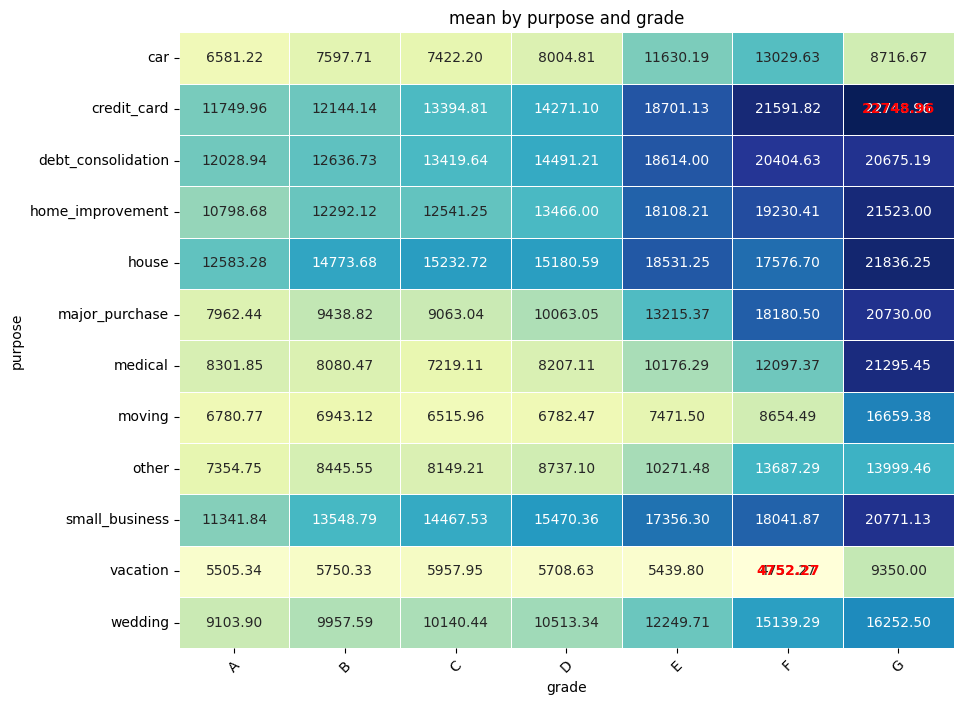

In [ ]:
plot_heatmap_with_min_max(data, index='purpose', columns='grade', values='loan_amnt',aggfunc='mean')

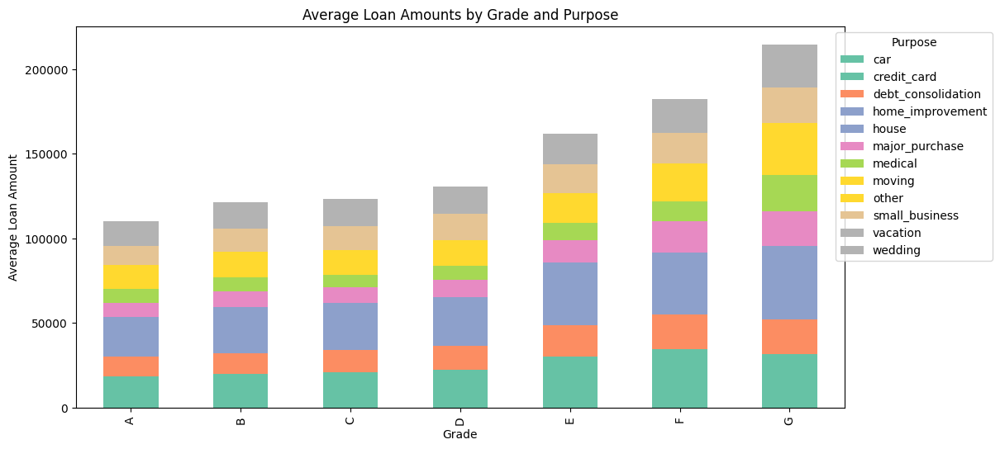

In [ ]:
average_loan1 = average_loan1.apply(pd.to_numeric, errors='coerce')

# Create a stacked bar chart
ax = average_loan1.plot(kind='bar', stacked=True, figsize=(12, 6), colormap='Set2')

# Set plot title and labels
plt.title('Average Loan Amounts by Grade and Purpose')
plt.xlabel('Grade')
plt.ylabel('Average Loan Amount')

# Add a legend
plt.legend(title='Purpose', loc='upper right', bbox_to_anchor=(1.2, 1))

# Show the plot
plt.show()

**The total loan amount in each grade based on the home_ownership**

In [ ]:
total_loan2 = data.groupby(['home_ownership','grade'])['loan_amnt'].sum().unstack('home_ownership')
total_loan2

home_ownership,MORTGAGE,OTHER,OWN,RENT
grade,,,,
A,96815225,139675,12006650,51627775
B,159514450,407925,22974375,113151725
C,134847250,143700,19594075,97595400
D,86281400,253000,13969725,71250275
E,55021925,127250,7040225,39972800
F,25542475,118200,4006375,19866675
G,8062650,55350,1147350,5569700


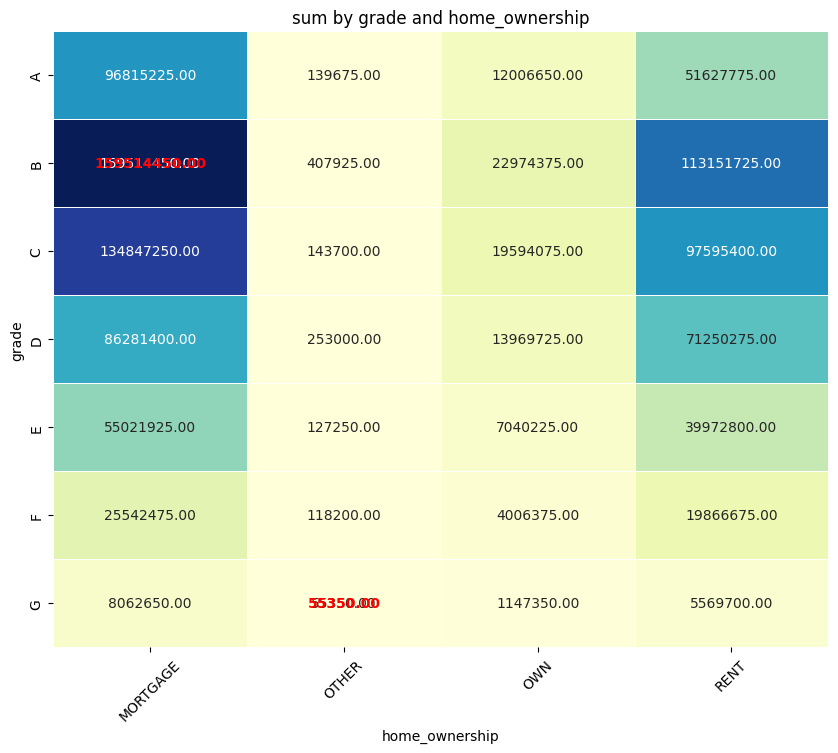

In [ ]:
plot_heatmap_with_min_max(data, index='grade', columns='home_ownership', values='loan_amnt',aggfunc='sum')

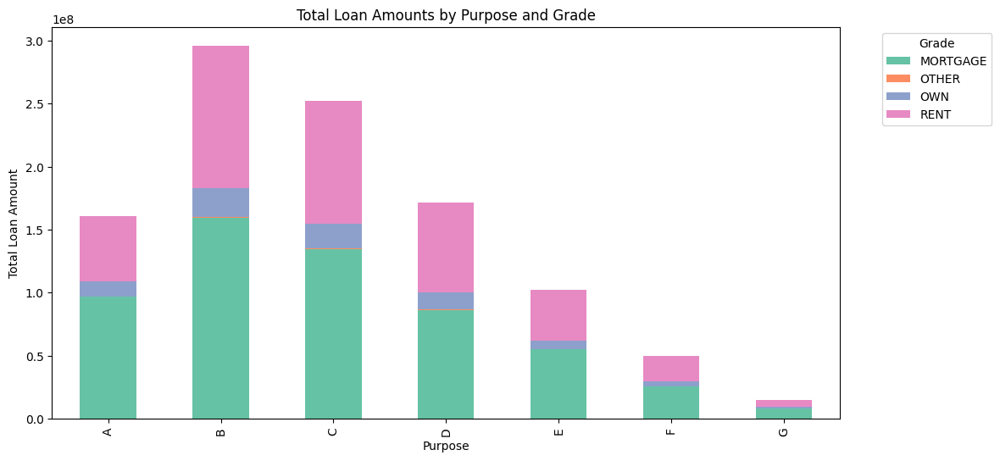

In [ ]:
ax = total_loan2.plot(kind='bar', stacked=True, figsize=(12, 6),color=sns.color_palette("Set2"))

plt.title('Total Loan Amounts by Purpose and Grade')
plt.xlabel('Purpose')
plt.ylabel('Total Loan Amount')
plt.legend(title='Grade', loc='upper right', bbox_to_anchor=(1.2, 1))
plt.show()

**The average loan amount in each grade based on the home_ownership**

In [ ]:
average_loan2 = data.groupby(['home_ownership', 'grade'])['loan_amnt'].mean().unstack('home_ownership')
average_loan2 = average_loan2.applymap(lambda x: '{:.2f}'.format(x) if isinstance(x, (float, int)) else x)
average_loan2

home_ownership,MORTGAGE,OTHER,OWN,RENT
grade,,,,
A,11779.44,6651.19,9997.21,9612.32
B,13127.68,11025.00,11679.91,10654.59
C,14563.91,8981.25,11918.54,10833.10
D,15591.15,12047.62,12851.63,11482.72
E,19401.24,12725.00,15575.72,14674.30
F,21109.48,19700.00,17727.32,16994.59
G,21557.89,11070.00,18505.65,18442.72


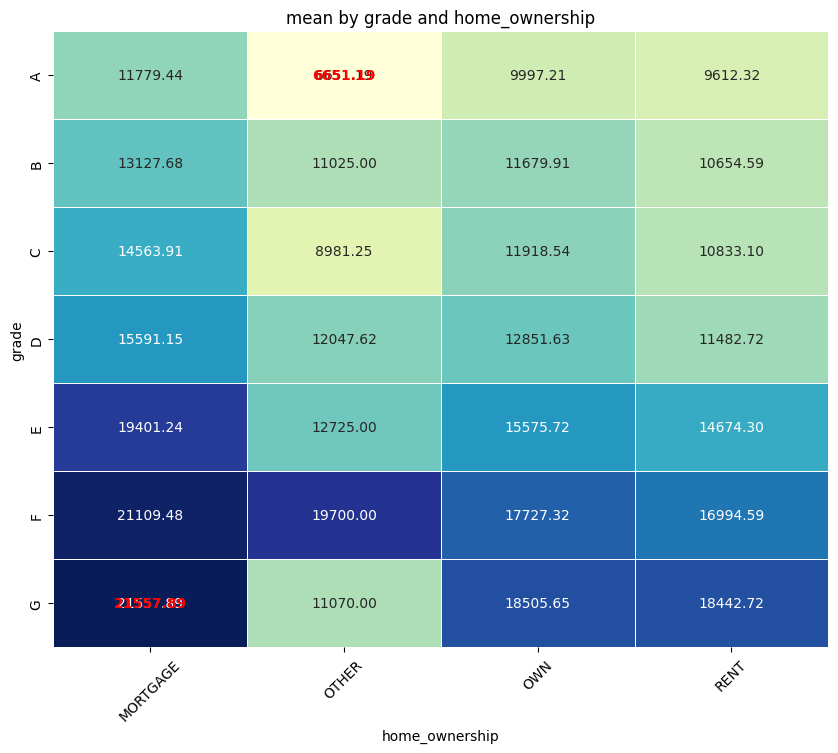

In [ ]:
plot_heatmap_with_min_max(data, index='grade', columns='home_ownership', values='loan_amnt',aggfunc='mean')

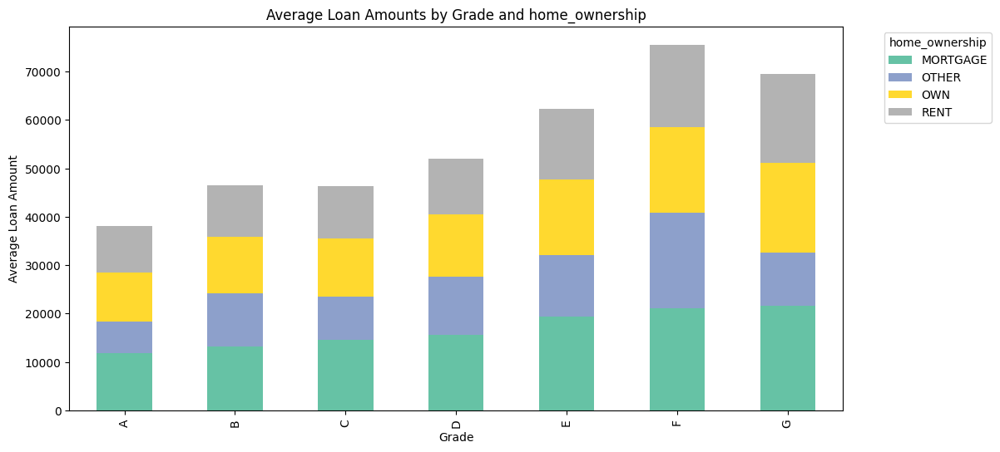

In [ ]:
average_loan2 = average_loan2.apply(pd.to_numeric, errors='coerce')

# Create a stacked bar chart
ax = average_loan2.plot(kind='bar', stacked=True, figsize=(12, 6), colormap='Set2')

# Set plot title and labels
plt.title('Average Loan Amounts by Grade and home_ownership')
plt.xlabel('Grade')
plt.ylabel('Average Loan Amount')

# Add a legend
plt.legend(title='home_ownership', loc='upper right', bbox_to_anchor=(1.2, 1))

# Show the plot
plt.show()

**The total loan amount in each home_ownership based on the purpose**

In [ ]:
total_loan3 = data.groupby(['purpose','home_ownership'])['loan_amnt'].sum().unstack('purpose')
total_loan3

purpose,car,credit_card,debt_consolidation,home_improvement,house,major_purchase,medical,moving,other,small_business,vacation,wedding
home_ownership,,,,,,,,,,,,
MORTGAGE,5104250,103741275,337309500,51828175,4483325,11410250,4716075,1607700,23357375,17684300,1228750,3614400
OTHER,7200,297725,505925,86000,5900,22600,41000,2500,117350,153900,0,5000
OWN,1500825,13755575,44411400,7515850,1084375,2353050,795975,355925,5300350,2628975,348175,688300
RENT,5089500,76113450,247103425,4131250,4508975,10317375,3640100,3625650,24786250,11566375,1769500,6382500


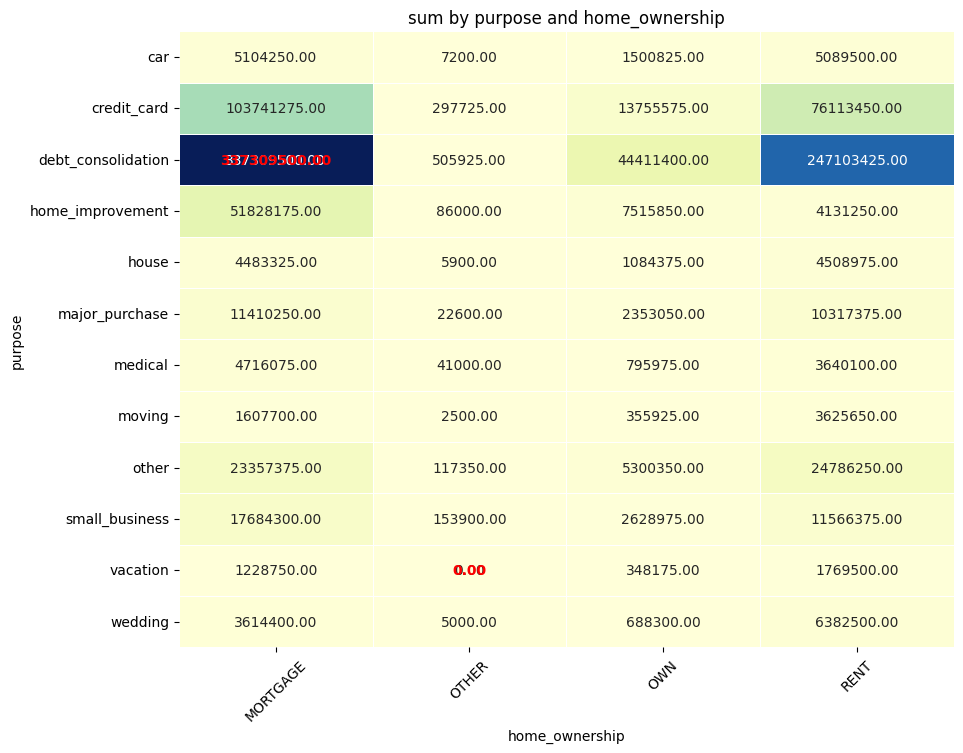

In [ ]:
plot_heatmap_with_min_max(data, index='purpose', columns='home_ownership', values='loan_amnt',aggfunc='sum')

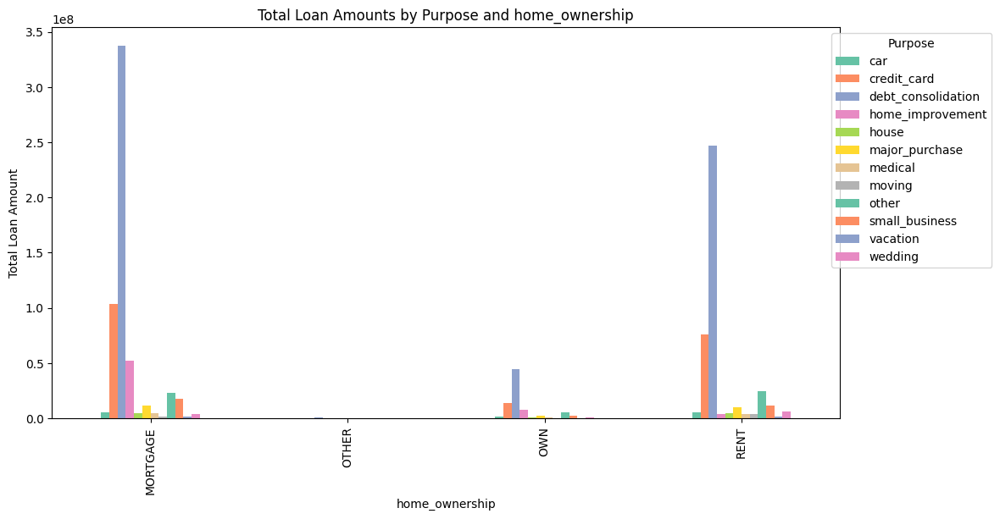

In [ ]:
ax = total_loan3.plot(kind='bar', stacked=False, figsize=(12, 6),color=sns.color_palette("Set2"))

plt.title('Total Loan Amounts by Purpose and home_ownership')
plt.xlabel('home_ownership')
plt.ylabel('Total Loan Amount')
plt.legend(title='Purpose', loc='upper right', bbox_to_anchor=(1.2, 1))
plt.show()

**The average loan amount in each purpose based on the home_ownership**

In [ ]:
average_loan3 = data.groupby(['home_ownership', 'purpose'])['loan_amnt'].mean().unstack('home_ownership')
average_loan3 = average_loan3.applymap(lambda x: '{:.2f}'.format(x) if isinstance(x, (float, int)) else x)
average_loan3

home_ownership,MORTGAGE,OTHER,OWN,RENT
purpose,,,,
car,7354.83,7200.00,7657.27,7495.58
credit_card,14750.64,11026.85,12677.95,11572.67
debt_consolidation,15453.77,12339.63,13092.98,12252.25
home_improvement,13045.10,14333.33,12443.46,10150.49
house,16728.82,2950.00,16184.70,13746.88
major_purchase,9887.56,4520.00,9120.35,8871.35
medical,9357.29,8200.00,7439.02,7761.41
moving,10576.97,2500.00,8089.20,6093.53
other,9947.77,6519.44,9014.20,7861.16


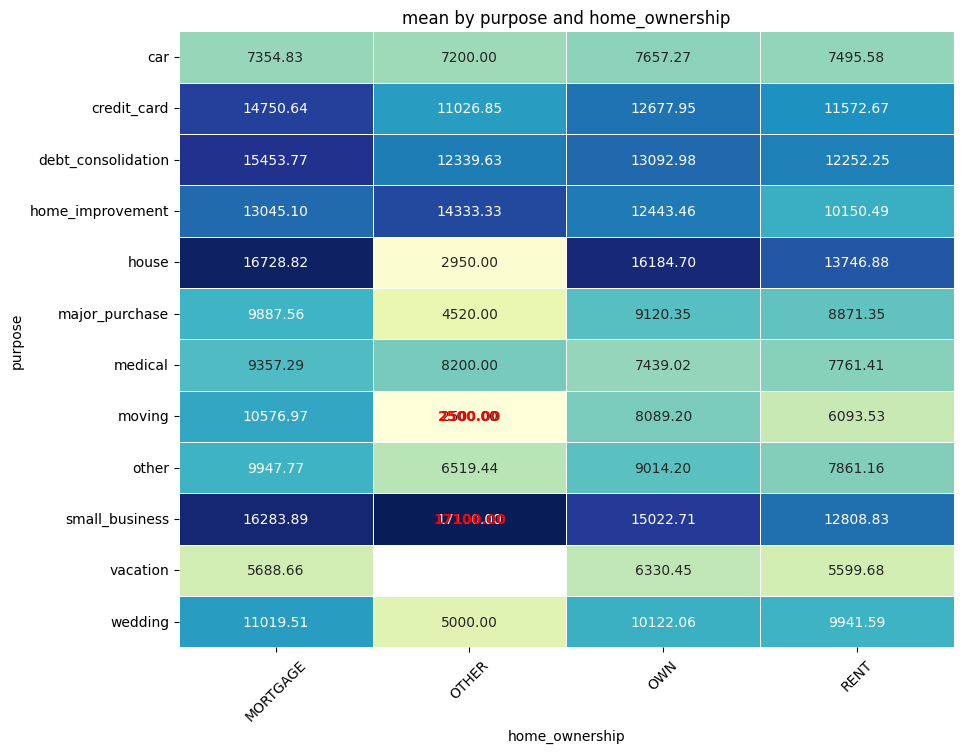

In [ ]:
plot_heatmap_with_min_max(data, index='purpose', columns='home_ownership', values='loan_amnt',aggfunc='mean')

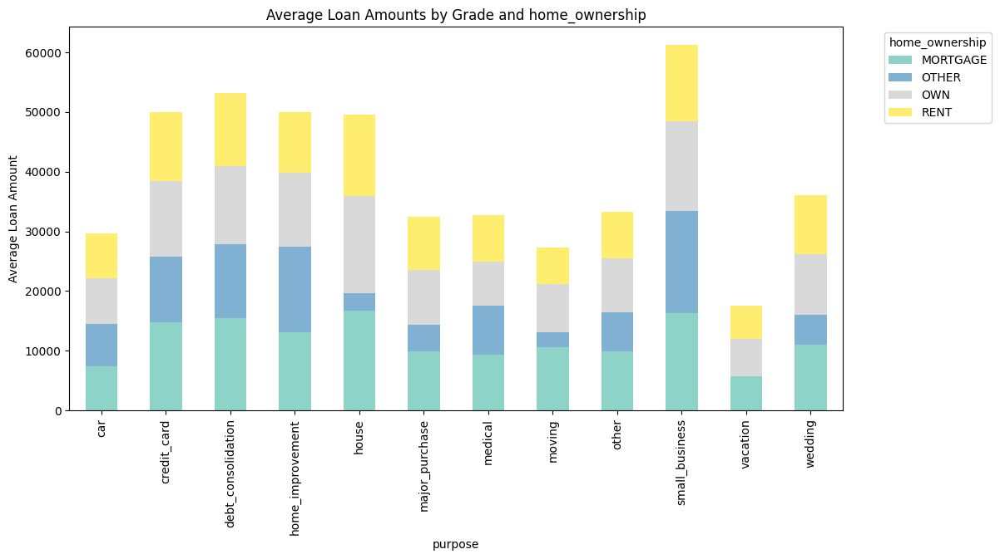

In [ ]:
average_loan3 = average_loan3.apply(pd.to_numeric, errors='coerce')

# Create a stacked bar chart
ax = average_loan3.plot(kind='bar', stacked=True, figsize=(12, 6), colormap='Set3')

# Set plot title and labels
plt.title('Average Loan Amounts by Grade and home_ownership')
plt.xlabel('purpose')
plt.ylabel('Average Loan Amount')

# Add a legend
plt.legend(title='home_ownership', loc='upper right', bbox_to_anchor=(1.2, 1))

# Show the plot
plt.show()

**Count of Grades by Purpose**

In [ ]:
data_grade = data.groupby(['purpose','grade'])['grade'].agg('count').unstack('grade')
data_grade

grade,A,B,C,D,E,F,G
purpose,,,,,,,
car,599,459,268,161,53,27,3
credit_card,2893,5253,3729,1839,664,272,72
debt_consolidation,6817,13888,11749,7490,3564,1527,393
home_improvement,1290,1485,1103,622,329,111,50
house,145,170,136,94,56,44,20
major_purchase,858,718,506,316,122,50,10
medical,230,247,225,218,116,38,11
moving,143,200,141,154,107,39,8
other,1095,1438,1327,1242,611,301,93


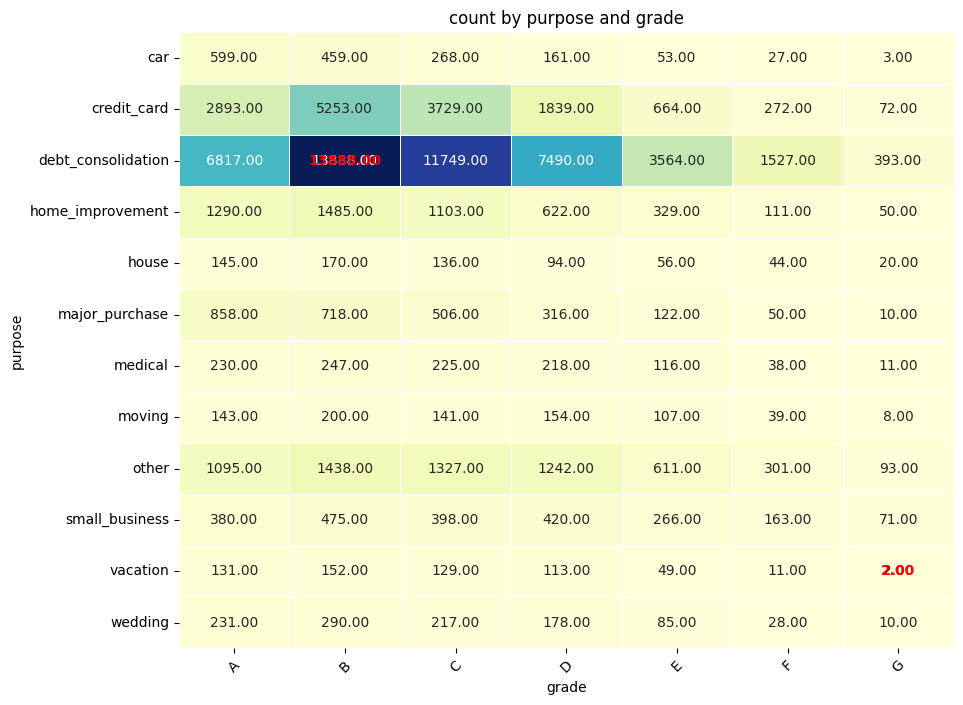

In [ ]:
plot_heatmap_with_min_max(data, index='purpose', columns='grade', values='loan_amnt',aggfunc='count')

<Figure size 1600x600 with 0 Axes>

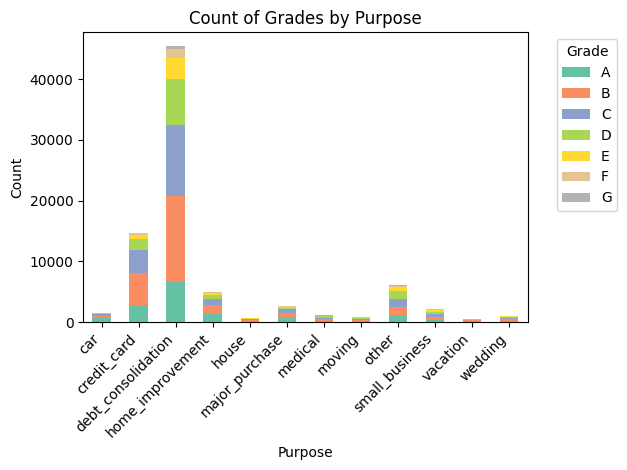

In [ ]:
# pivot_table = data.pivot_table(index='purpose', columns='grade', values='loan_amnt', aggfunc='count')
# plt.figure(figsize=(16, 8))
# sns.heatmap(pivot_table, cmap='YlGnBu', annot=True, fmt='.2f', linewidths=.5)
# plt.title('Count of Grades by Purpose')
# plt.xlabel('Grade')
# plt.ylabel('Purpose')
# plt.xticks(rotation=45)
# plt.show()

plt.figure(figsize=(16, 6))
data_grade.plot(kind='bar', stacked=True, cmap='Set2')
plt.title('Count of Grades by Purpose')
plt.xlabel('Purpose')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')
plt.legend(title='Grade', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

**Count of Grades by home_ownership**

In [ ]:
data_hme = data.groupby(['home_ownership','grade'])['grade'].agg('count').unstack('grade')
data_hme

grade,A,B,C,D,E,F,G
home_ownership,,,,,,,
MORTGAGE,8219,12151,9259,5534,2836,1210,374
OTHER,21,37,16,21,10,6,5
OWN,1201,1967,1644,1087,452,226,62
RENT,5371,10620,9009,6205,2724,1169,302


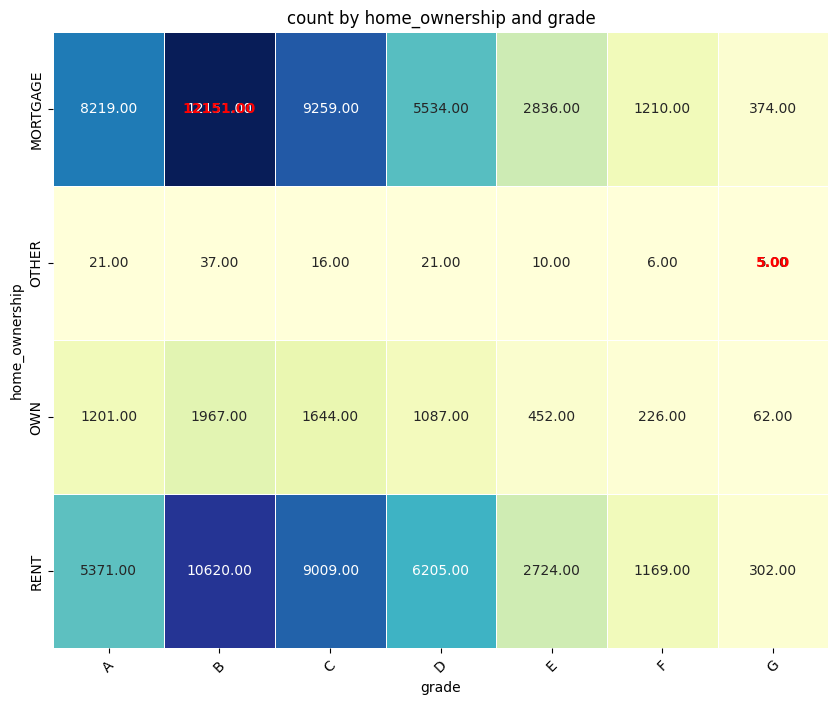

In [ ]:
plot_heatmap_with_min_max(data, index='home_ownership', columns='grade', values='loan_amnt',aggfunc='count')

<Figure size 1600x600 with 0 Axes>

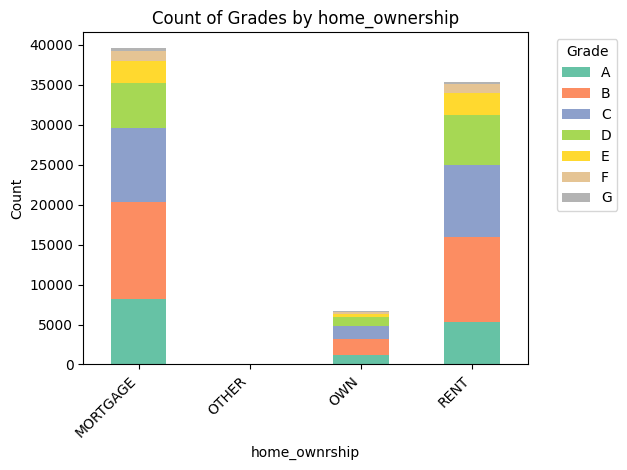

In [ ]:
plt.figure(figsize=(16, 6))
data_hme.plot(kind='bar', stacked=True, cmap='Set2')
plt.title('Count of Grades by home_ownership')
plt.xlabel('home_ownrship')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')
plt.legend(title='Grade', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

**Count of home_ownership by purpose**

In [ ]:
prp_hme = data.groupby(['purpose','home_ownership'])['home_ownership'].agg('count').unstack('home_ownership')
prp_hme

home_ownership,MORTGAGE,OTHER,OWN,RENT
purpose,,,,
car,694,1,196,679
credit_card,7033,27,1085,6577
debt_consolidation,21827,41,3392,20168
home_improvement,3973,6,604,407
house,268,2,67,328
major_purchase,1154,5,258,1163
medical,504,5,107,469
moving,152,1,44,595
other,2348,18,588,3153


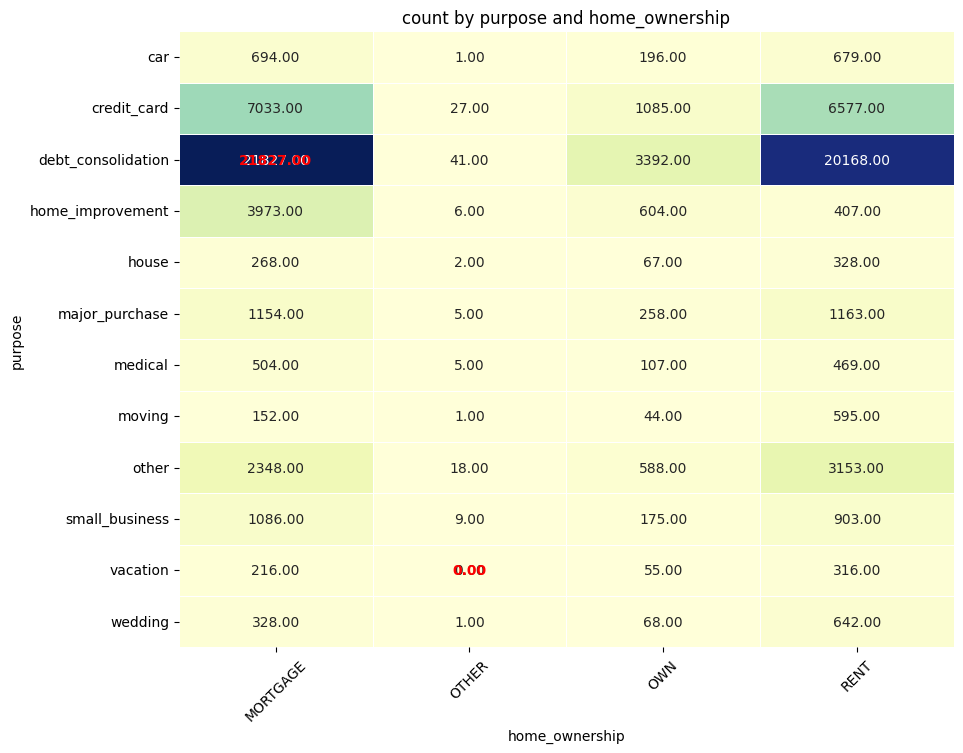

In [ ]:
plot_heatmap_with_min_max(data, index='purpose', columns='home_ownership', values='loan_amnt',aggfunc='count')

<Figure size 1200x600 with 0 Axes>

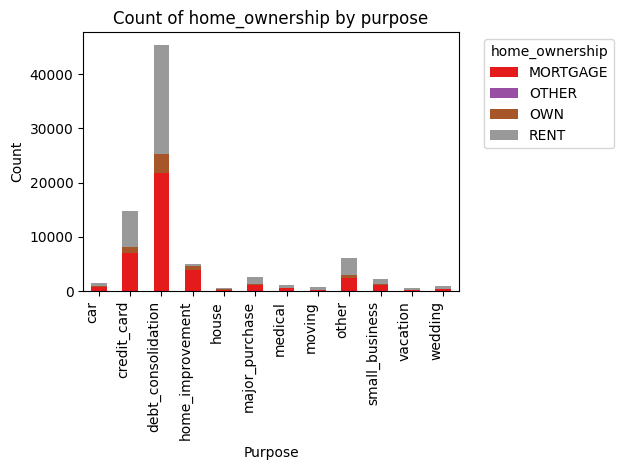

In [ ]:
plt.figure(figsize=(12, 6))
prp_hme.plot(kind='bar', stacked=True, cmap='Set1')
plt.title('Count of home_ownership by purpose')
plt.xlabel('Purpose')
plt.ylabel('Count')
plt.xticks(rotation=90, ha='right')
plt.legend(title='home_ownership', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

**Faceted Line Plot**

This faceted line plot examines the effect of home ownership, grade, or goal on loan amounts by considering different categories within each of the other three columns. Each aspect corresponds to a specific purpose, and the lines show how loan amounts vary based on different.

In [ ]:
def plot_facet_line(data, col_col, col_wrap, height, hue_col, palette, x_col, y_col, legend_title, title_template="{col_name}"):
    g = sns.FacetGrid(data, col=col_col, col_wrap=col_wrap, height=height, hue=hue_col, palette=palette)
    g.map(sns.lineplot, x_col, y_col)
    g.set_titles(col_template=title_template)
    g.set_xlabels(x_col)
    g.set_ylabels(y_col)
    g.add_legend(title=legend_title)

    # Rotate x-axis labels for each subplot
    for ax in g.axes.flat:
        # ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
        ax.tick_params(axis='x', rotation=90)

    plt.tight_layout()

    # for ax in g.axes.flat:
    #     sns.despine(ax=ax, bottom=True)

    plt.show()


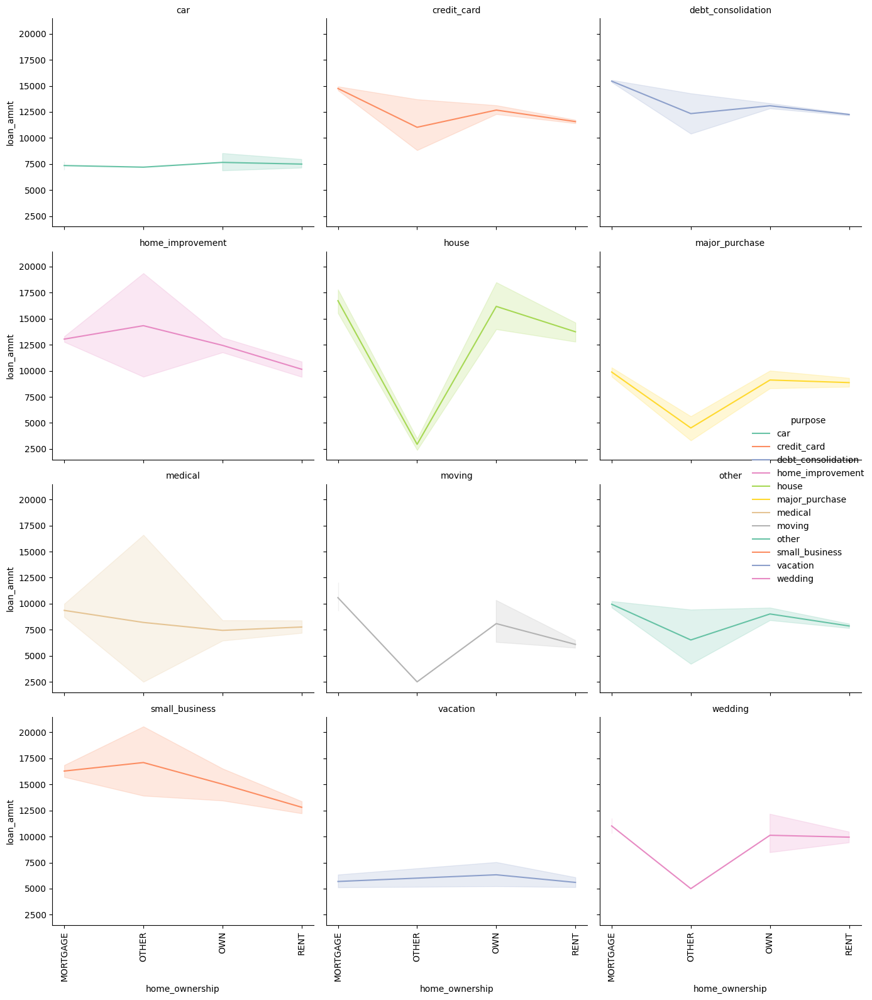

In [ ]:
plot_facet_line(data, col_col='purpose', col_wrap=3, height=4, hue_col='purpose', palette='Set2', x_col='home_ownership', y_col='loan_amnt', legend_title='purpose')

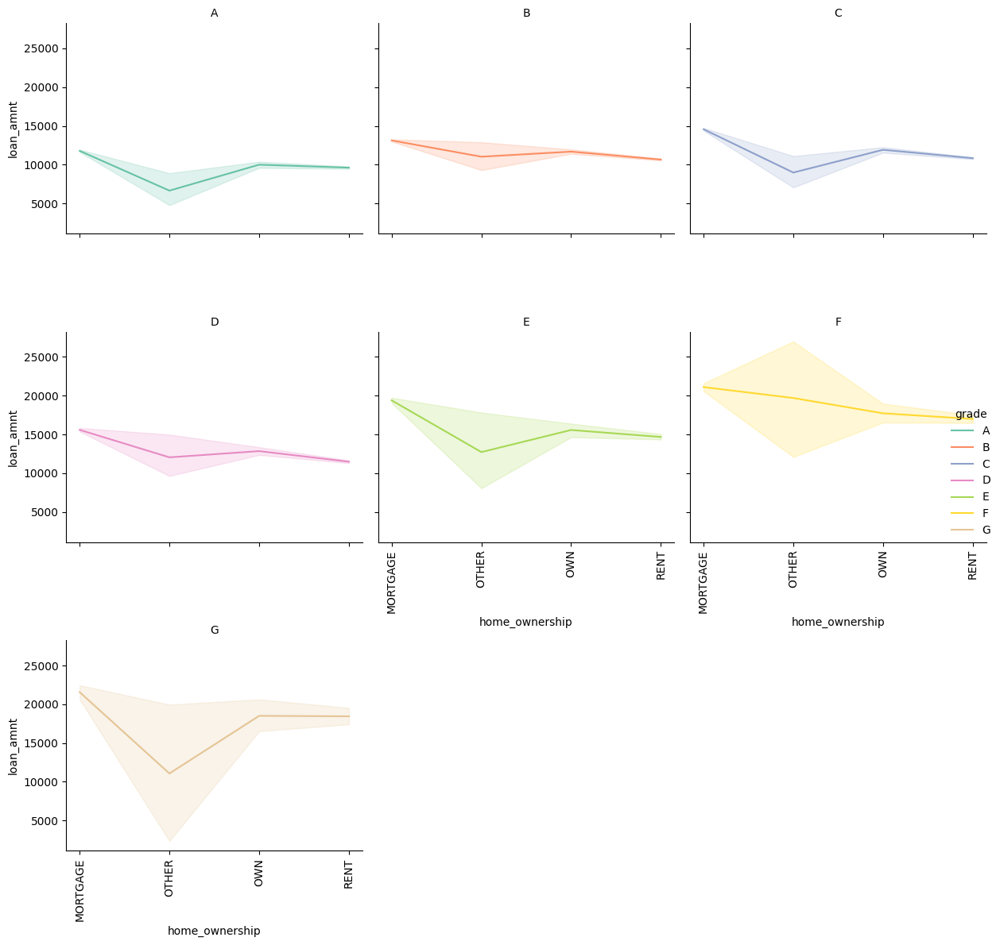

In [ ]:
plot_facet_line(data, col_col='grade', col_wrap=3, height=4, hue_col='grade', palette='Set2', x_col='home_ownership', y_col='loan_amnt', legend_title='grade')

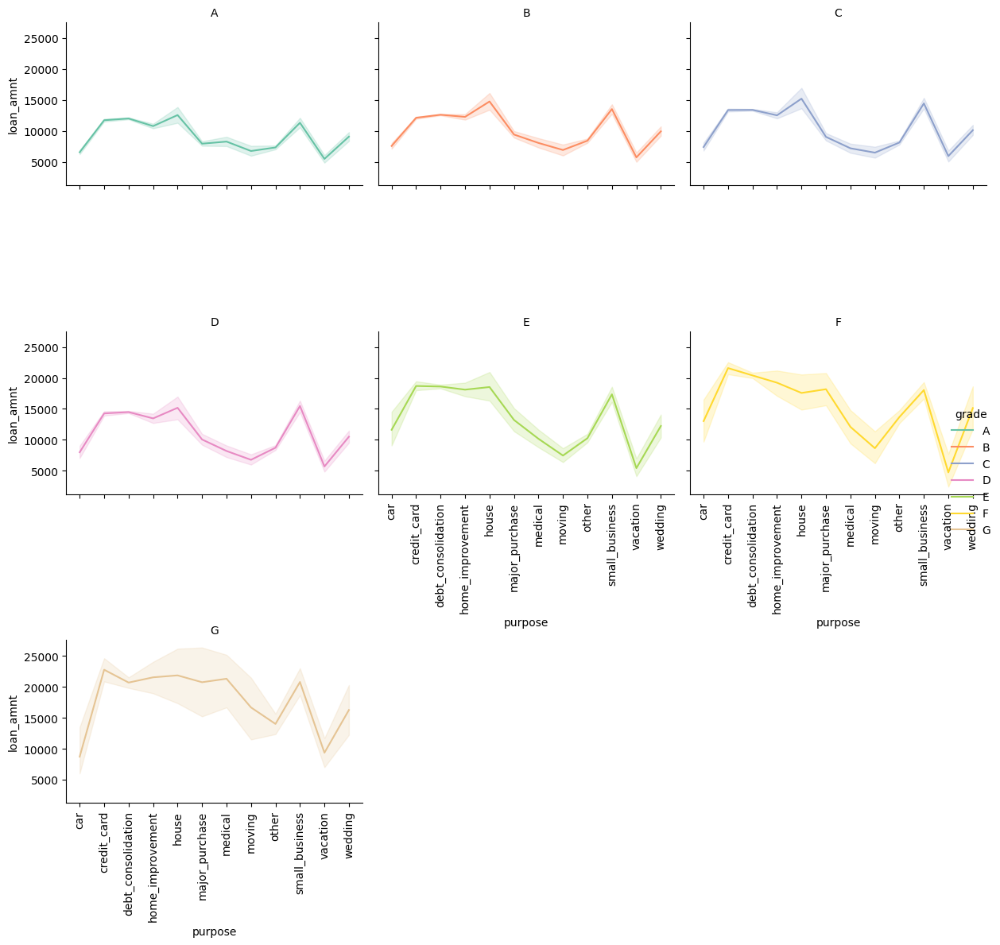

In [ ]:
plot_facet_line(data, col_col='grade', col_wrap=3, height=4, hue_col='grade', palette='Set2', x_col='purpose', y_col='loan_amnt', legend_title='grade',title_template="{col_name}")

**Relation of binary columns to each other**

The plot_countplot_with_annotations function generates a count plot to visualize the relationship between two categorical variables (x and hue) in the given dataset. Annotations are added to each bar in the plot to display the count of each category.

In [ ]:
def plot_countplot_with_annotations(data, x, hue, palette='Set1'):
    plt.figure(figsize=(6, 4))
    ax = sns.countplot(data=data, x=x, hue=hue, palette=palette)


    for p in ax.patches:
        height = p.get_height()
        ax.annotate('{}'.format(int(height)),
                    (p.get_x() + p.get_width() / 2., height),
                    ha='center', va='bottom', fontsize=10)

    plt.title(f'{x} vs {hue} Relationship')
    plt.xlabel(x)
    plt.ylabel('Count')
    plt.show()

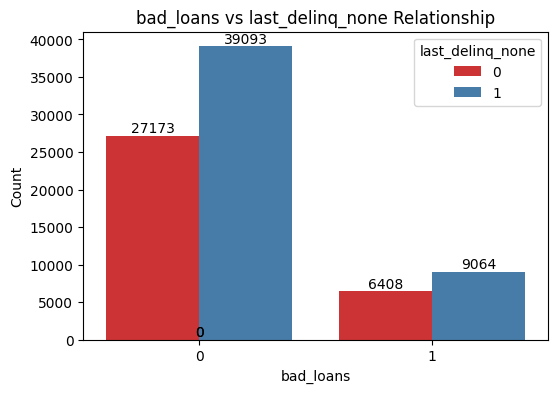

In [ ]:
plot_countplot_with_annotations(data, x='bad_loans', hue='last_delinq_none')

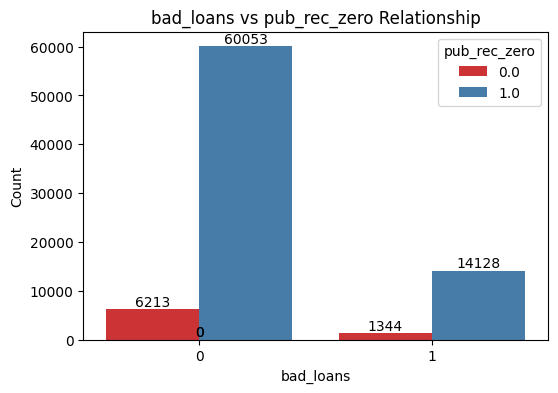

In [ ]:
plot_countplot_with_annotations(data, x='bad_loans', hue='pub_rec_zero')

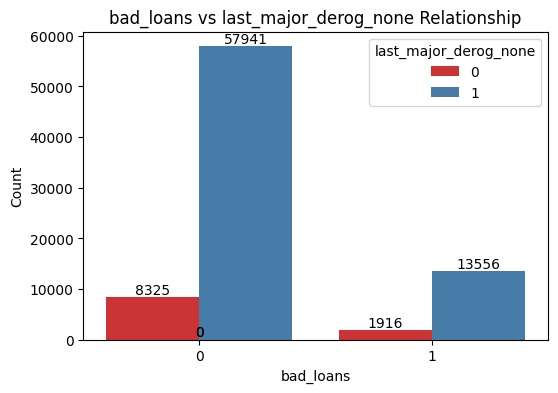

In [ ]:
plot_countplot_with_annotations(data, x='bad_loans', hue='last_major_derog_none')

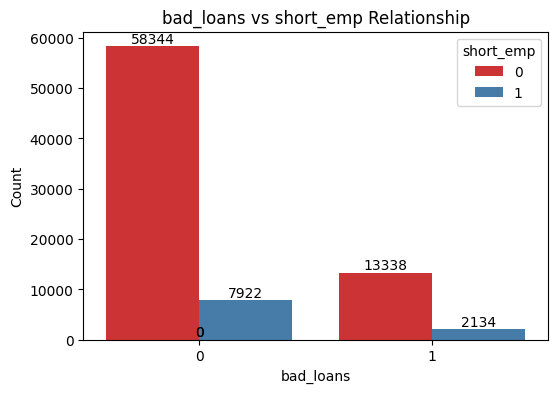

In [ ]:
plot_countplot_with_annotations(data, x='bad_loans', hue='short_emp')

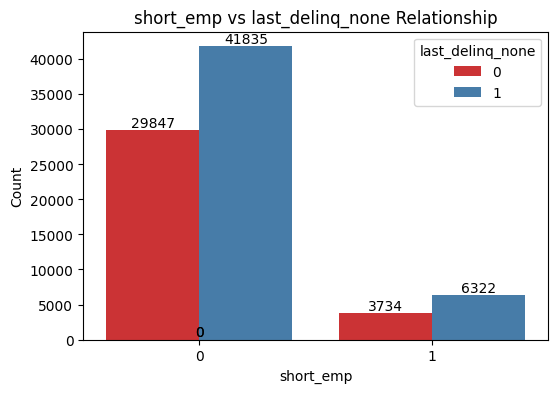

In [ ]:
plot_countplot_with_annotations(data, x='short_emp', hue='last_delinq_none')

**Top Five Loan Purposes Across Grades**

The provided code generates a bar plot visualizing the top five loan purposes for each grade in the dataset.

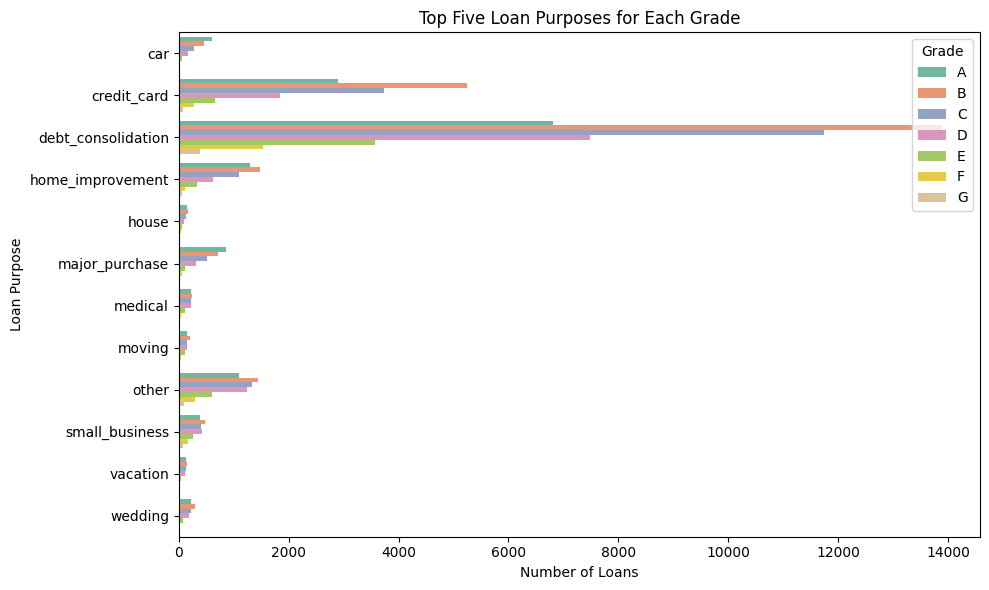

In [ ]:
top_purposes_by_grade = data.groupby(['grade', 'purpose'])['loan_amnt'].count().reset_index()
top_purposes_by_grade = top_purposes_by_grade.sort_values(by=['grade', 'loan_amnt'], ascending=[True, False])
# top_purposes_by_grade = top_purposes_by_grade.groupby('grade').head(5)
plt.figure(figsize=(10, 6))
ax = sns.barplot(x='loan_amnt', y='purpose', hue='grade', data=top_purposes_by_grade, palette='Set2')
ax.set_title('Top Five Loan Purposes for Each Grade')
ax.set_xlabel('Number of Loans')
ax.set_ylabel('Loan Purpose')
plt.legend(title='Grade', loc='upper right')
plt.tight_layout()
plt.show()

**Top Loan Purposes for Homeowners by Ownership Status**

This function generates a bar plot illustrating the top loan purposes for homeowners based on their ownership status. The plot showcases the most common loan purposes among homeowners.

In [ ]:

def plot_top_purposes(data_subset, top_purpose_counts, ownership_status='OWN', top_n=5, color_palette='Set3'):
    top_purpose_indices = top_purpose_counts.index

    # Customizing the color palette
    colors = plt.cm.get_cmap(color_palette, top_n).colors

    # Plotting the bar chart with enhanced aesthetics
    plt.figure(figsize=(10, 6))
    bars = plt.bar(top_purpose_indices, top_purpose_counts, color=colors)

    # Adding annotations on the bars
    for bar in bars:
        plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height() + 0.5,
                 f'{int(bar.get_height())}', ha='center', va='bottom', fontsize=10)

    # Customizing the title and axis labels
    plt.title(f'Top {top_n} Loan Purposes for Homeowners with Ownership Status \'{ownership_status}\'', fontsize=16)
    plt.xlabel('Purpose', fontsize=12)
    plt.ylabel('Count', fontsize=12)

    # Rotating x-axis labels for better readability
    plt.xticks(rotation=45, ha='right')

    # Adding gridlines for better visualization
    plt.grid(axis='y', linestyle='--', alpha=0.5)

    # Removing unnecessary spines
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)

    # Adjusting layout for better spacing
    plt.tight_layout()

    # Showing the plot
    plt.show()


**Top 5 Loan Purposes for Homeowners with Ownership Status 'OWN'**



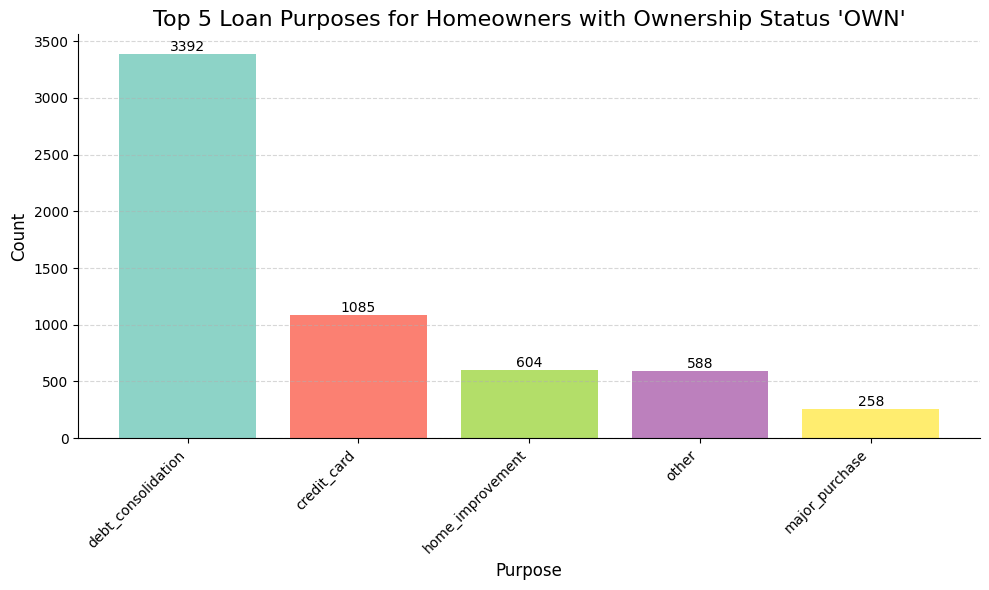

In [ ]:
data_subset = data[data['home_ownership']=='OWN']
top_purpose_counts = data_subset['purpose'].value_counts()[:5]
plot_top_purposes(data_subset, top_purpose_counts, ownership_status='OWN', top_n=5)

**Top 5 Loan Purposes for Homeowners with Ownership Status 'RENT'**

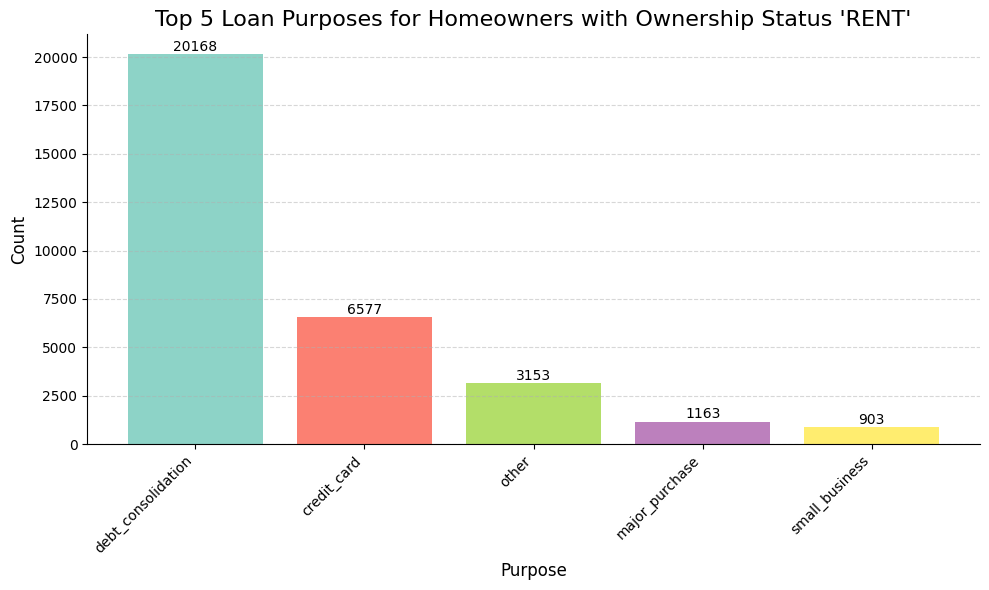

In [ ]:
data_subset = data[data['home_ownership']=='RENT']
top_purpose_counts = data_subset['purpose'].value_counts()[:5]
plot_top_purposes(data_subset, top_purpose_counts, ownership_status='RENT', top_n=5)

**Top 5 Loan Purposes for Homeowners with Ownership Status 'MORTGAGE'**

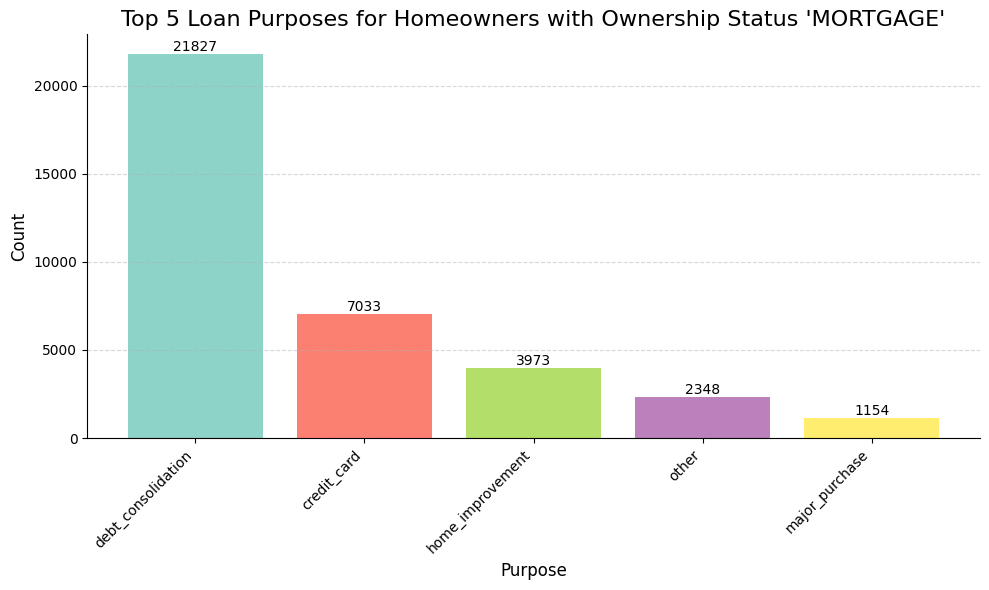

In [ ]:
data_subset = data[data['home_ownership']=='MORTGAGE']
top_purpose_counts = data_subset['purpose'].value_counts()[:5]
plot_top_purposes(data_subset, top_purpose_counts, ownership_status='MORTGAGE', top_n=5)

**Top 5 Loan Purposes for Homeowners with Ownership Status 'OTHER'**

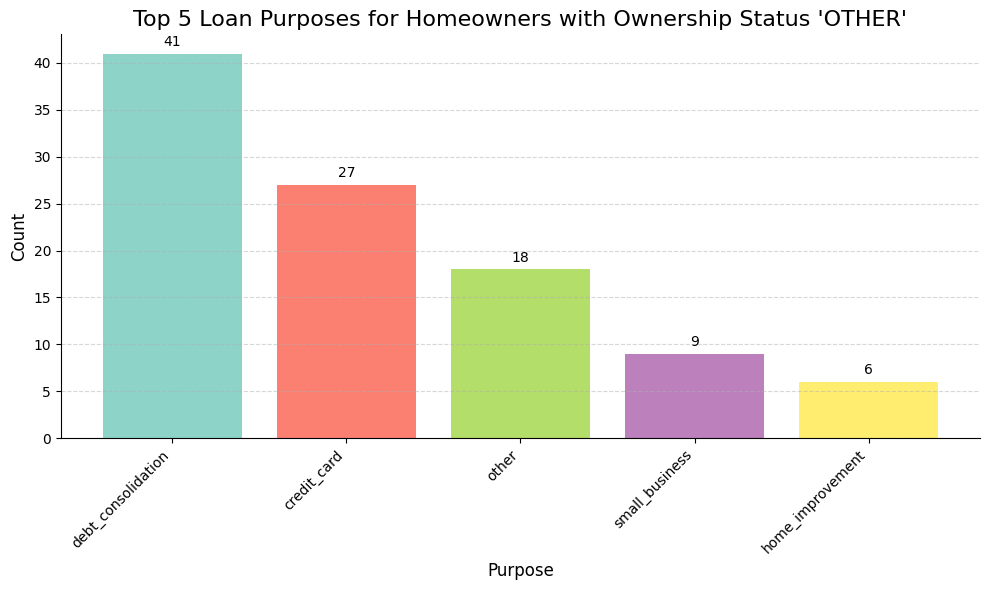

In [ ]:
data_subset = data[data['home_ownership']=='OTHER']
top_purpose_counts = data_subset['purpose'].value_counts()[:5]
plot_top_purposes(data_subset, top_purpose_counts, ownership_status='OTHER', top_n=5)

 **Multi-Hue Bar Plots Comparison**

The plot_barplots function generates multiple bar plots in a grid layout, comparing the same dependent variable (y_var) across different categories specified by the hue variables (hue_var). Each subplot represents a unique hue variable, allowing for a visual comparison of how the dependent variable varies across different categories. The x-axis represents the independent variable (x_var), while the y-axis represents the values of the dependent variable.

In [ ]:
def plot_barplots(data, x_var, y_var, hue_var, ncols=3, figsize=(25, 15), sharey=True):
    # Calculate number of rows required based on the number of hue variables and columns
    nrows = (len(hue_var) + ncols - 1) // ncols

    # Create subplots grid
    fig, axes = plt.subplots(nrows, ncols, figsize=figsize, sharey=sharey)
    fig.suptitle('')
    plt.subplots_adjust(hspace=0.5)

    # Flatten the axes array
    axes = axes.flatten()

    # Plot each barplot for each hue variable
    for i, (hue, ax) in enumerate(zip(hue_var, axes)):
        sns.barplot(x=x_var, y=y_var, hue=hue, data=data, ax=ax)
        ax.set_title(f"{y_var} vs {hue}")
        ax.tick_params(axis='x', rotation=90)  # Rotate x-axis labels

        # Hide legend if only one category in hue variable
        if len(data[hue].unique()) == 1:
            ax.legend().remove()

    # Hide empty subplots
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

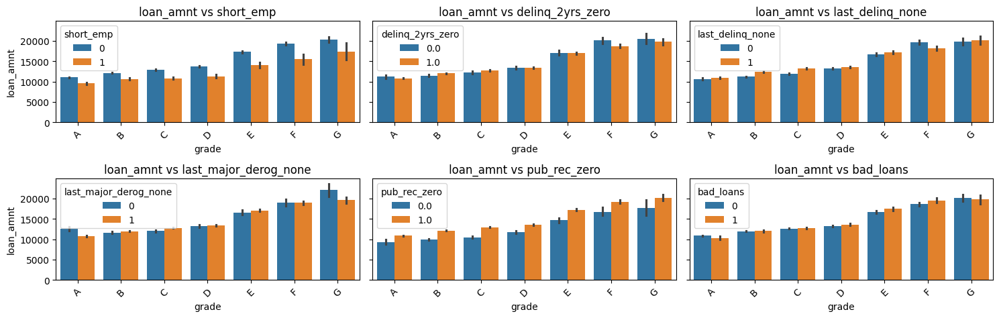

In [ ]:
hue_vars = ['short_emp', 'delinq_2yrs_zero', 'last_delinq_none', 'last_major_derog_none', 'pub_rec_zero', 'bad_loans']
plot_barplots(data, x_var='grade', y_var='loan_amnt', hue_var= hue_vars)


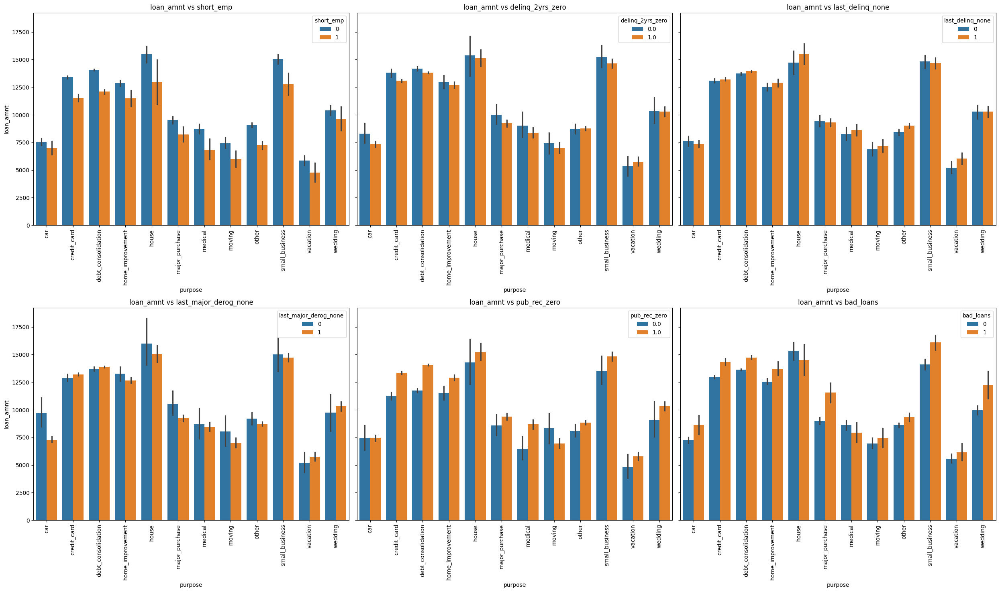

In [ ]:
plot_barplots(data, x_var='purpose', y_var='loan_amnt', hue_var= hue_vars)

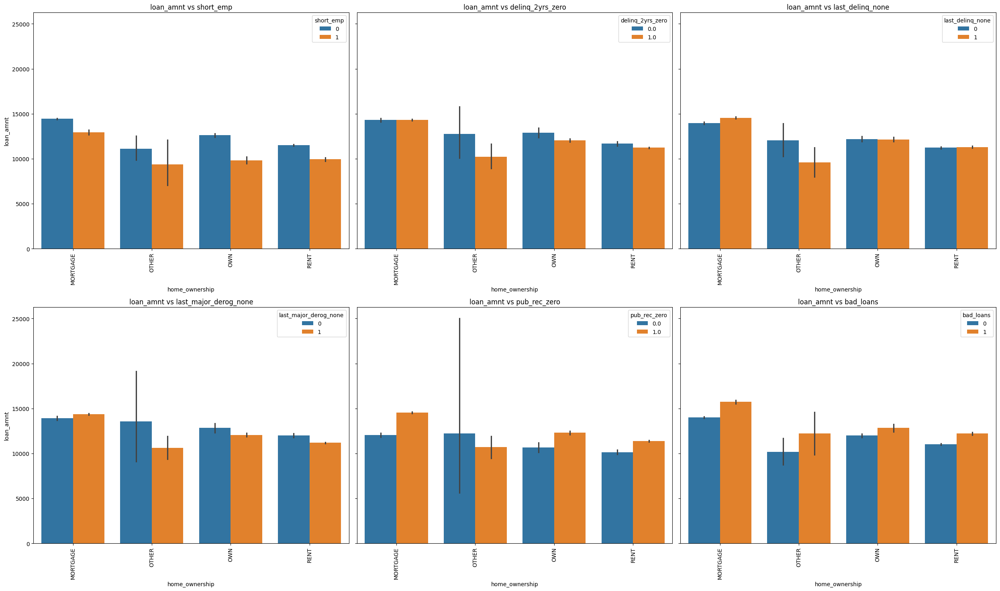

In [ ]:
plot_barplots(data, x_var='home_ownership', y_var='loan_amnt', hue_var= hue_vars)

**Checking for normal distribution**

This function takes one column of data as input each time and performs both the Shapiro-Wilk test and the Kolmogorov-Smirnov test and D'Agostino-Pearson test for normality. It prints the test results indicating whether the data may or may not follow a normal distribution based on the p-values obtained from the tests.

In [ ]:
data_outlier = ['loan_amnt','inq_last_6mths','emp_length_num','delinq_2yrs','dti','revol_util','payment_inc_ratio','open_acc']

def test_normality(column_data):
    # Shapiro-Wilk test
    _, shapiro_p_value = stats.shapiro(column_data)
    if shapiro_p_value < 0.05:
        print(f"Shapiro-Wilk Test: The data in column '{column_data.name}' does not follow a normal distribution (reject H0)")
    else:
        print(f"Shapiro-Wilk Test: The data in column '{column_data.name}' may follow a normal distribution (fail to reject H0)")

    # Kolmogorov-Smirnov test
    _, ks_p_value = stats.kstest(column_data, 'norm')
    if ks_p_value < 0.05:
        print(f"Kolmogorov-Smirnov Test: The data in column '{column_data.name}' does not follow a normal distribution (reject H0)")
    else:
        print(f"Kolmogorov-Smirnov Test: The data in column '{column_data.name}' may follow a normal distribution (fail to reject H0)")

    # Perform D'Agostino-Pearson test
    _, DAP_p_value = stats.normaltest(column_data)
    if DAP_p_value < 0.05:
        print(f"D'Agostino-Pearson Test: The data in column '{column_data.name}' is not normally distributed (reject H0)")
    else:
        print(f"D'Agostino-Pearson Test: The data in column '{column_data.name}' is normally distributed (fail to reject H0)")


In [ ]:
for column in data_outlier:
        print(f"Testing normality for column: {column}")
        test_normality(data[column])
        print()

Testing normality for column: loan_amnt
Shapiro-Wilk Test: The data in column 'loan_amnt' does not follow a normal distribution (reject H0)
Kolmogorov-Smirnov Test: The data in column 'loan_amnt' does not follow a normal distribution (reject H0)
D'Agostino-Pearson Test: The data in column 'loan_amnt' is not normally distributed (reject H0)

Testing normality for column: inq_last_6mths
Shapiro-Wilk Test: The data in column 'inq_last_6mths' does not follow a normal distribution (reject H0)
Kolmogorov-Smirnov Test: The data in column 'inq_last_6mths' does not follow a normal distribution (reject H0)
D'Agostino-Pearson Test: The data in column 'inq_last_6mths' is not normally distributed (reject H0)

Testing normality for column: emp_length_num
Shapiro-Wilk Test: The data in column 'emp_length_num' does not follow a normal distribution (reject H0)
Kolmogorov-Smirnov Test: The data in column 'emp_length_num' does not follow a normal distribution (reject H0)
D'Agostino-Pearson Test: The data

**Assessing Normality: Generating QQ Plots for Multiple Data Columns**

A Q-Q plot is a visual tool used to compare the distribution of two sets of data, typically the theoretical distribution and the empirical distribution of a sample. It provides a powerful visual assessment, pinpointing deviations between distributions.The code draws QQ plots for several columns to assess whether their distributions approximate a normal distribution. By visually inspecting these plots, you can identify which columns have distributions that closely follow a normal distribution and which deviate from it. This helps in understanding the underlying distributional characteristics of the data and can be valuable for various analytical tasks such as hypothesis testing, model assumptions checking, and feature engineering.

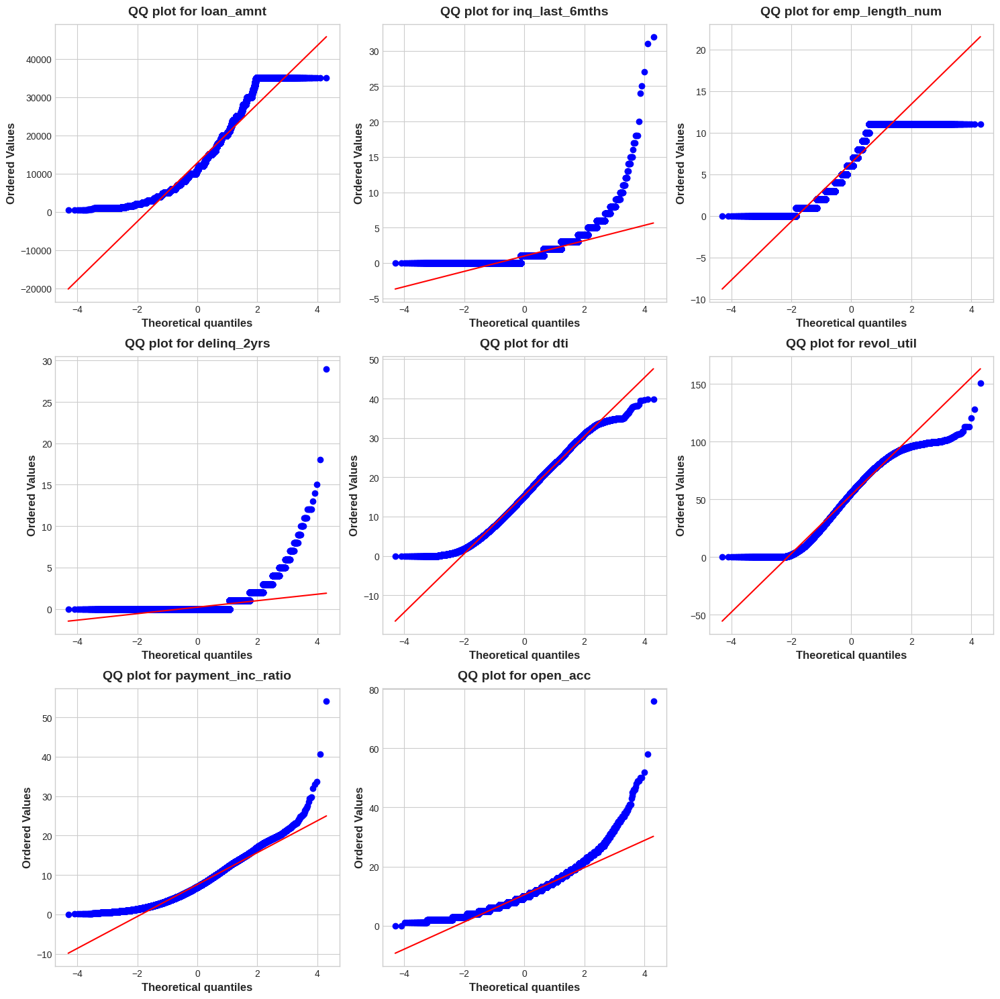

In [ ]:
# Set up the plot grid
num_plots = len( data_outlier)
num_cols = 3  # Assuming you want 3 plots per row
num_rows = (num_plots - 1) // num_cols + 1

# Create a figure and axes for subplots
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))

# Flatten the axes if necessary
if num_rows == 1:
    axes = [axes]

# Loop through each column and plot QQ plot
for i, column in enumerate(data_outlier):
    row = i // num_cols
    col = i % num_cols
    ax = axes[row][col]

    # Generate QQ plot
    stats.probplot(data[column], dist="norm", plot=ax)

    # Set title for each subplot
    ax.set_title(f'QQ plot for {column}')

# Adjust layout to remove empty subplots if they exist
if num_plots < num_rows * num_cols:
    empty_row = num_plots // num_cols
    empty_col = num_plots % num_cols
    for i in range(empty_col, num_cols):
        plt.delaxes(axes[empty_row][i])

# Adjust layout
plt.tight_layout()
plt.show()


**Detect Outliers: Boxplots**

The purpose of drawing boxplots for numerical data is indeed to visually inspect the distribution of the data, identify central tendencies (such as median), and detect outliers.

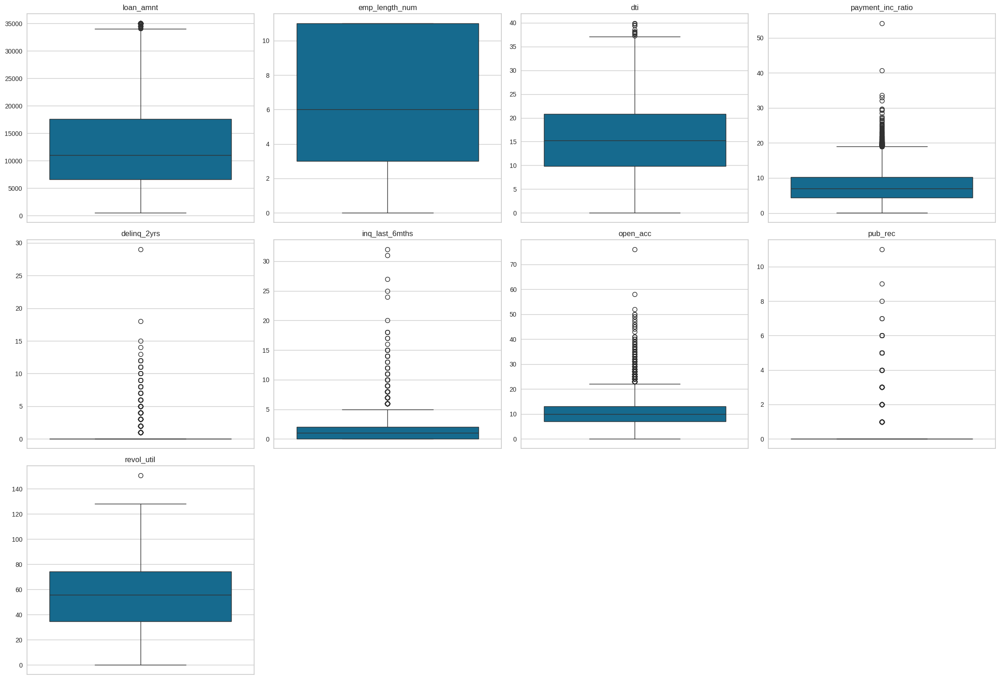

In [ ]:
numeric_columns = data.select_dtypes(include=['float', 'int']).columns

# Number of columns and rows required for charts
num_columns = len(numeric_columns)
# Number of columns
num_cols = 4
# The number of rows
num_rows = math.ceil(num_columns / num_cols)


plt.figure(figsize=(22, 5 * num_rows))

# Draw a box plot for each numerical column
for i, column in enumerate(numeric_columns):
    plt.subplot(num_rows, num_cols, i + 1)
    sns.boxplot(y=data[column])
    plt.title(column)
    plt.ylabel("")

plt.tight_layout()
plt.show()

**Identifying Outliers with Interquartile Range (IQR)**

In [ ]:
def count_outliers(df):
    numeric_columns = df.select_dtypes(include=['float', 'int']).columns

    outliers_count = {}

    for column in numeric_columns:
        # Calculation of quartiles and interquartile range (IQR)
        Q1 = df[column].quantile(0.25)
        Q3 = df[column].quantile(0.75)
        IQR = Q3 - Q1

        # Set upper and lower thresholds
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR

       # Identify outliers
        outliers = df[(df[column] < lower_bound) | (df[column] > upper_bound)][column]

        # count outliers
        outliers_count[column] = len(outliers)

    return outliers_count

In [ ]:
# count outliers
outliers_count = count_outliers(data)

print("\nOutliers count in columns:")
for column, count in outliers_count.items():
    print(f"{column}: {count} outliers")



Outliers count in columns:
loan_amnt: 2116 outliers
emp_length_num: 0 outliers
dti: 16 outliers
payment_inc_ratio: 603 outliers
delinq_2yrs: 11566 outliers
inq_last_6mths: 646 outliers
open_acc: 1535 outliers
pub_rec: 7557 outliers
revol_util: 1 outliers


**Function to identify outliers with Z-Score**

In [ ]:
def detect_outliers_z_score(df, threshold=3):
    outliers_count = {}
    for column in df.select_dtypes(include=['float', 'int']).columns:
        mean = df[column].mean()
        std = df[column].std()
        z_scores = (df[column] - mean) / std
        outlier_condition = np.abs(z_scores) > threshold
        outliers_count[column] = outlier_condition.sum()
    return outliers_count

In [ ]:
outliers_count = detect_outliers_z_score(data)

print("\nOutliers count in columns:")
for column, count in outliers_count.items():
    print(f"{column}: {count} outliers")


Outliers count in columns:
loan_amnt: 0 outliers
emp_length_num: 0 outliers
dti: 12 outliers
payment_inc_ratio: 294 outliers
delinq_2yrs: 1187 outliers
inq_last_6mths: 1384 outliers
open_acc: 812 outliers
pub_rec: 657 outliers
revol_util: 1 outliers


**Transform Data: Log, Square Root, Cube Root, Boxcox**
Note: This section is only provided to show the performance of each transform function. We have not used these methods in this way.


In this section, we employ various transformations, each with different assumptions. To ensure the validity of these transformations, we utilize the function below to verify the absence of zero or negative values in the data. Based on the outcome of this verification, we decide whether to apply each transformation. (Note: Logarithmic transformation does not accept non-zero and negative values, while cube and square transformations do not accept negative values.)

In [ ]:
def check_zeros_negatives(series):
    """
    Check if there are zeros and negative values in a Series.

    Returns:
    tuple: A tuple of two boolean values. The first value indicates if there are zeros,
           and the second value indicates if there are negative values.
    """
    zeros_present = (series == 0).any()
    negatives_present = (series < 0).any()
    return zeros_present, negatives_present


In [ ]:
for column in data_outlier:
    zeros_present, negatives_present = check_zeros_negatives(data[column])
    print("******************")
    print(f"Column: {column}")
    print("Zeros present:", zeros_present)
    print("Negative values present:", negatives_present)

******************
Column: loan_amnt
Zeros present: False
Negative values present: False
******************
Column: dti
Zeros present: True
Negative values present: False
******************
Column: payment_inc_ratio
Zeros present: False
Negative values present: False
******************
Column: open_acc
Zeros present: True
Negative values present: False
******************
Column: delinq_2yrs
Zeros present: True
Negative values present: False


In [ ]:
# Drawing a histplot for the data before and after applying the transformation
def plot_transform(original_data, data_log):
    """
    Parameters:
    original_data (array-like): Original data.
    data_log (array-like): transformed data.
    """
    # Define grid of plots
    fig, axs = plt.subplots(nrows=1, ncols=2)

    # Create histograms with KDE plots
    sns.histplot(original_data, ax=axs[0], kde=True, edgecolor='black',binwidth=1.0, color='purple')
    sns.histplot(data_log, ax=axs[1], kde=True, edgecolor='black',binwidth=1.0,color='purple')

    # Set titles for subplots
    axs[0].set_title('Original Data')
    axs[1].set_title('Transformed Data')

    plt.tight_layout()

    plt.show()



**Log Transformation**

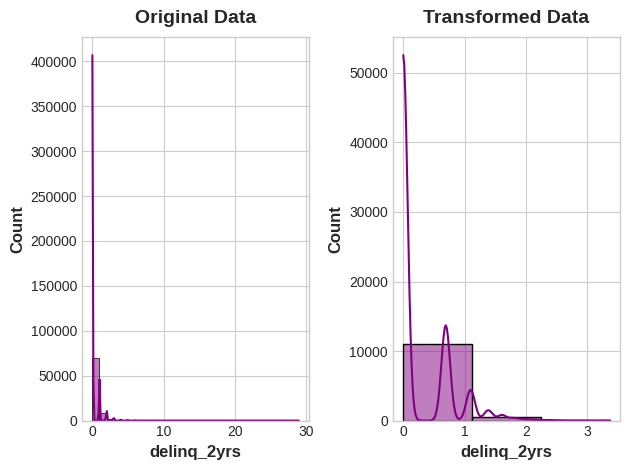

In [ ]:
orginal_data1 = data['delinq_2yrs']
data_log = np.log(data['delinq_2yrs'])
plot_transform(orginal_data1, data_log)

**Square Root Transformation**

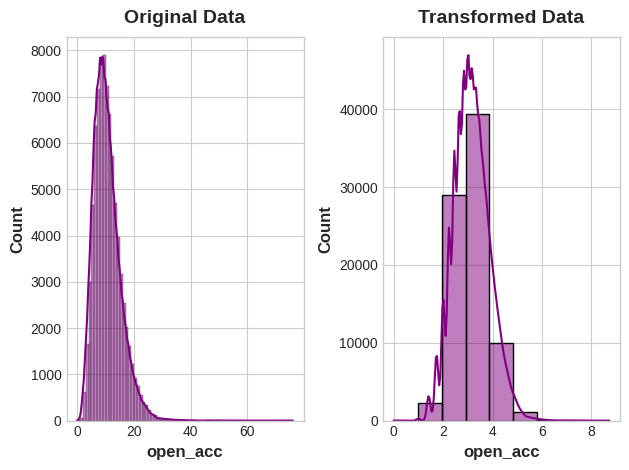

In [ ]:
orginal_data2 = data['open_acc']
data_sqrt = np.sqrt(data['open_acc'])
plot_transform(orginal_data2, data_sqrt)

**Cube Root Transformation**

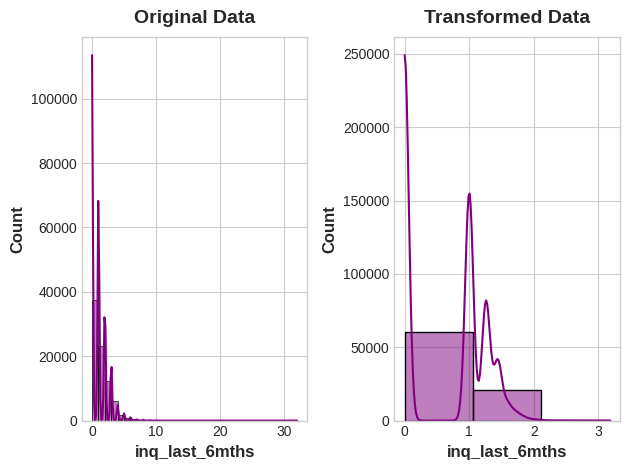

In [ ]:
orginal_data3 = data['inq_last_6mths']
data_cube = np.cbrt(data['inq_last_6mths'])
plot_transform(orginal_data3, data_cube)

**BoxCox Transformation**

Lambda value used for Transformation: 0.4637147423736547


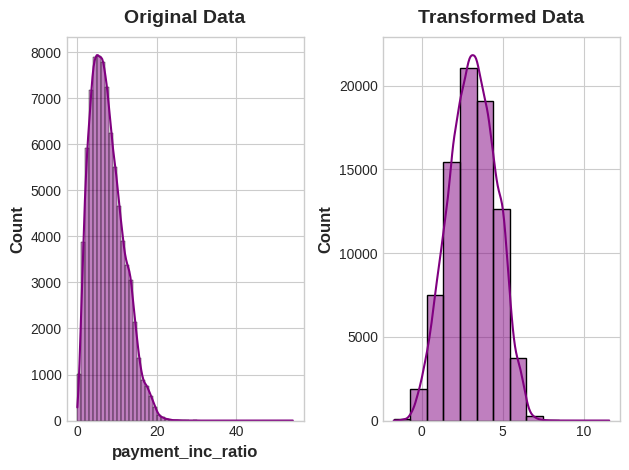

In [ ]:
orginal_data4 = data['payment_inc_ratio']
data_bc, fitted_lambda = stats.boxcox(data['payment_inc_ratio'])
print(f"Lambda value used for Transformation: {fitted_lambda}")
plot_transform(orginal_data4, data_bc)


#**Feature Selection**
**filter methods**

This section describes feature selection using filter methods on the preprocessed data. The variance threshold method was applied to numerical data, while chi-square, ANOVA, and mutual information were used on the entire processed data. It's important to remember that how the data is preprocessed can affect the results of these methods.

In [ ]:
data_copy = data.copy()
# y = X.pop("bad_loans")

In [ ]:
X = data.drop('bad_loans', axis=1)
y = data['bad_loans']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# encoder = ce.TargetEncoder(cols=X_train.select_dtypes(include=['object']).columns)
# X_train_encoded = encoder.fit_transform(X_train, y_train)
# X_test_encoded = encoder.transform(X_test)

In [ ]:
cat_encoded = [col for col in X.select_dtypes(include='category').columns if X[col].nunique() !=2]
num_features = X.select_dtypes(exclude='category').columns
print('categoriColumnsEncoded:', cat_encoded)
print('numericalFeatures:', num_features)

categoriColumnsEncoded: ['grade', 'sub_grade_num', 'home_ownership', 'purpose']
numericalFeatures: Index(['loan_amnt', 'emp_length_num', 'dti', 'payment_inc_ratio',
       'delinq_2yrs', 'inq_last_6mths', 'open_acc', 'pub_rec', 'revol_util'],
      dtype='object')


In [ ]:
#Creating a ColumnTransformer
column_transformer = ColumnTransformer(
    transformers=[
    ('numerical', PowerTransformer(method='yeo-johnson'),num_features),
    ('categorical', TargetEncoder(),cat_encoded),
],
  remainder='passthrough'
  )


# Train data preprocessing
X_train_preprocessed = column_transformer.fit_transform(X_train,y_train)

# Test data preprocessing
X_test_preprocessed = column_transformer.transform(X_test)



In [ ]:
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train_preprocessed)
X_test_scaled = scaler.transform(X_test_preprocessed)


In [ ]:
class_counts = data['bad_loans'].value_counts()
print(class_counts)

bad_loans
0    66266
1    15472
Name: count, dtype: int64


Original dataset shape: bad_loans
0    46366
1    10850
Name: count, dtype: int64
Resampled dataset shape: bad_loans
0    46366
1    46366
Name: count, dtype: int64


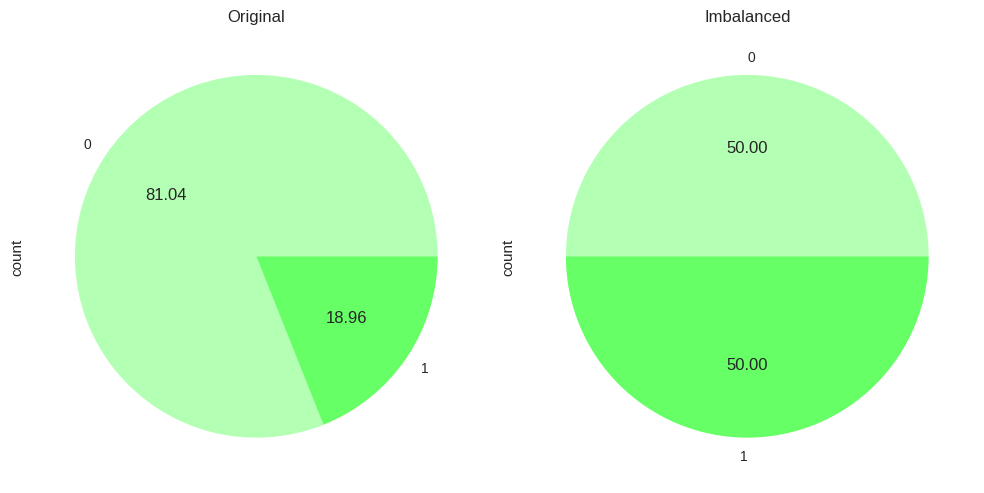

In [ ]:
# Using SMOTE to increase minority class samples in training data
smote = SMOTE(random_state=42)
X_train_res, y_train_res = smote.fit_resample(X_train_scaled, y_train)

# Display the number of samples before and after applying SMOTE
print("Original dataset shape:", y_train.value_counts())
print("Resampled dataset shape:", y_train_res.value_counts())

fig, axs = plt.subplots(ncols=2, figsize=(10, 5))
autopct = "%.2f"
# colors = ['#ff6666', '#ffcc99']
colors = ['#b3ffb3', '#66ff66']
y_train.value_counts().plot.pie(autopct=autopct, ax=axs[0] , colors=colors)
axs[0].set_title("Original")
y_train_res.value_counts().plot.pie(autopct=autopct, ax=axs[1], colors=colors)
axs[1].set_title("Imbalanced")
fig.tight_layout()



In [ ]:
XTrainPreprocessed_df = pd.DataFrame(X_train_res, columns=X_train.columns)
XTrainPreprocessed_df.head(3)

,loan_amnt,grade,sub_grade_num,short_emp,emp_length_num,home_ownership,dti,purpose,payment_inc_ratio,delinq_2yrs,delinq_2yrs_zero,inq_last_6mths,last_delinq_none,last_major_derog_none,open_acc,pub_rec,pub_rec_zero,revol_util
0,0.794598,0.608248,0.413407,0.308196,0.0,0.000000,0.495111,0.0,0.293847,0.201436,0.397632,0.004094,0.324384,0.0,1.0,1.0,1.0,1.0
1,0.558626,0.522162,0.526638,0.304721,0.0,0.397021,0.688540,0.0,0.049381,0.686725,0.727097,0.228196,0.319273,0.0,1.0,0.0,1.0,1.0
2,0.845008,0.691215,0.229101,0.485059,0.0,0.000000,0.336966,0.0,0.344105,0.201436,0.795490,0.004094,0.324384,0.0,1.0,1.0,1.0,1.0


Features with variance above the threshold:
             feature      variance
0          loan_amnt  6.310488e+07
1     emp_length_num  1.398736e+01
2                dti  5.619995e+01
3  payment_inc_ratio  1.700165e+01
4        delinq_2yrs  4.494759e-01
5     inq_last_6mths  1.607937e+00
6           open_acc  2.240509e+01
7            pub_rec  1.327053e-01
8         revol_util  6.645956e+02
Selected features after variance thresholding:
Index(['loan_amnt', 'emp_length_num', 'dti', 'payment_inc_ratio',
       'delinq_2yrs', 'inq_last_6mths', 'open_acc', 'pub_rec', 'revol_util'],
      dtype='object')


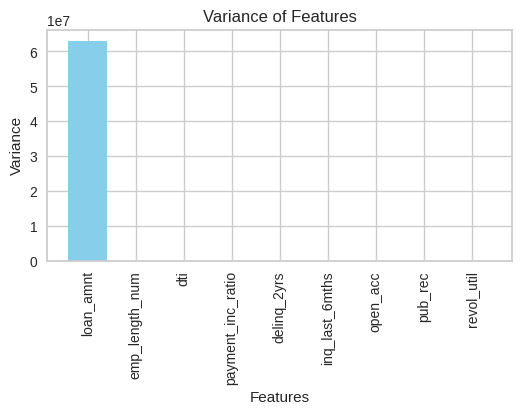

In [ ]:
# Filter data by numeric columns only
X_train_numerical = X_train[num_features]

# scaler = StandardScaler()
# X_train_scaled = scaler.fit_transform(X_train_numerical)

# Apply variance threshold to numerical features
threshold = 0.1
selector = VarianceThreshold(threshold=threshold)
X_train_var_thresh = selector.fit_transform(X_train_numerical)

# Get the selected properties
selected_features = X_train_numerical.columns[selector.get_support()]

# Create a DataFrame to display the features and their variance
variances = selector.variances_
feature_variances = pd.DataFrame({'feature': X_train_numerical.columns, 'variance': variances})

# Sort by variance and display features with variance above threshold
top_features = feature_variances[feature_variances['variance'] >= threshold]
print("Features with variance above the threshold:")
print(top_features)
print("Selected features after variance thresholding:")
print(selected_features)

plt.figure(figsize=(6, 3))
plt.bar(feature_variances['feature'], feature_variances['variance'], color='skyblue')
plt.xticks(rotation=90)
plt.xlabel('Features')
plt.ylabel('Variance')
plt.title('Variance of Features')
plt.show()



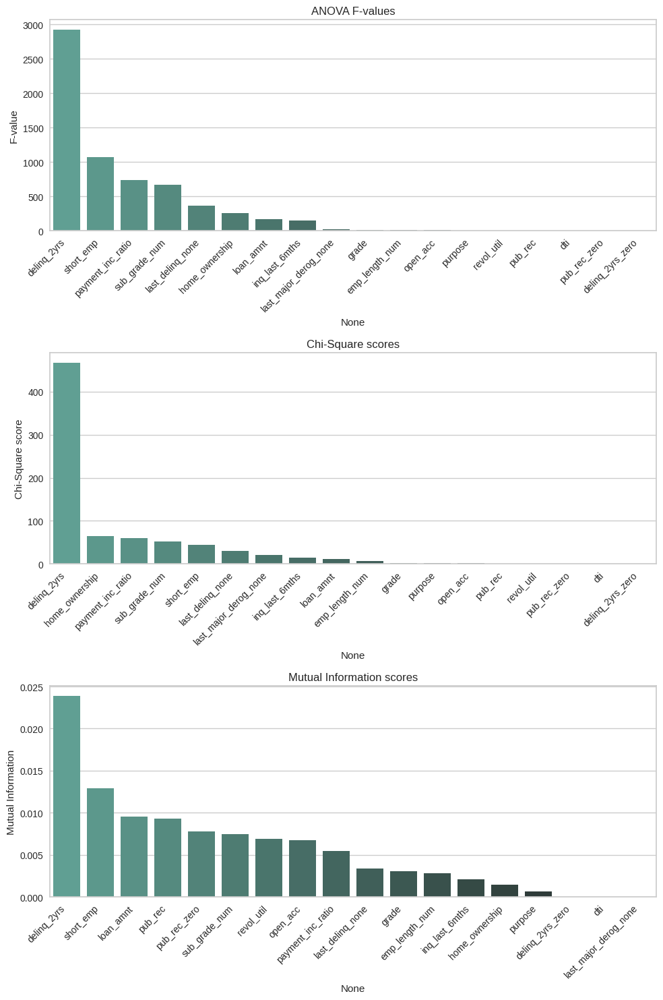

In [ ]:
def feature_selection_visualization(X_train, y_train):
    # Convert X_train to a DataFrame
#  = pd.DataFrame(X_train, columns=X.columns)

    # Compute ANOVA F-value and p-values
    f_values, p_values_f = f_classif(X_train, y_train)

    # Compute Chi-Square scores and p-values
    chi2_scores, p_values_chi2 = chi2(X_train, y_train)

    # Compute Mutual Information scores
    mutual_info_scores = mutual_info_classif(X_train, y_train)

    # Create subplots
    fig, axs = plt.subplots(3, 1, figsize=(10, 15))

    # Plot ANOVA F-values
    sorted_indices_f = np.argsort(f_values)[::-1]  # Sort feature indices based on F-values
    sns.barplot(x=X_train.columns[sorted_indices_f], y=np.sort(f_values)[::-1], ax=axs[0], palette="dark:#5A9_r")
    axs[0].set_title('ANOVA F-values')
    axs[0].set_ylabel('F-value')

    # Plot Chi-Square scores
    sorted_indices_chi2 = np.argsort(chi2_scores)[::-1]  # Sort feature indices based on Chi-Square scores
    sns.barplot(x=X_train.columns[sorted_indices_chi2], y=np.sort(chi2_scores)[::-1], ax=axs[1], palette="dark:#5A9_r")
    axs[1].set_title('Chi-Square scores')
    axs[1].set_ylabel('Chi-Square score')

    # Plot Mutual Information scores
    sorted_indices_mutual_info = np.argsort(mutual_info_scores)[::-1]  # Sort feature indices based on Mutual Information scores
    sns.barplot(x=X_train.columns[sorted_indices_mutual_info], y=np.sort(mutual_info_scores)[::-1], ax=axs[2], palette="dark:#5A9_r")
    axs[2].set_title('Mutual Information scores')
    axs[2].set_ylabel('Mutual Information')

    # Rotate x-axis labels for better readability
    for ax in axs:
        ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

    plt.tight_layout()
    plt.show()


feature_selection_visualization(XTrainPreprocessed_df, y_train)

**Chi-2 test for categorical data**

The make_chi_square_scores function computes the Chi-square scores and p-values for categorical features in dataset X for a target variable y.

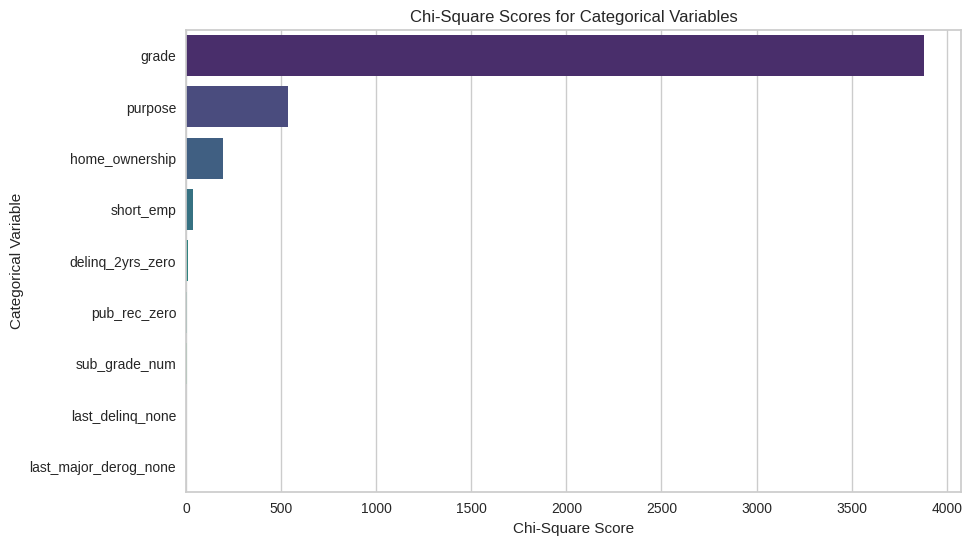

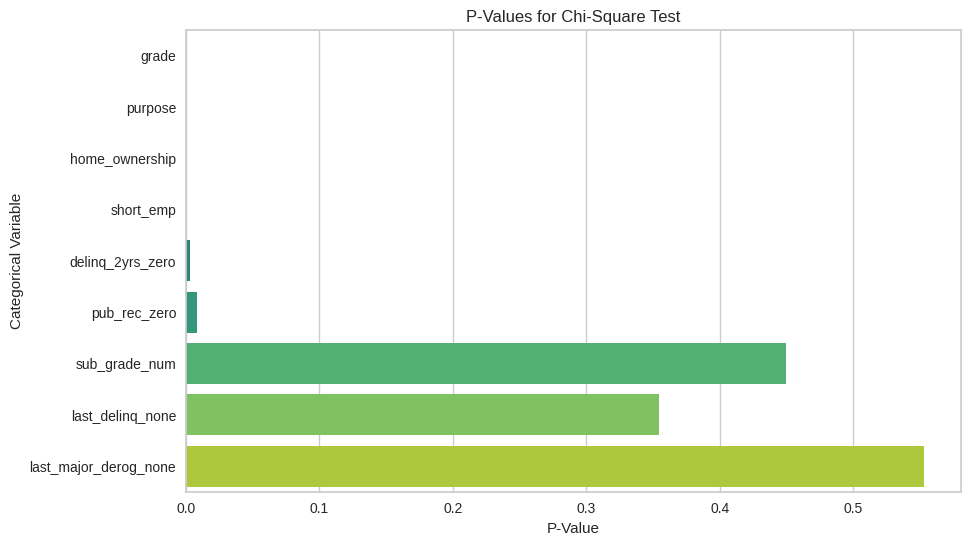

In [ ]:
def make_chi_square_scores(X, y):
    X= X.copy()
    chi2_scores = []
    p_values = []
    for colname in X.select_dtypes(["object", "category"]):
        contingency_table = pd.crosstab(X[colname], y)
        chi2, p, _, _ = stats.chi2_contingency(contingency_table)
        chi2_scores.append(chi2)
        p_values.append(p)
    chi2_scores = pd.Series(chi2_scores, name="Chi-Square Scores", index=X.select_dtypes(["object", "category"]).columns)
    p_values = pd.Series(p_values, name="P-Values", index=X.select_dtypes(["object", "category"]).columns)
    chi2_scores = chi2_scores.sort_values(ascending=False)
    p_values = p_values.reindex(chi2_scores.index)
    return chi2_scores, p_values


chi2_scores, p_values = make_chi_square_scores(X, y)
plt.figure(figsize=(10, 6))
sns.barplot(x=chi2_scores.values, y=chi2_scores.index, palette="viridis")
plt.title("Chi-Square Scores for Categorical Variables")
plt.xlabel("Chi-Square Score")
plt.ylabel("Categorical Variable")
plt.show()

# Plot p-values
plt.figure(figsize=(10, 6))
sns.barplot(x=p_values.values, y=p_values.index, palette="viridis")
plt.title("P-Values for Chi-Square Test")
plt.xlabel("P-Value")
plt.ylabel("Categorical Variable")
plt.show()

**Fisher’s Score**

In [ ]:
# from skfeature.function.similarity_based import fisher_score
# data_numpy = data_num.to_numpy()
# # X_encode_array = X_encode.values
# y_numpy = y.to_numpy()
# # calcutaing scores
# ranks = fisher_score.fisher_score(data_numpy, y_numpy)
# # plotting the ranks
# feat_importances = pd.Series(ranks, data.columns[0:len(data.columns)-1])
# feat_importances.plot(kind= 'barh', color= 'teal')
# plt.show

In [ ]:
from sklearn.feature_selection import permutation_importance

# Train a Random Forest model
model = RandomForestClassifier()
model.fit(X_train_preprocessed, y_train)

# Feature importance using permutation importance
perm_importance = permutation_importance(model, X_train_preprocessed, y_train)
feature_importances = perm_importance.scores_[0, :]

ImportError: cannot import name 'permutation_importance' from 'sklearn.feature_selection' (/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/__init__.py)

**SequentialFeatureSelector: Toggling between SFS, SBS, SFFS, and SBFS**


In this section, a function is defined so that by changing its parameters, we can see the sequential selection of features based on SFS, SBS, SFFS, and SBFS algorithms separately and find out which features are important in each algorithm.

**Sequential Forward Selection(SFS)**

Selected features: ('home_ownership', 'purpose', 'revol_util')
CV Score: 0.8105075503355704
Best combination (ACC: 0.811): (5, 7, 17)
All subsets: {1: {'feature_idx': (5,), 'cv_scores': array([0.8104726 , 0.81054251, 0.81019295, 0.8104726 ]), 'avg_score': 0.8104201621923938, 'feature_names': ('home_ownership',)}, 2: {'feature_idx': (5, 17), 'cv_scores': array([0.81075224, 0.81054251, 0.81026286, 0.81040268]), 'avg_score': 0.8104900727069351, 'feature_names': ('home_ownership', 'revol_util')}, 3: {'feature_idx': (5, 7, 17), 'cv_scores': array([0.81054251, 0.81068233, 0.81033277, 0.8104726 ]), 'avg_score': 0.8105075503355704, 'feature_names': ('home_ownership', 'purpose', 'revol_util')}}


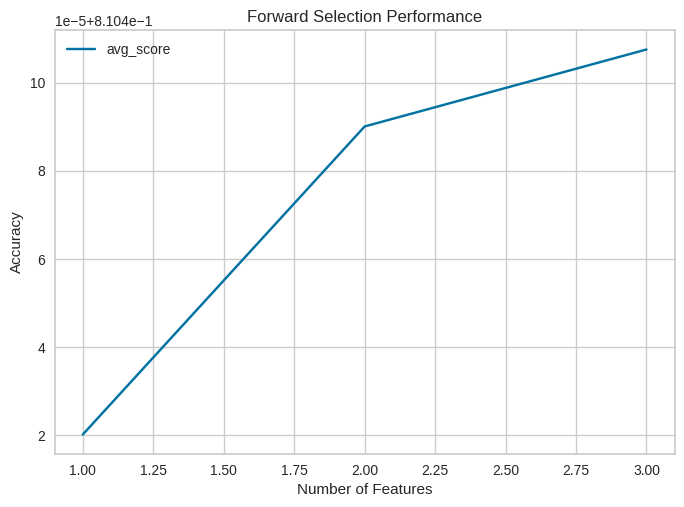

In [ ]:


def sequential_selection(estimator, X, y, k_features=3, forward=True, floating=False, scoring='accuracy', cv=4, n_jobs=-1):
    """
    Performs sequential feature selection using scikit-learn.

    Args:
        estimator: The machine learning model to use for evaluation.
        X (pandas.DataFrame): The data containing features.
        y (pandas.Series): The target variable.
        k_features (int): Number of features to select.
        forward (bool): Whether to perform forward selection.
        floating (bool): Whether to perform floating selection.
        scoring (str): The evaluation metric (e.g., 'accuracy', 'neg_mean_squared_error').
        cv (int): Number of folds for cross-validation.
        n_jobs (int): Number of parallel jobs.

    Returns:
        A tuple containing the SequentialFeatureSelector object and the DataFrame of metric scores.
    """

    # Create a SequentialFeatureSelector object
    selector = SequentialFeatureSelector(estimator=estimator,
                                         k_features=k_features,
                                         forward=forward,
                                         floating=floating,
                                         scoring=scoring,
                                         cv=cv,
                                         n_jobs=n_jobs)

    # Fit the selector to the data
    selector.fit(X, y)

    # Print selected features and other information
    print(f"Selected features: {selector.k_feature_names_}")
    print(f"CV Score: {selector.k_score_}")
    print(f'Best combination (ACC: {selector.k_score_:.3f}): {selector.k_feature_idx_}')
    print(f'All subsets: {selector.subsets_}')

    # Create DataFrame from selector's metric dictionary
    metric_dict = selector.get_metric_dict(confidence_interval=0.90)
    df_sequential_selection = pd.DataFrame.from_dict(metric_dict).T  # Transpose to get the correct orientation

    # Convert avg_score to float if it exists
    if 'avg_score' in df_sequential_selection.columns:
        df_sequential_selection["avg_score"] = df_sequential_selection["avg_score"].astype(float)
    else:
        print("Warning: 'avg_score' column not found in the metric dictionary")

    # Plotting if 'avg_score' column exists
    if 'avg_score' in df_sequential_selection.columns:
        fig, ax = plt.subplots()
        df_sequential_selection.plot(kind="line", y="avg_score", ax=ax)
        ax.set_xlabel("Number of Features")
        ax.set_ylabel("Accuracy")
        ax.set_title("Forward Selection Performance")
        plt.show()

    # Return the selector object and the DataFrame
    return selector, df_sequential_selection


selector1, df_sequential_selection1 = sequential_selection(estimator=RandomForestClassifier(),
                                                           X=XTrainPreprocessed_df, y=y_train_res,
                                                           k_features=3,
                                                           forward=True,
                                                           floating=False,
                                                           scoring='accuracy',
                                                           cv=4,
                                                           n_jobs=-1)


In [ ]:
df_sequential_selection1

,feature_idx,cv_scores,avg_score,feature_names,ci_bound,std_dev,std_err
1,"(5,)","[0.8104725950782998, 0.8105425055928411, 0.810...",0.810420,"(home_ownership,)",0.000165,0.000134,0.000078
2,"(5, 17)","[0.8107522371364653, 0.8105425055928411, 0.810...",0.810490,"(home_ownership, revol_util)",0.000223,0.000181,0.000104
3,"(5, 7, 17)","[0.8105425055928411, 0.810682326621924, 0.8103...",0.810508,"(home_ownership, purpose, revol_util)",0.000155,0.000126,0.000073


**Sequential Backward Selection(SBS)**

In [ ]:
selector2, df_sequential_selection2 = sequential_selection(estimator=RandomForestClassifier(),
                                                          X=XTrainPreprocessed_df, y=y_train_res,
                                                          k_features=3,
                                                          forward=False,
                                                          floating=False,
                                                          scoring='accuracy',
                                                          cv=4,
                                                          n_jobs=-1)
print(df_sequential_selection2)

**Sequential Forward Floating Selection(SFFS)**

In [ ]:
selector3, df_sequential_selection3 = sequential_selection(estimator=RandomForestClassifier(),
                                                          X=XTrainPreprocessed_df, y=y_train_res,
                                                          k_features=3,
                                                          forward=True,
                                                          floating=True,
                                                          scoring='accuracy',
                                                          cv=4,
                                                          n_jobs=-1)
from IPython.display import display
display(df_sequential_selection1)

NameError: name 'sequential_selection' is not defined

**Sequential Backward Floating Selection(SBFS)**

In [ ]:
selector4, df_sequential_selection4 = sequential_selection(estimator=RandomForestClassifier(),
                                                          X=XTrainPreprocessed_df, y=y_train_res,
                                                          k_features=3,
                                                          forward=False,
                                                          floating=True,
                                                          scoring='accuracy',
                                                          cv=4,
                                                          n_jobs=-1)
print(df_sequential_selection4)

ExhaustiveFeatureSelector: Optimal feature sets by considering all possible feature combinations





In [ ]:
knn = KNeighborsClassifier(n_neighbors=3)

efs1 = EFS(knn,
           min_features=1,
           max_features=3,
           scoring='accuracy',
           print_progress=True,
           cv=5)

efs1 = efs1.fit(X, y)

print('Best accuracy score: %.2f' % efs1.best_score_)
print('Best subset (indices):', efs1.best_idx_)
print('Best subset (corresponding names):', efs1.best_feature_names_)

In [ ]:
efs1.subsets_

In [ ]:
df = pd.DataFrame.from_dict(efs1.get_metric_dict()).T
df.sort_values('avg_score', inplace=True, ascending=False)
df

In [ ]:
metric_dict = efs1.get_metric_dict()

fig = plt.figure()
k_feat = sorted(metric_dict.keys())
avg = [metric_dict[k]['avg_score'] for k in k_feat]

upper, lower = [], []
for k in k_feat:
    upper.append(metric_dict[k]['avg_score'] +
                 metric_dict[k]['std_dev'])
    lower.append(metric_dict[k]['avg_score'] -
                 metric_dict[k]['std_dev'])

plt.fill_between(k_feat,
                 upper,
                 lower,
                 alpha=0.2,
                 color='blue',
                 lw=1)

plt.plot(k_feat, avg, color='blue', marker='o')
plt.ylabel('Accuracy +/- Standard Deviation')
plt.xlabel('Number of Features')
feature_min = len(metric_dict[k_feat[0]]['feature_idx'])
feature_max = len(metric_dict[k_feat[-1]]['feature_idx'])
plt.xticks(k_feat,
           [str(metric_dict[k]['feature_names']) for k in k_feat],
           rotation=90)
plt.show()


In [ ]:
from sklearn.model_selection import GridSearchCV
from boruta import BorutaPy
from sklearn.ensemble import RandomForestClassifier

# Define the Random Forest classifier
rf = RandomForestClassifier()

# Define the hyperparameter grid
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [3, 5, 10],
    'min_samples_split': [2, 5, 10],
    # Add other hyperparameters to tune
}

# Perform grid search with cross-validation
grid_search = GridSearchCV(rf, param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_encode, y)

# Get the best model from grid search
best_rf_model = grid_search.best_estimator_

# Fit Boruta with the tuned Random Forest model
boruta_selector = BorutaPy(best_rf_model, n_estimators='auto', verbose=2)
boruta_selector.fit(X_encode, y)

# Review results
print("Selected features:", boruta_selector.support_)
print("Ranking of features:", boruta_selector.ranking_)


KeyboardInterrupt: 

In [ ]:
# call transform() on X to filter it down to selected features
X_filtered = boruta_selector.transform(X_encode)

In [ ]:
# Instantiate a random forest classifier
rf = RandomForestClassifier(n_estimators=100, max_depth=5)

# Create a Boruta object
boruta_selector = BorutaPy(rf, n_estimators='auto', verbose=2)

# Fit Boruta to the data
boruta_selector.fit(X_encode, y)

# Review results
print("Selected features:", boruta_selector.support_)
print("Ranking of features:", boruta_selector.ranking_)

NameError: name 'RandomForestClassifier' is not defined

#**preprocessing**

In [ ]:
X = data.drop('bad_loans', axis=1)
y = data['bad_loans']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
cat_encoded = [col for col in X.select_dtypes(include='category').columns if X[col].nunique() !=2]
num_features = X.select_dtypes(exclude='category').columns
print('categoriColumnsEncoded:', cat_encoded)
print('numericalFeatures:', num_features)
#Creating a ColumnTransformer
column_transformer = ColumnTransformer(
    transformers=[
    ('numerical', PowerTransformer(method='yeo-johnson'),num_features),
    ('categorical', TargetEncoder(),cat_encoded),
],
  remainder='passthrough'
  )


# Train data preprocessing
X_train_preprocessed = column_transformer.fit_transform(X_train,y_train)

# Test data preprocessing
X_test_preprocessed = column_transformer.transform(X_test)

NameError: name 'train_test_split' is not defined

In [ ]:
feature_names = column_transformer.get_feature_names_out()
X_preprocessed_df = pd.DataFrame(X_train_preprocessed, columns=feature_names)
X_preprocessed_df.head(3)

,numerical__loan_amnt,numerical__emp_length_num,numerical__dti,numerical__payment_inc_ratio,numerical__delinq_2yrs,numerical__inq_last_6mths,numerical__open_acc,numerical__pub_rec,numerical__revol_util,categorical__grade,categorical__sub_grade_num,categorical__home_ownership,categorical__purpose,remainder__short_emp,remainder__delinq_2yrs_zero,remainder__last_delinq_none,remainder__last_major_derog_none,remainder__pub_rec_zero
0,1.055923,-0.026449,-0.238995,-0.243877,-0.405981,-1.029448,0.662273,-0.320673,-0.449841,0.145148,0.186320,0.169961,0.194465,0.0,1.0,1.0,1.0,1.0
1,-0.126717,-0.292950,0.359494,-0.273219,-0.405981,0.475155,2.682597,-0.320673,-1.862530,0.327692,0.192320,0.208684,0.194465,0.0,1.0,0.0,1.0,1.0
2,1.308568,0.230396,-1.213148,1.249398,-0.405981,-1.029448,-0.989520,-0.320673,-0.159416,0.146501,0.190435,0.169440,0.195613,0.0,1.0,1.0,1.0,1.0


In [ ]:
class_counts = y_train.value_counts()
print("Classes and their counts in y_train:")
print(class_counts)

Classes and their counts in y_train:
bad_loans
0    46366
1    10850
Name: count, dtype: int64


In [ ]:
# Data resampling

# smote = SMOTE(sampling_strategy='auto', random_state=42)
# X_train_resampled, y_train_resampled = smote.fit_resample(X_train_preprocessed, y_train)
adasyn = ADASYN(random_state=42)
X_train_resampled, y_train_resampled = adasyn.fit_resample(X_train_preprocessed, y_train)


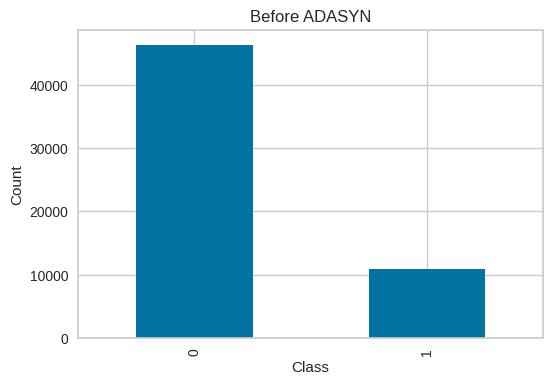

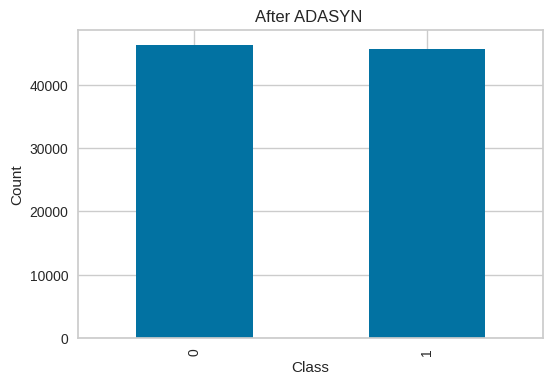

In [ ]:
# Visualization of data before and after ADASYN
def plot_distribution(y, title):
    plt.figure(figsize=(6, 4))
    pd.Series(y).value_counts().plot(kind='bar', title=title)
    plt.xlabel('Class')
    plt.ylabel('Count')
    plt.show()

plot_distribution(y_train, 'Before ADASYN')
plot_distribution(y_train_resampled, 'After ADASYN ')

In [ ]:
class_counts_resampled = y_train_resampled.value_counts()
print("Classes and their counts in y_train_resampled:")
print(class_counts_resampled)

Classes and their counts in y_train_resampled:
bad_loans
0    46366
1    45633
Name: count, dtype: int64


In [ ]:
print("Number of samples in X_train_preprocessed:", X_train_preprocessed.shape[0])
print("Number of samples in y_train:", len(y_train))
print("Number of samples in X_train_resampled:", X_train_resampled.shape[0])
print("Number of samples in y_train_resampled:", len(y_train_resampled))
print("Number of sample in X_test_preprossed", X_test_preprocessed.shape[0])
print("number of sample in y_test" , len(y_test))

Number of samples in X_train_preprocessed: 57216
Number of samples in y_train: 57216
Number of samples in X_train_resampled: 91999
Number of samples in y_train_resampled: 91999
Number of sample in X_test_preprossed 24522
number of sample in y_test 24522


In [ ]:

def evaluate_and_plot(model, X, y, dataset_name='Train'):
    # Prediction for data
    y_pred = model.predict(X)
    y_pred_proba = model.predict_proba(X)[:, 1]

    # Calculation of criteria
    accuracy = accuracy_score(y, y_pred)
    precision = precision_score(y, y_pred)
    recall = recall_score(y, y_pred)
    f1 = f1_score(y, y_pred)
    roc_auc = roc_auc_score(y, y_pred_proba)

    # Print metrics
    print(f"\n{dataset_name} Metrics:")
    print(f"Accuracy: {accuracy:.2f}")
    print(f"Precision: {precision:.2f}")
    print(f"Recall: {recall:.2f}")
    print(f"F1 Score: {f1:.2f}")
    print(f"ROC AUC: {roc_auc:.2f}")

    # Draw different plots in a 2x2 grid
    fig, axes = plt.subplots(2, 2, figsize=(14, 10))

    # Bar charts for metrics
    metrics = ['Accuracy', 'Precision', 'Recall', 'F1 Score', 'ROC AUC']
    values = [accuracy, precision, recall, f1, roc_auc]
    axes[0, 0].bar(metrics, values, color=['plum', 'violet', 'purple', 'mediumorchid', 'orchid'])
    axes[0, 0].set_title(f'{dataset_name} Metrics')
    axes[0, 0].set_ylim(0, 1)
    axes[0, 0].set_ylabel('Score')

    # ROC Curve chart
    fpr, tpr, _ = roc_curve(y, y_pred_proba)
    axes[0, 1].plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
    axes[0, 1].plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    axes[0, 1].set_xlim([0.0, 1.0])
    axes[0, 1].set_ylim([0.0, 1.05])
    axes[0, 1].set_xlabel('False Positive Rate')
    axes[0, 1].set_ylabel('True Positive Rate')
    axes[0, 1].set_title(f'{dataset_name} ROC Curve')
    axes[0, 1].legend(loc="lower right")

   # Classification report chart
    report = classification_report(y, y_pred, output_dict=True)
    df_report = pd.DataFrame(report).transpose()
    sns.heatmap(df_report.iloc[:-1, :-1].T, annot=True, cmap='coolwarm', ax=axes[1, 0])
    axes[1, 0].set_title(f'{dataset_name} Classification Report')

    # Draw the Confusion Matrix
    ConfusionMatrixDisplay.from_predictions(y, y_pred, ax=axes[1, 1], cmap='cool')
    axes[1, 1].set_title(f'{dataset_name} Confusion Matrix')

    plt.tight_layout()
    plt.show()

#**Model-1: RandomForest**


In [ ]:

rkf = RepeatedKFold(n_splits=5, n_repeats=10, random_state=42)



pipeline = Pipeline(steps=[
    ('scaler', StandardScaler()),
    ('feature_selection', RFE(estimator=DecisionTreeClassifier(random_state=42), n_features_to_select=10)),  # انتخاب ویژگی‌ها با درخت تصمیم
    ('clf', RandomForestClassifier(n_estimators=100, random_state=42, max_depth=4, criterion='entropy'))  # مدل جنگل تصادفی
])


cross_val_metrics_rf = {'accuracy': [], 'precision': [], 'recall': [], 'f1': [], 'roc_auc': []}

for train_index, val_index in rkf.split(X_train_resampled, y_train_resampled):
    X_train_fold, X_val_fold = X_train_resampled[train_index], X_train_resampled[val_index]
    y_train_fold, y_val_fold = y_train_resampled[train_index], y_train_resampled[val_index]

    pipeline.fit(X_train_fold, y_train_fold)
    y_val_pred = pipeline.predict(X_val_fold)
    y_val_pred_proba = pipeline.predict_proba(X_val_fold)[:, 1]

    cross_val_metrics_rf['accuracy'].append(accuracy_score(y_val_fold, y_val_pred))
    cross_val_metrics_rf['precision'].append(precision_score(y_val_fold, y_val_pred))
    cross_val_metrics_rf['recall'].append(recall_score(y_val_fold, y_val_pred))
    cross_val_metrics_rf['f1'].append(f1_score(y_val_fold, y_val_pred))
    cross_val_metrics_rf['roc_auc'].append(roc_auc_score(y_val_fold, y_val_pred_proba))

mean_cross_val_metrics_rf = {metric: np.mean(values) for metric, values in cross_val_metrics_rf.items()}

print("\nCross-Validation Metrics for Random Forest:")
for metric, value in mean_cross_val_metrics_rf.items():
    print(f"{metric.capitalize()}: {value:.2f}")


Cross-Validation Metrics for Random Forest:
Accuracy: 0.74
Precision: 0.72
Recall: 0.77
F1: 0.75
Roc_auc: 0.84



Test Metrics:
Accuracy: 0.66
Precision: 0.28
Recall: 0.52
F1 Score: 0.36
ROC AUC: 0.65


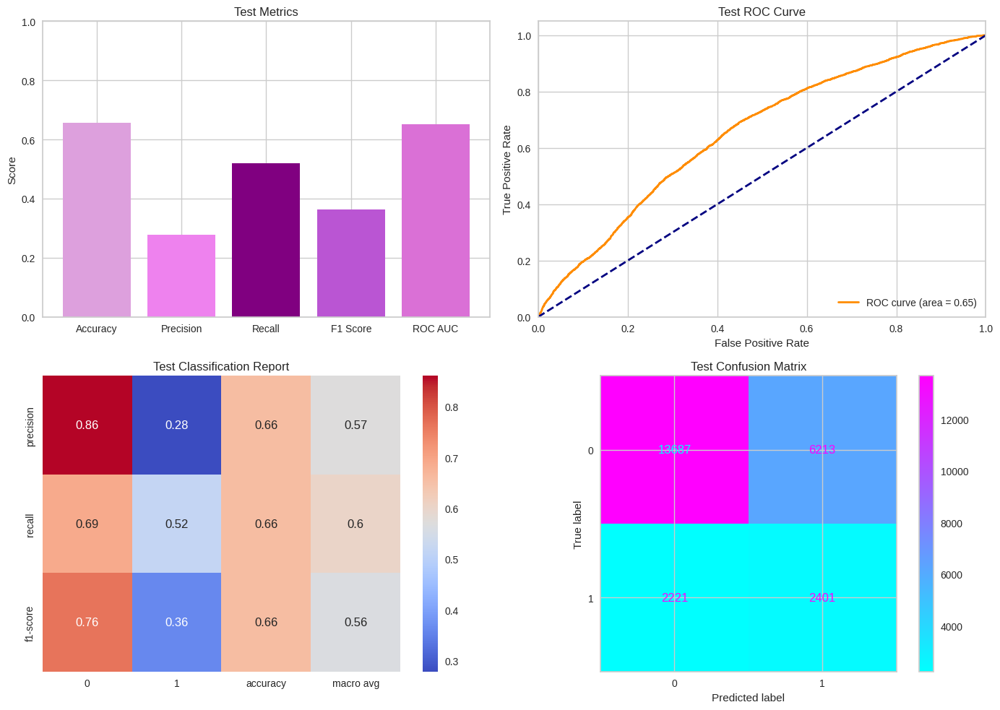

In [ ]:
evaluate_and_plot(pipeline, X_test_preprocessed, y_test, dataset_name='Test')

In [ ]:
# Definition of StratifiedK-Fold Cross Validator
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)


pipeline = Pipeline(steps=[
    ('scaler', StandardScaler()),                     # Normalization stage
    ('feature_selection', PCA()),                     # Dimension reduction step
    ('clf', RandomForestClassifier(random_state=42))  # Model step
])



# Define the search space for model parameters
param_dist = {
    'clf__bootstrap': [True],
    'clf__max_features': randint(2, 4),
    'clf__n_estimators': randint(30, 80),
    'clf__max_depth': randint(5, 11),
    'clf__min_samples_split': randint(2, 11),
    'clf__min_samples_leaf': randint(1, 7)
}

# Random search using cross validation
random_search = RandomizedSearchCV(estimator=pipeline, param_distributions=param_dist,
                                   cv=skf, scoring='f1', verbose=2, n_jobs=-1, random_state=42, n_iter=50)

# Run a random search
random_search.fit(X_train_resampled, y_train_resampled)

# Print the best parameters
best_params = random_search.best_params_
print("Best parameters found:", best_params)

# Model training with the best parameters
best_model_rf = random_search.best_estimator_

cross_val_metrics_rf = {'accuracy': [], 'precision': [], 'recall': [], 'f1': [], 'roc_auc': []}

for train_index, val_index in skf.split(X_train_resampled, y_train_resampled):
    X_train_fold, X_val_fold = X_train_resampled[train_index], X_train_resampled[val_index]
    y_train_fold, y_val_fold = y_train_resampled[train_index], y_train_resampled[val_index]

    best_model_rf.fit(X_train_fold, y_train_fold)
    y_val_pred = best_model_rf.predict(X_val_fold)
    y_val_pred_proba = best_model_rf.predict_proba(X_val_fold)[:, 1]

    cross_val_metrics_rf['accuracy'].append(accuracy_score(y_val_fold, y_val_pred))
    cross_val_metrics_rf['precision'].append(precision_score(y_val_fold, y_val_pred))
    cross_val_metrics_rf['recall'].append(recall_score(y_val_fold, y_val_pred))
    cross_val_metrics_rf['f1'].append(f1_score(y_val_fold, y_val_pred))
    cross_val_metrics_rf['roc_auc'].append(roc_auc_score(y_val_fold, y_val_pred_proba))

mean_cross_val_metrics_rf = {metric: np.mean(values) for metric, values in cross_val_metrics_rf.items()}

print("\nCross-Validation Metrics for Logistic Regression:")
for metric, value in mean_cross_val_metrics_rf.items():
    print(f"{metric.capitalize()}: {value:.2f}")


Fitting 5 folds for each of 50 candidates, totalling 250 fits
Best parameters found: {'clf__bootstrap': True, 'clf__max_depth': 10, 'clf__max_features': 3, 'clf__min_samples_leaf': 5, 'clf__min_samples_split': 4, 'clf__n_estimators': 73}

Cross-Validation Metrics for Logistic Regression:
Accuracy: 0.69
Precision: 0.68
Recall: 0.72
F1: 0.70
Roc_auc: 0.76



Test Metrics:
Accuracy: 0.64
Precision: 0.28
Recall: 0.59
F1 Score: 0.38
ROC AUC: 0.67


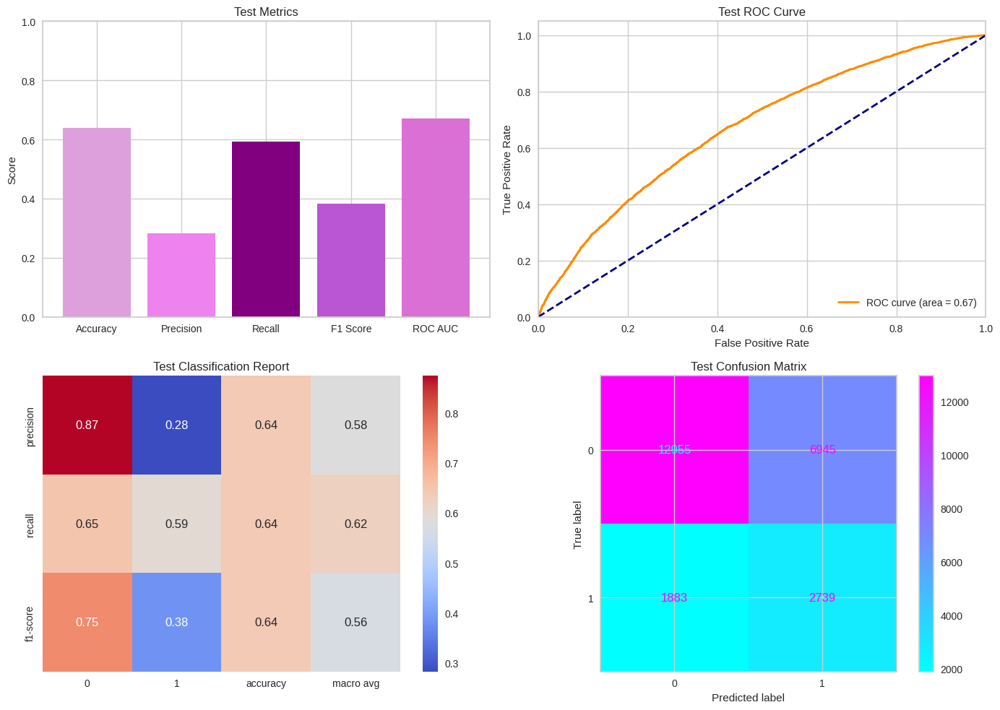

In [ ]:
evaluate_and_plot(best_model_rf, X_test_preprocessed, y_test, dataset_name='Test')


Test Metrics:
Accuracy: 0.68
Precision: 0.30
Recall: 0.52
F1 Score: 0.38
ROC AUC: 0.67


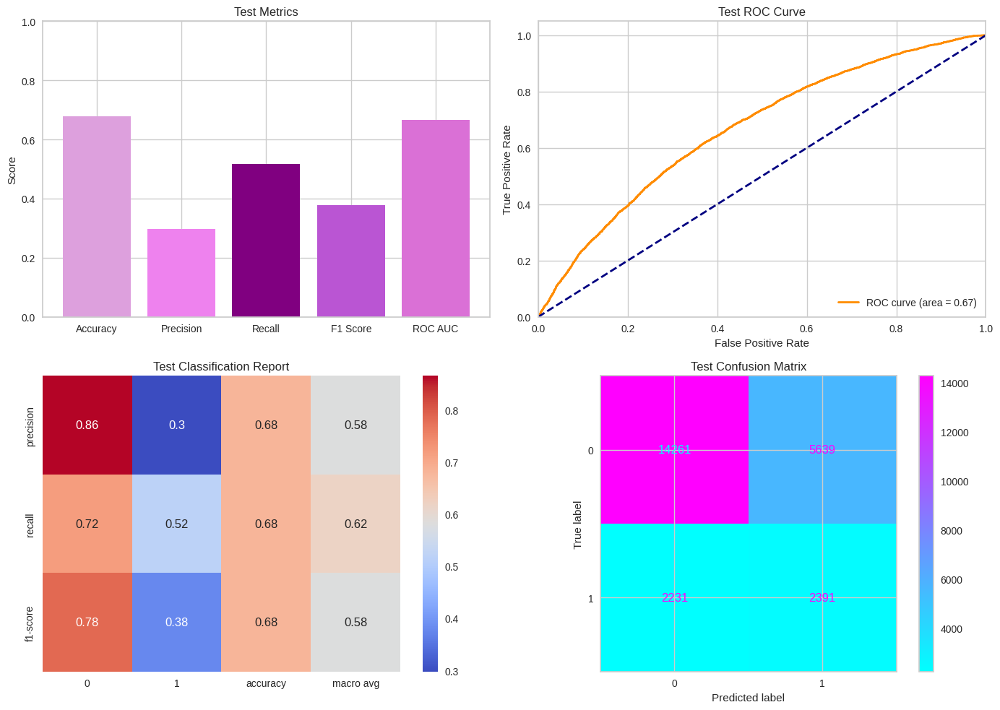

In [ ]:
evaluate_and_plot(best_model_rf, X_test_preprocessed, y_test, dataset_name='Test')

#**Model-2: LogisticRegression**


In [ ]:
# Pipeline definition
pipeline = Pipeline([
    ('scaler', StandardScaler()),           # Normalization stage
    ('clf', LogisticRegression(max_iter=1000, random_state=42,C= 0.01)) # Model step
])

# Define the search space of hyperparameters
param_grid = {
    'clf__C': [0.001, 0.01, 0.1, 1, 10],
    # 'clf__max_iter': [1000, 5000, 10000],
    'clf__solver': ['newton-cg', 'lbfgs', 'sag', 'saga']
}



skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
grid_search = GridSearchCV(estimator=pipeline, param_grid=param_grid, cv=skf, scoring='accuracy')



# Run Grid Search
grid_search.fit(X_train_resampled, y_train_resampled)

# Print the best parameters
best_params = grid_search.best_params_
print("Best parameters found:", best_params)

# Model training with the best parameters
best_model_lr = grid_search.best_estimator_

# Cross-validation with the best model
cross_val_metrics_lr = {'accuracy': [], 'precision': [], 'recall': [], 'f1': [], 'roc_auc': []}

for train_index, val_index in skf.split(X_train_resampled, y_train_resampled):
    X_train_fold, X_val_fold = X_train_resampled[train_index], X_train_resampled[val_index]
    y_train_fold, y_val_fold = y_train_resampled[train_index], y_train_resampled[val_index]

    best_model_lr.fit(X_train_fold, y_train_fold)
    y_val_pred = best_model_lr.predict(X_val_fold)
    y_val_pred_proba = best_model_lr.predict_proba(X_val_fold)[:, 1]

    cross_val_metrics_lr['accuracy'].append(accuracy_score(y_val_fold, y_val_pred))
    cross_val_metrics_lr['precision'].append(precision_score(y_val_fold, y_val_pred))
    cross_val_metrics_lr['recall'].append(recall_score(y_val_fold, y_val_pred))
    cross_val_metrics_lr['f1'].append(f1_score(y_val_fold, y_val_pred))
    cross_val_metrics_lr['roc_auc'].append(roc_auc_score(y_val_fold, y_val_pred_proba))

mean_cross_val_metrics_lr = {metric: np.mean(values) for metric, values in cross_val_metrics_lr.items()}

print("\nCross-Validation Metrics for Logistic Regression:")
for metric, value in mean_cross_val_metrics_lr.items():
    print(f"{metric.capitalize()}: {value:.2f}")




Best parameters found: {'clf__C': 10, 'clf__solver': 'sag'}

Cross-Validation Metrics for Logistic Regression:
Accuracy: 0.64
Precision: 0.64
Recall: 0.63
F1: 0.63
Roc_auc: 0.69



Test Metrics:
Accuracy: 0.64
Precision: 0.29
Recall: 0.62
F1 Score: 0.39
ROC AUC: 0.68


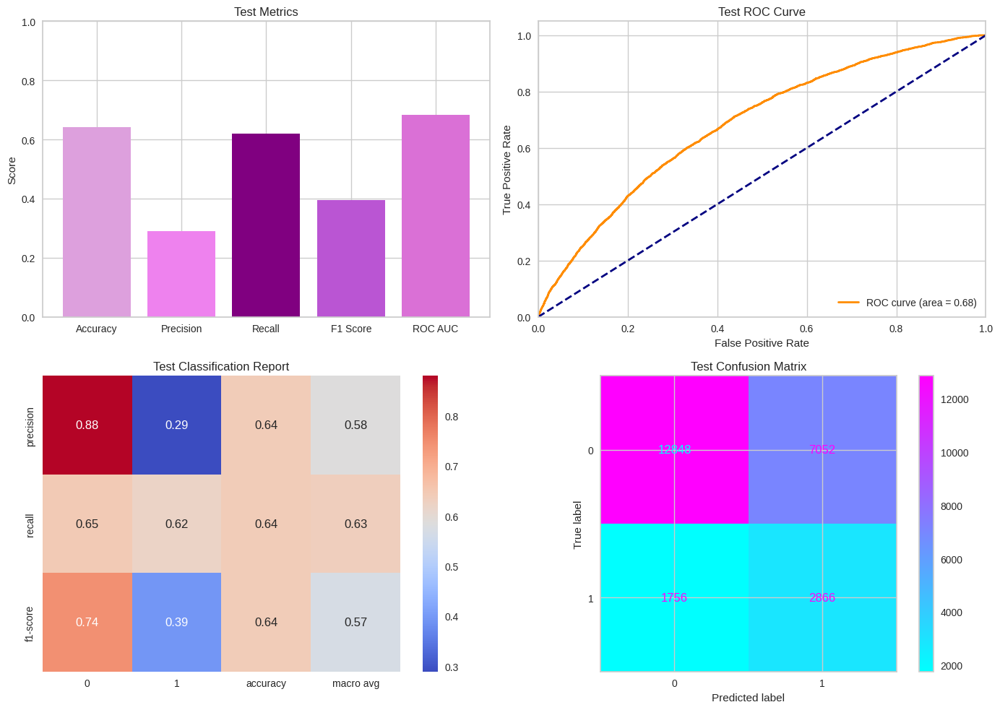

In [ ]:
evaluate_and_plot(best_model_lr, X_test_preprocessed, y_test, dataset_name='Test')

In [ ]:
# Define the pipeline
pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('clf', LogisticRegression(random_state=42, solver='saga', C=0.1, max_iter=10000))
])

# Define the parameter grid
param_grid = {
    'clf__penalty': ['l1', 'l2', 'elasticnet']


}


grid_search_lr = GridSearchCV(estimator=pipeline, param_grid=param_grid,
                              cv=skf, scoring='f1', verbose=2, n_jobs=-1)


grid_search_lr.fit(X_train_resampled, y_train_resampled)


best_params_lr = grid_search_lr.best_params_
print("Best parameters found for Logistic Regression:", best_params_lr)


best_model_lr = grid_search_lr.best_estimator_


cross_val_metrics_lr = {'accuracy': [], 'precision': [], 'recall': [], 'f1': [], 'roc_auc': []}

for train_index, val_index in skf.split(X_train_resampled, y_train_resampled):
    X_train_fold, X_val_fold = X_train_resampled[train_index], X_train_resampled[val_index]
    y_train_fold, y_val_fold = y_train_resampled[train_index], y_train_resampled[val_index]

    best_model_lr.fit(X_train_fold, y_train_fold)
    y_val_pred = best_model_lr.predict(X_val_fold)
    y_val_pred_proba = best_model_lr.predict_proba(X_val_fold)[:, 1]

    cross_val_metrics_lr['accuracy'].append(accuracy_score(y_val_fold, y_val_pred))
    cross_val_metrics_lr['precision'].append(precision_score(y_val_fold, y_val_pred))
    cross_val_metrics_lr['recall'].append(recall_score(y_val_fold, y_val_pred))
    cross_val_metrics_lr['f1'].append(f1_score(y_val_fold, y_val_pred))
    cross_val_metrics_lr['roc_auc'].append(roc_auc_score(y_val_fold, y_val_pred_proba))

mean_cross_val_metrics_lr = {metric: np.mean(values) for metric, values in cross_val_metrics_lr.items()}

print("\nCross-Validation Metrics for Logistic Regression:")
for metric, value in mean_cross_val_metrics_lr.items():
    print(f"{metric.capitalize()}: {value:.2f}")

Fitting 5 folds for each of 3 candidates, totalling 15 fits
Best parameters found for Logistic Regression: {'clf__penalty': 'l2'}

Cross-Validation Metrics for Logistic Regression:
Accuracy: 0.64
Precision: 0.64
Recall: 0.63
F1: 0.63
Roc_auc: 0.69



Test Metrics:
Accuracy: 0.64
Precision: 0.29
Recall: 0.62
F1 Score: 0.39
ROC AUC: 0.68


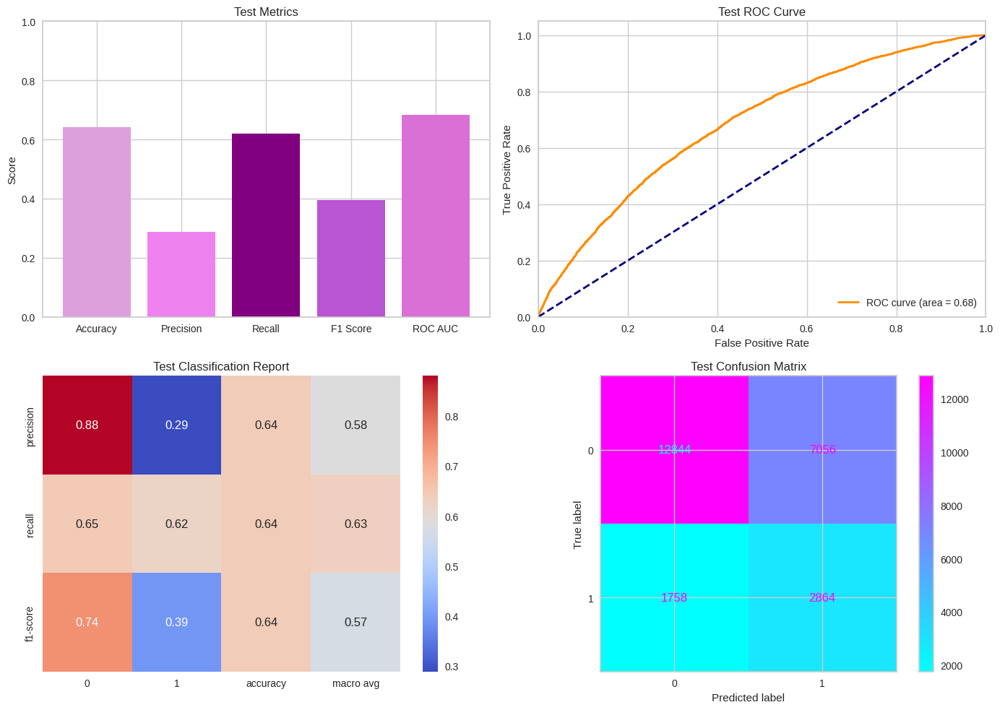

In [ ]:
evaluate_and_plot(best_model_lr, X_test_preprocessed, y_test, dataset_name='Test')

#**Model-3: XGBOOST**

In [ ]:
eval_set = [(X_train_resampled, y_train_resampled), (X_test_preprocessed, y_test)]
eval_metric = ["logloss","auc"]
model_xgb = XGBClassifier(silent=False,
                      scale_pos_weight=1,
                      learning_rate=0.01,
                      colsample_bytree = 0.4,
                      subsample = 0.8,
                      objective='binary:logistic',
                      n_estimators=150,
                      reg_alpha = 2,
                      max_depth=4,
                      gamma=10)

%time model_xgb.fit(X_train_resampled, y_train_resampled,eval_metric=eval_metric, eval_set=eval_set, early_stopping_rounds=10, verbose=True)

[0]	validation_0-logloss:0.69053	validation_0-auc:0.76307	validation_1-logloss:0.68663	validation_1-auc:0.54633
[1]	validation_0-logloss:0.68803	validation_0-auc:0.76446	validation_1-logloss:0.68507	validation_1-auc:0.54761
[2]	validation_0-logloss:0.68623	validation_0-auc:0.78502	validation_1-logloss:0.68459	validation_1-auc:0.55198
[3]	validation_0-logloss:0.68447	validation_0-auc:0.79314	validation_1-logloss:0.68358	validation_1-auc:0.56744
[4]	validation_0-logloss:0.68359	validation_0-auc:0.81377	validation_1-logloss:0.68291	validation_1-auc:0.59354
[5]	validation_0-logloss:0.68185	validation_0-auc:0.81120	validation_1-logloss:0.68245	validation_1-auc:0.58998
[6]	validation_0-logloss:0.67878	validation_0-auc:0.85538	validation_1-logloss:0.68024	validation_1-auc:0.62459
[7]	validation_0-logloss:0.67660	validation_0-auc:0.86028	validation_1-logloss:0.67913	validation_1-auc:0.62517
[8]	validation_0-logloss:0.67361	validation_0-auc:0.87358	validation_1-logloss:0.67698	validation_1-auc:

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.4, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=10, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.01, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=4, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=150, n_jobs=None,
              num_parallel_tree=None, random_state=None, ...)


Test Metrics:
Accuracy: 0.74
Precision: 0.31
Recall: 0.30
F1 Score: 0.30
ROC AUC: 0.65


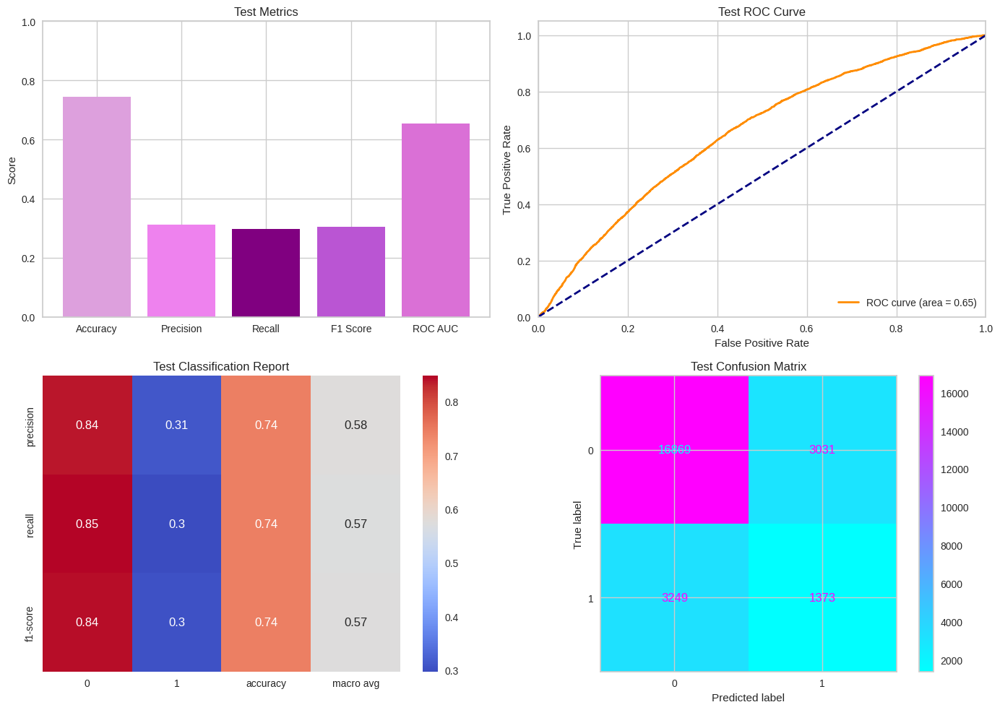

In [ ]:
evaluate_and_plot(model_xgb, X_test_preprocessed, y_test, dataset_name='Test')

In [ ]:
# Definition of K-Fold Cross Validator
kf = KFold(n_splits=5, shuffle=True, random_state=42)

pipeline = Pipeline(steps=[
    ('scaler', StandardScaler()),
    ('clf', XGBClassifier(random_state=42, use_label_encoder=False, eval_metric='logloss'))
])

# Defining the search space of hyperparameters with Optuna
param_distributions = {

    'clf__n_estimators': optuna.distributions.IntDistribution(20, 50),
    'clf__max_depth': optuna.distributions.IntDistribution(3, 5),
    # 'clf__learning_rate': optuna.distributions.FloatDistribution(0.01, 0.3),
    # 'clf__subsample': optuna.distributions.FloatDistribution(0.5, 1.0),
    # 'clf__colsample_bytree': optuna.distributions.FloatDistribution(0.5, 1.0),
    'clf__alpha': optuna.distributions.FloatDistribution(0.01, 10.0)
}





# Define OptunaSearchCV using Cross Validation
optuna_search = OptunaSearchCV(estimator=pipeline, param_distributions=param_distributions,
                               cv=kf, scoring='balanced_accuracy', n_jobs=-1, n_trials=100, random_state=42, verbose=2)

# Run Optuna Search
optuna_search.fit(X_train_resampled, y_train_resampled)


best_params = optuna_search.best_params_
print("Best parameters found:", best_params)

best_model_xgb = optuna_search.best_estimator_

cross_val_metrics_xgb = {'accuracy': [], 'precision': [], 'recall': [], 'f1': [], 'roc_auc': []}

for train_index, val_index in kf.split(X_train_resampled):
    X_train_fold, X_val_fold = X_train_resampled[train_index], X_train_resampled[val_index]
    y_train_fold, y_val_fold = y_train_resampled[train_index], y_train_resampled[val_index]

    best_model_xgb.fit(X_train_fold, y_train_fold)
    y_val_pred = best_model_xgb.predict(X_val_fold)
    y_val_pred_proba = best_model_xgb.predict_proba(X_val_fold)[:, 1]

    cross_val_metrics_xgb['accuracy'].append(accuracy_score(y_val_fold, y_val_pred))
    cross_val_metrics_xgb['precision'].append(precision_score(y_val_fold, y_val_pred))
    cross_val_metrics_xgb['recall'].append(recall_score(y_val_fold, y_val_pred))
    cross_val_metrics_xgb['f1'].append(f1_score(y_val_fold, y_val_pred))
    cross_val_metrics_xgb['roc_auc'].append(roc_auc_score(y_val_fold, y_val_pred_proba))

mean_cross_val_metrics_xgb = {metric: np.mean(values) for metric, values in cross_val_metrics_xgb.items()}

print("\nCross-Validation Metrics for XGBoost:")
for metric, value in mean_cross_val_metrics_xgb.items():
    print(f"{metric.capitalize()}: {value:.2f}")



[I 2024-05-30 16:40:23,033] A new study created in memory with name: no-name-a1b7e2c0-f66c-4f01-9766-3c0fbb117551
INFO:optuna_integration.sklearn:Searching the best hyperparameters using 92000 samples...
[I 2024-05-30 16:40:31,549] Trial 0 finished with value: 0.8655160123783681 and parameters: {'clf__n_estimators': 32, 'clf__max_depth': 5, 'clf__alpha': 8.852233031101289}. Best is trial 0 with value: 0.8655160123783681.
[I 2024-05-30 16:40:32,421] Trial 1 finished with value: 0.869952744470973 and parameters: {'clf__n_estimators': 40, 'clf__max_depth': 5, 'clf__alpha': 2.234887466417565}. Best is trial 1 with value: 0.869952744470973.
[I 2024-05-30 16:40:36,353] Trial 2 finished with value: 0.8508009916078372 and parameters: {'clf__n_estimators': 35, 'clf__max_depth': 3, 'clf__alpha': 4.958788816028507}. Best is trial 1 with value: 0.869952744470973.
[I 2024-05-30 16:40:38,224] Trial 3 finished with value: 0.8652067938157263 and parameters: {'clf__n_estimators': 41, 'clf__max_depth': 

Best parameters found: {'clf__n_estimators': 49, 'clf__max_depth': 5, 'clf__alpha': 0.7660995194712559}

Cross-Validation Metrics for XGBoost:
Accuracy: 0.87
Precision: 0.97
Recall: 0.77
F1: 0.86
Roc_auc: 0.92



Test Metrics:
Accuracy: 0.27
Precision: 0.20
Recall: 0.96
F1 Score: 0.33
ROC AUC: 0.63


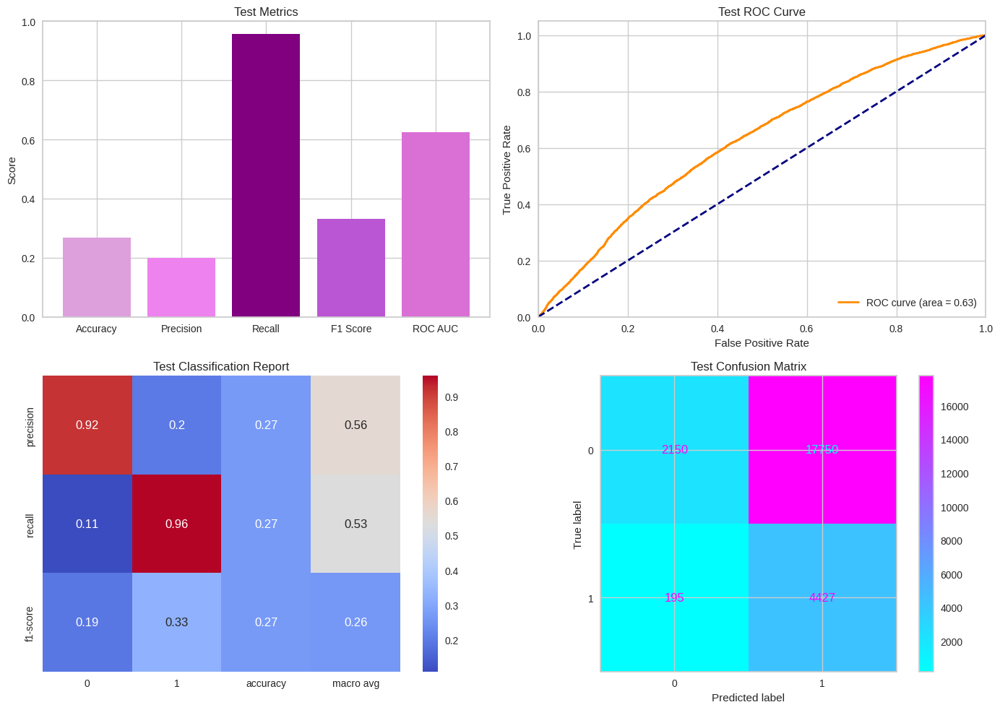

In [ ]:
evaluate_and_plot(best_model_xgb, X_test_preprocessed, y_test, dataset_name='Test')

#**Model-4: Voting**

In [ ]:

# Definition of basic models
rf_model = RandomForestClassifier(n_estimators=200, random_state=42)
gb_model = GradientBoostingClassifier(learning_rate=0.1, random_state=42)
lr_model = LogisticRegression(penalty='l2',random_state=42, max_iter=10000)


voting_model = VotingClassifier(
    estimators=[('rf', rf_model), ('gb', gb_model), ('lr', lr_model)],
    voting='soft'
)


pipeline = Pipeline(steps=[
    ('scaler', StandardScaler()),
    ('voting', voting_model)
])

%time pipeline.fit(X_train_resampled, y_train_resampled)

CPU times: user 1min 52s, sys: 270 ms, total: 1min 52s
Wall time: 1min 56s


Pipeline(steps=[('scaler', StandardScaler()),
                ('voting',
                 VotingClassifier(estimators=[('rf',
                                               RandomForestClassifier(n_estimators=200,
                                                                      random_state=42)),
                                              ('gb',
                                               GradientBoostingClassifier(random_state=42)),
                                              ('lr',
                                               LogisticRegression(max_iter=10000,
                                                                  random_state=42))],
                                  voting='soft'))])


Train Metrics:
Accuracy: 0.57
Precision: 0.26
Recall: 0.70
F1 Score: 0.38
ROC AUC: 0.67


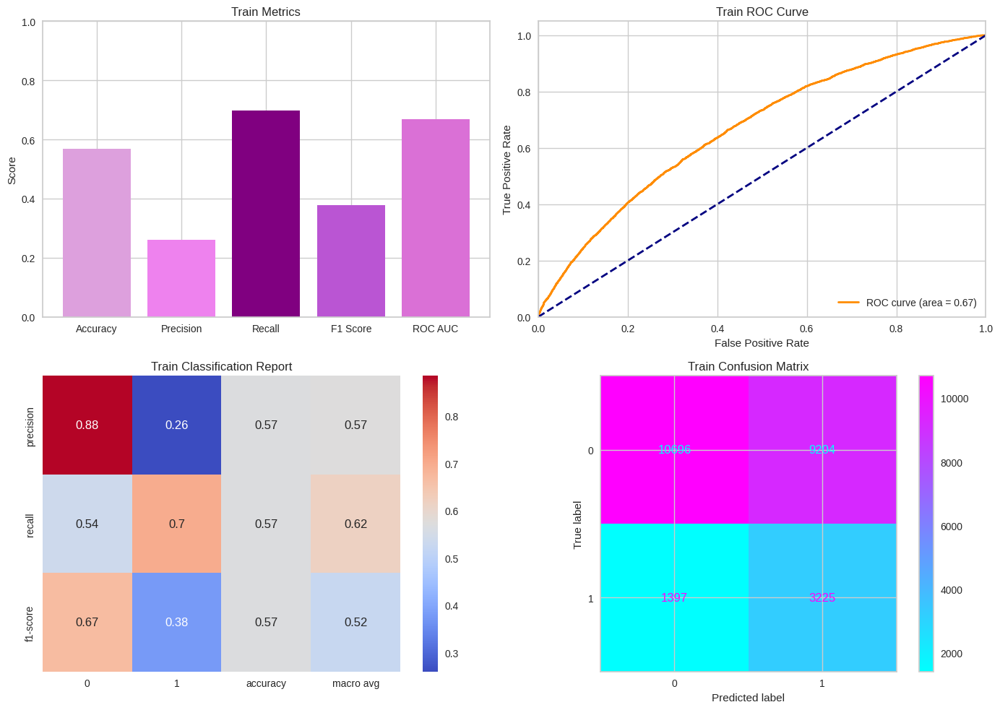

In [ ]:
evaluate_and_plot(pipeline, X_test_preprocessed, y_test)

#**Comparison of models**

In [ ]:

# Function to collect metrics and ROC curves
def collect_metrics_and_roc(model, X, y):
    y_pred = model.predict(X)
    y_pred_proba = model.predict_proba(X)[:, 1]

    accuracy = accuracy_score(y, y_pred)
    precision = precision_score(y, y_pred)
    recall = recall_score(y, y_pred)
    f1 = f1_score(y, y_pred)
    roc_auc = roc_auc_score(y, y_pred_proba)

    fpr, tpr, _ = roc_curve(y, y_pred_proba)

    return {
        'accuracy': accuracy,
        'precision': precision,
        'recall': recall,
        'f1': f1,
        'roc_auc': roc_auc,
        'fpr': fpr,
        'tpr': tpr
    }

In [ ]:
# Draw a comparative bar graph for metrics
def plot_comparison_bar_chart(models_metrics, model_names):
    metrics = ['accuracy', 'precision', 'recall', 'f1', 'roc_auc']
    n_metrics = len(metrics)
    n_models = len(models_metrics)


    bar_width = 0.15
    index = np.arange(n_metrics)

    fig, ax = plt.subplots(figsize=(10, 6))
    for i, (model_metrics, model_name) in enumerate(zip(models_metrics, model_names)):
        values = [model_metrics[metric] for metric in metrics]
        ax.bar(index + i * bar_width, values, bar_width, label=model_name)

    ax.set_xlabel('Metrics')
    ax.set_ylabel('Scores')
    ax.set_title('Comparison of Model Metrics')
    ax.set_xticks(index + bar_width * (n_models - 1) / 2)
    ax.set_xticklabels(metrics)
    ax.set_ylim(0, 1)
    ax.legend()

    plt.tight_layout()
    plt.show()

# Draw a comparative ROC curve diagram
def plot_comparison_roc_curve(models_metrics, model_names):
    fig, ax = plt.subplots(figsize=(10, 6))

    for model_metrics, model_name in zip(models_metrics, model_names):
        fpr = model_metrics['fpr']
        tpr = model_metrics['tpr']
        roc_auc = model_metrics['roc_auc']
        ax.plot(fpr, tpr, lw=2, label=f'{model_name} (area = {roc_auc:.2f})')

    ax.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    ax.set_xlim([0.0, 1.0])
    ax.set_ylim([0.0, 1.05])
    ax.set_xlabel('False Positive Rate')
    ax.set_ylabel('True Positive Rate')
    ax.set_title('Comparison of ROC Curves')
    ax.legend(loc="lower right")

    plt.tight_layout()
    plt.show()




In [ ]:
Randomforest = collect_metrics_and_roc(best_model_rf, X_test_preprocessed, y_test)
Logisticregression = collect_metrics_and_roc(best_model_lr, X_test_preprocessed, y_test)
XGBoost = collect_metrics_and_roc(model_xgb, X_test_preprocessed, y_test)
Voting = collect_metrics_and_roc(pipeline, X_test_preprocessed, y_test)

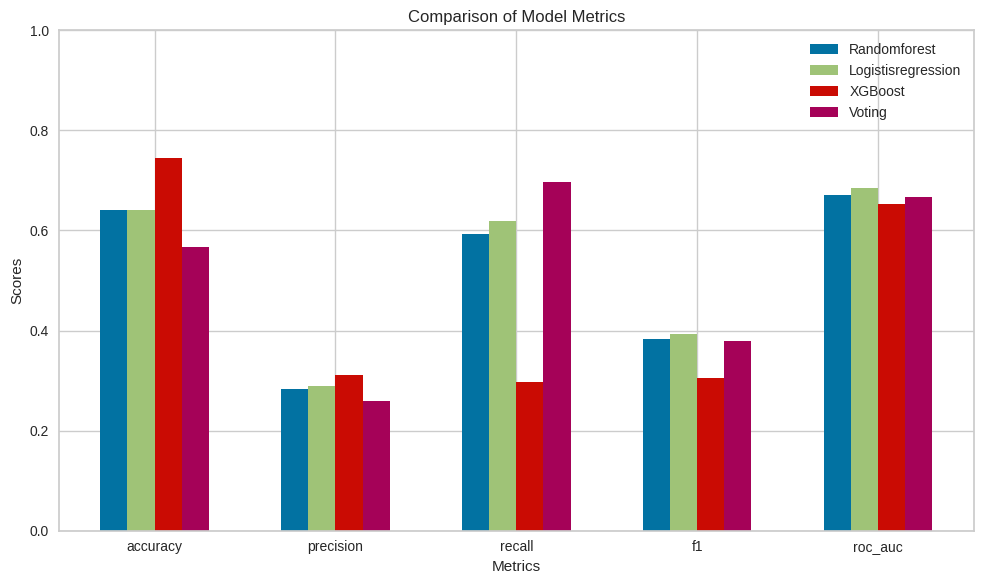

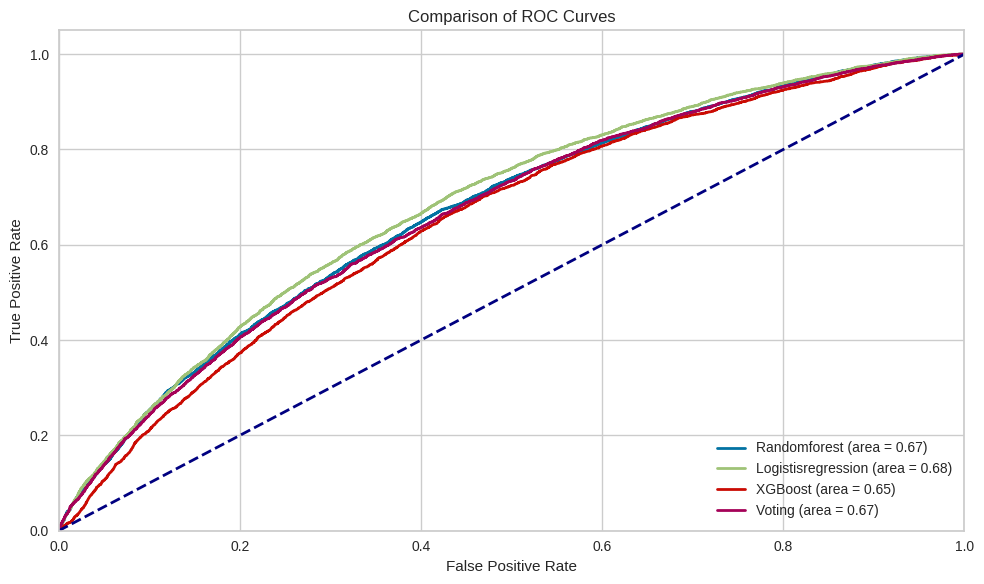

In [ ]:
# Use graph drawing functions
model_names = ['Randomforest', 'Logistisregression', 'XGBoost', 'Voting']
models_metrics = [Randomforest, Logisticregression, XGBoost, Voting]

plot_comparison_bar_chart(models_metrics, model_names)
plot_comparison_roc_curve(models_metrics, model_names)

#**Model-5: MLP**

In [ ]:
from keras.utils import to_categorical

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
cat_encoded = [col for col in X.select_dtypes(include='category').columns if X[col].nunique() !=2]
num_features = X.select_dtypes(exclude='category').columns

In [ ]:
X_train_scaled.shape
# y_train.shape

(57216, 18)

In [ ]:
from keras.models import Sequential
from keras.layers import Dense
from keras.callbacks import EarlyStopping, ModelCheckpoint
from keras.models import Sequential
from keras.layers import Dense, Dropout

In [ ]:



model = Sequential()
model.add(Dense(128,activation='relu', input_shape=(18,)))

model.add(Dense(128, activation='relu'))
# model.add(Dropout(0.5))
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(1, activation='sigmoid'))

# compile model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])


callbacks = [
    EarlyStopping(patience=3, monitor='val_loss'),
    ModelCheckpoint('best_model.h5', save_best_only=True)


history = model.fit(X_train_scaled, y_train, epochs=10, batch_size=32, validation_split=0.2, callbacks=callbacks)

Epoch 1/10
1431/1431 [==============================] - 11s 6ms/step - loss: 0.4602 - accuracy: 0.8102 - val_loss: 0.4505 - val_accuracy: 0.8107
Epoch 2/10
1431/1431 [==============================] - 4s 3ms/step - loss: 0.4529 - accuracy: 0.8103 - val_loss: 0.4514 - val_accuracy: 0.8107
Epoch 3/10
1431/1431 [==============================] - 4s 3ms/step - loss: 0.4521 - accuracy: 0.8103 - val_loss: 0.4565 - val_accuracy: 0.8107
Epoch 4/10
1431/1431 [==============================] - 6s 4ms/step - loss: 0.4506 - accuracy: 0.8104 - val_loss: 0.4497 - val_accuracy: 0.8115
Epoch 5/10
1431/1431 [==============================] - 4s 3ms/step - loss: 0.4507 - accuracy: 0.8106 - val_loss: 0.4565 - val_accuracy: 0.8087
Epoch 6/10
1431/1431 [==============================] - 4s 3ms/step - loss: 0.4498 - accuracy: 0.8105 - val_loss: 0.4488 - val_accuracy: 0.8112
Epoch 7/10
1431/1431 [==============================] - 7s 5ms/step - loss: 0.4494 - accuracy: 0.8100 - val_loss: 0.4490 - val_accuracy

In [ ]:

model.summary()


Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_37 (Dense)            (None, 128)               2432      
                                                                 
 dense_38 (Dense)            (None, 128)               16512     
                                                                 
 dense_39 (Dense)            (None, 64)                8256      
                                                                 
 dense_40 (Dense)            (None, 32)                2080      
                                                                 
 dense_41 (Dense)            (None, 1)                 33        
                                                                 
Total params: 29313 (114.50 KB)
Trainable params: 29313 (114.50 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:

loss, accuracy = model.evaluate(X_test_scaled, y_test)

print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

767/767 [==============================] - 2s 2ms/step - loss: 0.4526 - accuracy: 0.8089
Test Loss: 0.4525746703147888
Test Accuracy: 0.808865487575531


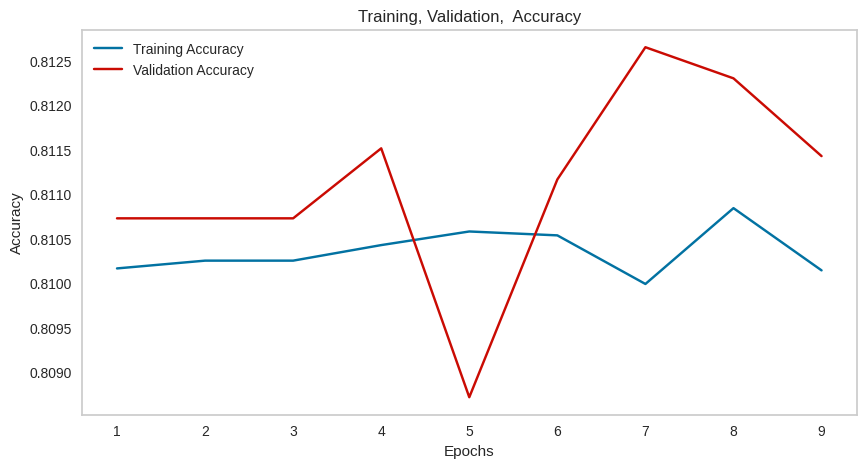

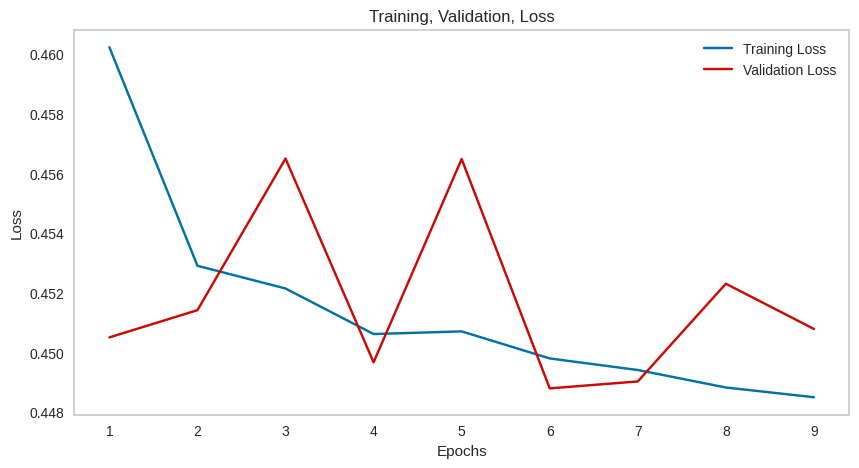

In [ ]:
train_accuracy = history.history['accuracy']
val_accuracy = history.history['val_accuracy']



train_loss = history.history['loss']
val_loss = history.history['val_loss']



epochs = range(1, len(train_accuracy) + 1)


plt.figure(figsize=(10, 5))
plt.plot(epochs, train_accuracy, 'b', label='Training Accuracy')
plt.plot(epochs, val_accuracy, 'r', label='Validation Accuracy')

plt.title('Training, Validation,  Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.grid()
plt.show()


plt.figure(figsize=(10, 5))
plt.plot(epochs, train_loss, 'b', label='Training Loss')
plt.plot(epochs, val_loss, 'r', label='Validation Loss')

plt.title('Training, Validation, Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()
plt.show()


In [ ]:
# Define functions for get_dummies and power_transform
def apply_get_dummies(X, prefixes):
    return pd.get_dummies(X, prefix=prefixes)

def apply_power_transform(X):
    return power_transform(X, method='yeo-johnson')

# Build FunctionTransformers
get_dummies_transformer = FunctionTransformer(apply_get_dummies, kw_args={'prefixes': ['home_ownership', 'purpose']})
power_transformer = FunctionTransformer(apply_power_transform, validate=True)

# Convert ordinal variables with Power Transformation
X_normalized = power_transformer.fit_transform(X[data_outlier])
X_normalized_df = pd.DataFrame(X_normalized, columns=data_outlier)

# Convert batch variables to dummy variables
X_nominal_encoded = get_dummies_transformer.fit_transform(X[nominal_columns])
X_nominal_encoded_df = pd.DataFrame(X_nominal_encoded, columns=pd.get_dummies(X[nominal_columns], prefix=['home_ownership', 'purpose']).columns)

# Convert ordinal variables with OrdinalEncoder
ordinal_encoder = OrdinalEncoder(categories='auto')
X_ordinal_encoded = ordinal_encoder.fit_transform(X[ordinal_columns])
X_ordinal_encoded_df = pd.DataFrame(X_ordinal_encoded, columns=ordinal_columns)

# Scaling numeric variables with StandardScaler
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X[numeric_columns])
X_scaled_df = pd.DataFrame(X_scaled, columns=numeric_columns)

# Selection of binary variables
X_binary_passthrough_df = X[binary_columns]

# Recombining all the variables as a DataFrame
X_preprocessed_df = pd.concat([X_normalized_df, X_nominal_encoded_df, X_ordinal_encoded_df, X_scaled_df, X_binary_passthrough_df.reset_index(drop=True)], axis=1)


In [ ]:
X_preprocessed_df.head(3)

,loan_amnt,dti,payment_inc_ratio,open_acc,delinq_2yrs,home_ownership_MORTGAGE,home_ownership_OTHER,home_ownership_OWN,home_ownership_RENT,purpose_car,...,emp_length_num,dti,payment_inc_ratio,open_acc,revol_util,short_emp,delinq_2yrs_zero,last_delinq_none,last_major_derog_none,pub_rec_zero
0,-1.061185,1.537631,0.292274,-2.159405,-0.405984,False,False,False,True,False,...,1.236410,1.622755,0.142534,-1.576457,1.161292,0,1.0,1,1,1.0
1,-1.813461,-0.878305,0.318641,-2.708650,-0.405984,False,False,False,True,False,...,1.236410,-0.904743,0.170673,-1.787809,1.735938,0,1.0,1,1,1.0
2,-1.061185,-0.522157,-0.458287,-0.169951,-0.405984,False,False,False,True,False,...,-0.637651,-0.573618,-0.567476,-0.308345,-0.989749,0,1.0,1,1,1.0


In [ ]:
print("Columns after get_dummies:")
print(X_nominal_encoded_df.columns)
print("Shape of X_nominal_encoded_df:", X_nominal_encoded_df.shape)


Columns after get_dummies:
Index(['home_ownership_MORTGAGE', 'home_ownership_OTHER', 'home_ownership_OWN',
       'home_ownership_RENT', 'purpose_car', 'purpose_credit_card',
       'purpose_debt_consolidation', 'purpose_home_improvement',
       'purpose_house', 'purpose_major_purchase', 'purpose_medical',
       'purpose_moving', 'purpose_other', 'purpose_small_business',
       'purpose_vacation', 'purpose_wedding'],
      dtype='object')
Shape of X_nominal_encoded_df: (81738, 16)


In [ ]:
print("Columns after get_dummies (pipeline):")
pipeline_preprocessed = pd.DataFrame(pipeline['preprocessor'].transform(X))
print("Shape of pipeline_preprocessed:", pipeline_preprocessed.shape)


Columns after get_dummies (pipeline):
Shape of pipeline_preprocessed: (81738, 36)


# **Clustering-1**

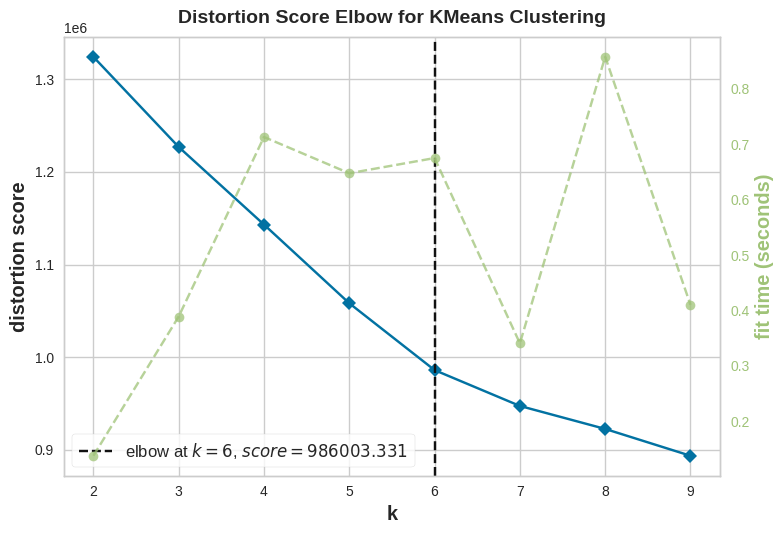

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [ ]:
model_cluster = KMeans(
           init='k-means++',
           n_init=10,
           max_iter=300,
           tol=1e-04,
           random_state=0)
visualizer = KElbowVisualizer(model_cluster, k=(2,10))
visualizer.fit(X_scaled)
visualizer.poof()
# visualizer_silhouette = KElbowVisualizer(model_cluster, k=(2,10), metric='silhouette')
# visualizer_silhouette.fit(X_new)
# visualizer_silhouette.show()

In [ ]:
optimal_k = visualizer.elbow_value_
model_cluster_optimal = KMeans()
labels = model_cluster_optimal.fit_predict(X_scaled)

# Davies-Bouldin Index
dbi = davies_bouldin_score(X_scaled, labels)

# Calinski-Harabasz Index
chi = calinski_harabasz_score(X_scaled, labels)

# Silhouette Score
silhouette_avg = silhouette_score(X_scaled, labels)

print(f"Davies-Bouldin Index: {dbi}")
print(f"Calinski-Harabasz Index: {chi}")
print(f"Silhouette Score: {silhouette_avg}")

In [ ]:
plt.figure(figsize=(8, 6))
plt.scatter(X_scaled[:, 0], X_scaled[:, 8], c=labels, cmap='viridis', marker='o', label='Clusters')
plt.scatter(model_cluster_optimal.cluster_centers_[:, 0], model_cluster_optimal.cluster_centers_[:, 1], s=300, c='red', marker='x', label='Centroids')
plt.title('KMeans Clustering with Optimal K')
plt.xlabel('loan_amnt')
plt.ylabel('payment_inc_ratio')
plt.legend()
plt.show()

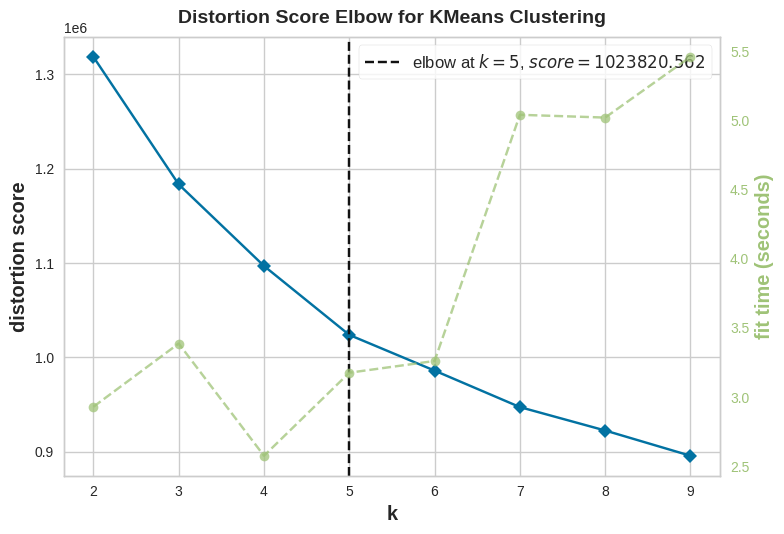

Unique categories (clusters): {0, 1, 2, 3, 4, 5, 6, 7, 8}
Number of categories (clusters): 9


In [ ]:
kmeans3D = KMeans(
           init='k-means++',
           n_init=10,
           max_iter=300,
           tol=1e-04,
           random_state=0)
visualizer = KElbowVisualizer(kmeans3D, k=(2,10))
visualizer.fit(X_new)
visualizer.poof()



In [ ]:
optimal_k = visualizer.elbow_value_
kmeans3D_optimal = KMeans(n_clusters=optimal_k,
    init='k-means++',
    n_init=10,
    max_iter=300,
    tol=1e-04,
    random_state=0)
clusters = kmeans3D_optimal.fit_predict(X_new)
unique_categories = set(clusters)
num_categories = len(unique_categories)

print(f"Unique categories (clusters): {unique_categories}")
print(f"Number of categories (clusters): {num_categories}")




Unique categories (clusters): {0, 1, 2, 3, 4}
Number of categories (clusters): 5


In [ ]:
# evaluation metrics for clustering
dbi = davies_bouldin_score(X_new, clusters)
chi = calinski_harabasz_score(X_new, clusters)
silhouette_avg = silhouette_score(X_new, clusters)
print(f"Davies-Bouldin Index: {dbi}")
print(f"Calinski-Harabasz Index: {chi}")
print(f"Silhouette Score: {silhouette_avg}")

In [ ]:
X_new['loan_segments'] = clusters
X_new.head(3)

,loan_amnt,grade,sub_grade_num,short_emp,emp_length_num,home_ownership,dti,purpose,payment_inc_ratio,delinq_2yrs,delinq_2yrs_zero,inq_last_6mths,last_delinq_none,last_major_derog_none,open_acc,pub_rec,pub_rec_zero,revol_util,loan_segments
0,-0.984130,-0.531845,-1.112067,-0.419145,1.236410,1.006383,1.622755,-0.878203,0.142534,-0.319007,-0.444036,0.013714,-0.456780,-0.200623,-1.576457,-0.288628,0.222934,1.161292,2
1,-1.311733,0.182602,1.839070,-0.419145,1.236410,1.056753,-0.904743,4.427675,0.170673,-0.319007,-0.383308,0.807043,-1.035286,0.191381,-1.787809,-0.288628,0.222934,1.735938,2
2,-0.984130,-1.346432,-0.156638,-0.383363,-0.637651,1.006383,-0.573618,-1.770654,-0.567476,-0.319007,-0.382415,1.600372,-1.035286,0.347336,-0.308345,-0.288628,0.350275,-0.989749,2


In [ ]:
PLOT = go.Figure()
for i in list(X_new["loan_segments"].unique()):


    PLOT.add_trace(go.Scatter3d(x = X_new[X_new["loan_segments"]== i]["loan_amnt"],
                                y = X_new[X_new["loan_segments"] == i]["emp_length_num"],
                                z = X_new[X_new["loan_segments"] == i]["grade"],
                                mode = 'markers',marker_size = 2, marker_line_width = 1,
                                name = str(i)))
PLOT.update_traces(hovertemplate='Beats Per Minute (BPM): %{x} <br>Energy: %{y} <br>Danceability: %{z}')


PLOT.update_layout(width = 800, height = 800, autosize = True, showlegend = True,
                   scene = dict(xaxis=dict(title = 'laon_amnt', titlefont_color = 'black'),
                                yaxis=dict(title = 'emp_length_num', titlefont_color = 'black'),
                                zaxis=dict(title = 'grade', titlefont_color = 'black')),
                   font = dict(family = "Gilroy", color  = 'black', size = 12))

**Data preprocessing**

Building on our understanding of the data, we've categorized the columns into types like nominal and ordinal (detailed below). We've also isolated the target column from the dataset. Next, we defined specific preprocessing steps for each column type using ColumnTransformer. Finally, a pipeline was created to execute these preprocessing steps along with a dimensionality reduction algorithm on the data. This process helps prepare the data for optimal modeling results.

In [ ]:
# numeric_columns = data_cluster.select_dtypes(include='number').columns.tolist()
# category_columns = data_cluster.select_dtypes(exclude='number').columns.tolist()
data_outlier = ['loan_amnt','dti','payment_inc_ratio','open_acc','delinq_2yrs']
nominal_columns = ['home_ownership','purpose']
ordinal_columns =['grade']
numeric_columns=['loan_amnt','emp_length_num','dti','payment_inc_ratio','open_acc','revol_util']
binary_columns= ['short_emp', 'delinq_2yrs_zero', 'last_delinq_none', 'last_major_derog_none', 'pub_rec_zero']
# binary_columns.remove('bad_loans')
# print(binary_columns)

In [ ]:
copied_data = data.copy()
Xm = data.drop('bad_loans', axis=1)
ym = data['bad_loans']

In [ ]:
pca = PCA()
pca_3d = PCA(n_components=3)
pca_2d= PCA(n_components=2)
lda = LDA(n_components=2)
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=2000)
umap = UMAP(n_components=2)

In [ ]:
PREPROCESS_DATA_DOCSTRING = """
    This function preprocesses the input data for further analysis.

    Parameters:
        X (pandas.DataFrame): The input data to be preprocessed.
        data_outlier (list): A list of column names containing outliers.
        nominal_columns (list): A list of column names containing nominal categorical data.
        ordinal_columns (list): A list of column names containing ordinal categorical data.
        numeric_columns (list): A list of column names containing numerical data.
        binary_columns (list): A list of column names containing binary data.
        dim_reduction_algo (object): The dimensionality reduction algorithm object.

    Returns:
        pandas.DataFrame: The preprocessed data.

    Details:
        This function performs various preprocessing steps on the data based on the specified column types.
        - Outliers in specified columns are handled using power transform (Yeo-Johnson method).
        - Nominal categorical data is one-hot encoded using `get_dummies`.
        - Ordinal categorical data is encoded using `OrdinalEncoder` with automatic category handling.
        - Numerical data is scaled using `StandardScaler`.
        - Binary data remains unchanged (passed through).
        - All other columns are passed through without modification.
        Finally, the function applies a dimensionality reduction algorithm to the preprocessed data.
    """


In [ ]:

# Function definition for get_dummy
def apply_get_dummies(X):
    return pd.get_dummies(X)

# Function definition for box_cox
def apply_power_transform(X):
    return power_transform(X, method='yeo-johnson')

# Define FunctionTransformer using defined functions
get_dummies_transformer = FunctionTransformer(apply_get_dummies)
power_transformer = FunctionTransformer(apply_power_transform, validate=True)

# Function definition for data preprocessing
def preprocess_data(X, data_outlier, nominal_columns, ordinal_columns, numeric_columns, binary_columns, dim_reduction_algo):
    preprocessor = ColumnTransformer(
        transformers=[
            ('normalize', power_transformer, data_outlier),
            ('encode_nominal', get_dummies_transformer, nominal_columns),
            ('encode_ordinal', OrdinalEncoder(categories='auto'), ordinal_columns),
            ('scale_numeric', StandardScaler(), numeric_columns),
            ('remainder_passthrough', 'passthrough', binary_columns)
        ],
        remainder='passthrough'
    )

 # Create a pipeline with preprocessor and dimensionality reduction
    pipeline = Pipeline(steps=[
        ('preprocessor', preprocessor),
        ('dim_reduction', dim_reduction_algo)
    ])

   # Pipeline adaptation and data transformation
    Xm_transformed = pipeline.fit_transform(X)
    print("Transformed Data Shape:", Xm_transformed.shape)
    return Xm_transformed

preprocess_data.__doc__ = PREPROCESS_DATA_DOCSTRING


In [ ]:
# help(preprocess_data)

Help on function preprocess_data in module __main__:

preprocess_data(X, data_outlier, nominal_columns, ordinal_columns, numeric_columns, binary_columns, dim_reduction_algo)
    This function preprocesses the input data for further analysis.
    
    Parameters:
        X (pandas.DataFrame): The input data to be preprocessed.
        data_outlier (list): A list of column names containing outliers.
        nominal_columns (list): A list of column names containing nominal categorical data.
        ordinal_columns (list): A list of column names containing ordinal categorical data.
        numeric_columns (list): A list of column names containing numerical data.
        binary_columns (list): A list of column names containing binary data.
        dim_reduction_algo (object): The dimensionality reduction algorithm object.
    
    Returns:
        pandas.DataFrame: The preprocessed data.
    
    Details:
        This function performs various preprocessing steps on the data based on the sp

**K-Mean with reduced dimensions**

In this section, we leverage the preprocessed data from the previous step. We employ three dimensionality reduction algorithms: PCA (Principal Component Analysis),  TSNE , and UMAP.  For each dataset transformed by these algorithms (i.e., the data with reduced dimensions), we determine the optimal number of clusters using the elbow method and the KMeans algorithm. Subsequently, we perform clustering and obtain three evaluation criteria (silhouette score, V-Measure Score, ARI)  to assess the quality of the clusters. Finally, we visualize the clustered data based on the chosen dimensionality reduction technique.

In [ ]:
def apply_kmeans_clustering(Xm_transformed, n_clusters_range, random_state):
    """
    Performs KMeans clustering on the preprocessed data.

    Parameters:
        Xm_transformed (numpy.ndarray): The preprocessed data.
        n_clusters_range (tuple): The range of cluster numbers to explore.
        random_state (int): The random seed for ensuring reproducibility.

    Returns:
        tuple: A tuple containing:
            - cluster_labels (numpy.ndarray): The cluster labels for each data point.
            - kmeans_optimal (sklearn.cluster.KMeans): The fitted KMeans model with the optimal number of clusters.
    """


    # Apply KMeans clustering
    kmeans = KMeans(init='k-means++', n_init=10, max_iter=300, tol=1e-04, random_state=random_state)

    # Using the elbow method to find the optimal number of clusters
    visualizer = KElbowVisualizer(kmeans, k=n_clusters_range)
    visualizer.fit(Xm_transformed)
    visualizer.show()

    # Retrieve the optimal number of clusters and apply KMeans clustering
    optimal_k = visualizer.elbow_value_
    kmeans_optimal = KMeans(n_clusters=optimal_k, init='k-means++', n_init=10, max_iter=300, tol=1e-04, random_state=random_state)
    cluster_labels = kmeans_optimal.fit_predict(Xm_transformed)

    return cluster_labels, kmeans_optimal

In [ ]:
def evaluate_clustering(clustering_algorithm, true_labels, features):
    # Implementation of clustering algorithm and label prediction
    predicted_labels = clustering_algorithm.fit_predict(features)

    # Calculation of evaluation criteria
    silhouette_avg = round(silhouette_score(features, true_labels),4)
    v_measure = round(v_measure_score(true_labels, predicted_labels),4)
    rand_index = round(adjusted_rand_score(true_labels, predicted_labels),4)


    # Create a table to display the results
    results_df = pd.DataFrame({
        'Silouette Score': [silhouette_avg],
        'V-Measure Score': [v_measure],
        'ARI' : [rand_index]
    })


    return results_df

In [ ]:
def plot_reduced_data(reduced_data, cluster_labels, algorithm_name, dimensions=2):
    """
    Plots the reduced data for 2D or 3D visualization.

    Args:
        reduced_data (array-like): The reduced data matrix after dimensionality reduction.
        cluster_labels (array-like): Cluster labels for each data point.
        algorithm_name (str): Name of the dimension reduction algorithm used.
        dimensions (int, optional): The number of dimensions for the plot (2 or 3).
    """
    if dimensions not in [2, 3]:
        raise ValueError("Only 2D or 3D plots are supported.")

    plt.figure(figsize=(10, 6))

    cmap = plt.get_cmap('plasma')

    if dimensions == 2:
        scatter = plt.scatter(reduced_data[:, 0], reduced_data[:, 1], c=cluster_labels, cmap=cmap, alpha=1)
        plt.xlabel(f'{algorithm_name} Component 1')
        plt.ylabel(f'{algorithm_name} Component 2')
    elif dimensions == 3:
        ax = plt.axes(projection='3d')
        scatter = ax.scatter(reduced_data[:, 0], reduced_data[:, 1], reduced_data[:, 2], c=cluster_labels, cmap=cmap, alpha=1)
        ax.set_xlabel(f'{algorithm_name} Component 1')
        ax.set_ylabel(f'{algorithm_name} Component 2')
        ax.set_zlabel(f'{algorithm_name} Component 3')

    plt.title(f'{algorithm_name} Visualization with Clustering')

    # Create a ScalarMappable and initialize a data structure
    sm = ScalarMappable(cmap=cmap)
    sm.set_array([])

    # Add colorbar using the ScalarMappable
    plt.colorbar(sm, label='Cluster')

    plt.show()



**clustering criteria**

In [ ]:
# dbi_score = davies_bouldin_score(Xm_transformed, cluster_labels)
# chi_score = calinski_harabasz_score(Xm_transformed, cluster_labels)
# silhouette_avg = silhouette_score(Xm_transformed, cluster_labels)
# rand_index = adjusted_rand_score(ym, cluster_labels)
# jaccard_score = jaccard_score(ym, cluster_labels, average='macro')
# mutual_info = adjusted_mutual_info_score(ym, cluster_labels)
# correlation, _ = pearsonr(ym, cluster_labels)
# f1 = f1_score(ym, cluster_labels, average='weighted')

# print(f'Davies-Bouldin Index: {dbi_score}')
# print(f'Calinski-Harabasz Index: {chi_score}')
# print(f'Silhouette Score: {silhouette_avg}')
# print(f"Rand Index: {rand_index}")
# print(f"Jaccard Score: {jaccard_score}")
# print(f"Mutual Information: {mutual_info}")
# print(f"Correlation: {correlation:.4f}")
# print(f"F1 Score: {f1:.4f}")



**PCA**

This section performs Principal Component Analysis (PCA) to visualize the explained variance ratio for each principal component. The preprocessed data (Xm_transformed) is obtained using the preprocess_data function, which includes a PCA step using the pca argument for dimensionality reduction.

The code then calculates the covariance matrix (cov_mat) of the transformed data. Eigenvalues (eigen_vals) and eigenvectors are obtained from the eigendecomposition of the covariance matrix. The explained variance ratio (var_exp) is calculated for each principal component by dividing its eigenvalue by the sum of all eigenvalues. The cumulative explained variance (cum_var_exp) is then calculated.

Transformed Data Shape: (81738, 36)


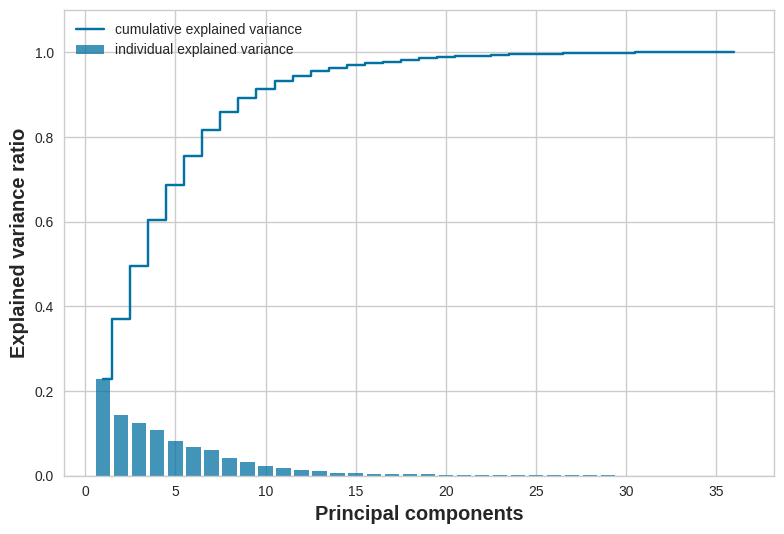

In [ ]:
Xm_transformed = preprocess_data(Xm, data_outlier, nominal_columns, ordinal_columns, numeric_columns, binary_columns, pca)
cov_mat = np.cov(Xm_transformed.T)
eigen_vals, eigen_vecs = np.linalg.eig(cov_mat)
tot = sum(eigen_vals)
# var_exp ratio is fraction of eigen_val to total sum
var_exp = [(i / tot) for i in sorted(eigen_vals, reverse=True)]
# calculate the cumulative sum of explained variances
cum_var_exp = np.cumsum(var_exp)
plt.bar(range(1, 37), var_exp, alpha=0.75, align='center',
        label='individual explained variance')
plt.step(range(1, 37), cum_var_exp, where='mid',
         label='cumulative explained variance')
plt.ylim(0, 1.1)
plt.xlabel('Principal components')
plt.ylabel('Explained variance ratio')
plt.legend(loc='best')
plt.show()

**PCA_2D**

Transformed Data Shape: (81738, 2)


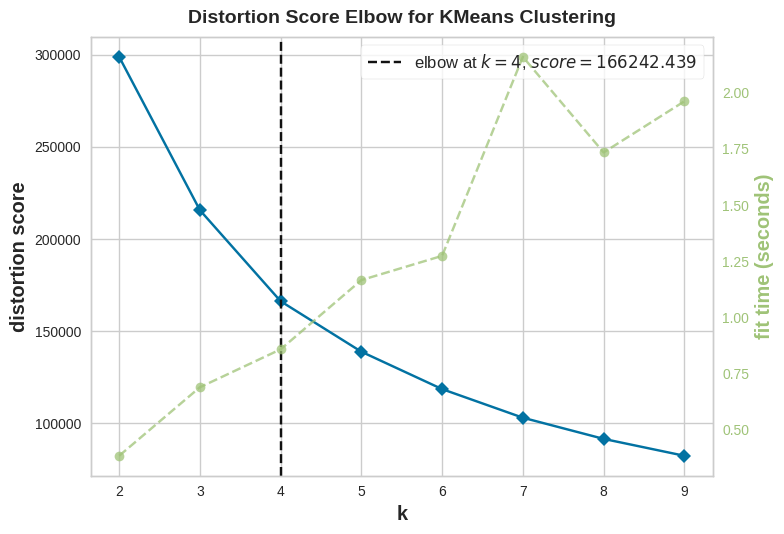

Kmeans labels: {0, 1, 2, 3}
Kmeans optimal: KMeans(n_clusters=4, n_init=10, random_state=42)
Counter({2: 22175, 0: 22031, 1: 20364, 3: 17168})


In [ ]:
Xm_transformed = preprocess_data(Xm, data_outlier, nominal_columns, ordinal_columns, numeric_columns, binary_columns, pca_2d)
km_labels, kmeans_optimal = apply_kmeans_clustering(Xm_transformed, (2,10), 42)
print("Kmeans labels:", set(km_labels))
print("Kmeans optimal:", kmeans_optimal)
print("Number of samples per cluster", Counter(km_labels))

In [ ]:
pca_ev = evaluate_clustering(kmeans_optimal, ym, Xm_transformed)


In [ ]:
pca_ev

,Silouette Score,V-Measure Score,ARI
0,0.0348,0.0125,0.0094


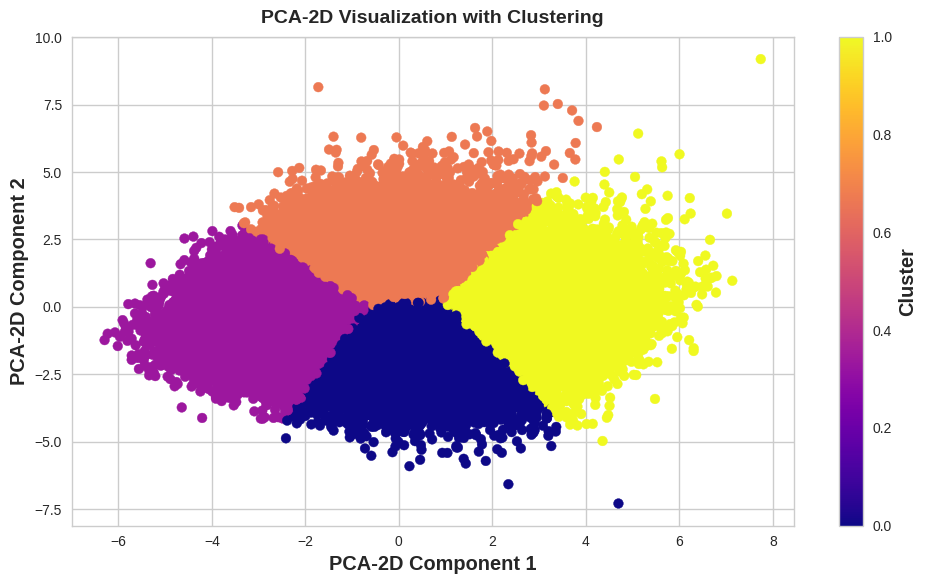

In [ ]:
plot_reduced_data(Xm_transformed, km_labels, algorithm_name='PCA-2D', dimensions=2)

**PCA-3D**

Transformed Data Shape: (81738, 3)


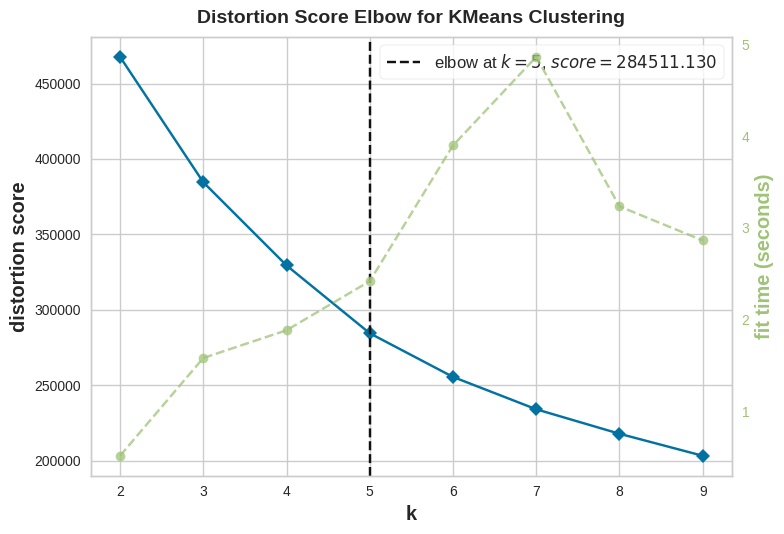

Kmeans labels: {0, 1, 2, 3, 4}
Kmeans optimal: KMeans(n_clusters=5, n_init=10, random_state=42)
Number of samples per cluster Counter({1: 19085, 0: 18099, 2: 17570, 3: 14083, 4: 12901})


In [ ]:
Xm_transformed = preprocess_data(Xm, data_outlier, nominal_columns, ordinal_columns, numeric_columns, binary_columns, pca_3d)
km_labels, kmeans_optimal = apply_kmeans_clustering(Xm_transformed, (2,10), 42)
print("Kmeans labels:", set(km_labels))
print("Kmeans optimal:", kmeans_optimal)
print("Number of samples per cluster", Counter(km_labels))

In [ ]:
pca3_ev = evaluate_clustering(kmeans_optimal, ym, Xm_transformed)
pca3_ev

,Silouette Score,V-Measure Score,ARI
0,0.0413,0.0164,0.0127


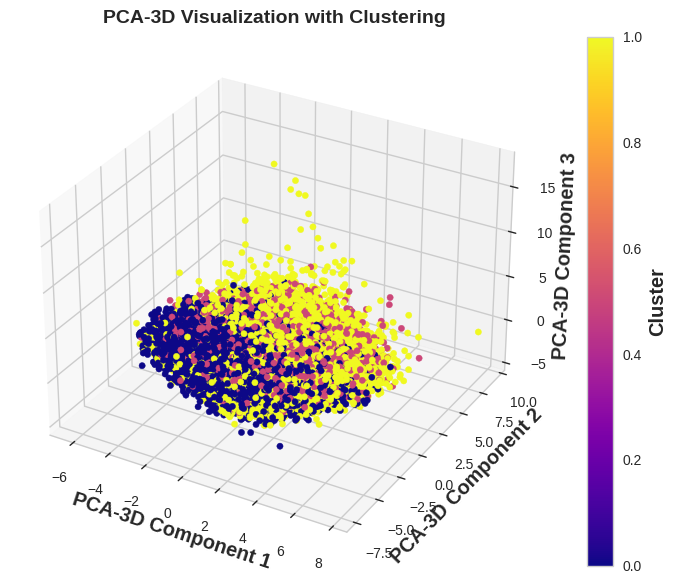

In [ ]:
plot_reduced_data(Xm_transformed, km_labels, algorithm_name='PCA-3D', dimensions=3)

**TSNE**

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 81738 samples in 0.017s...
[t-SNE] Computed neighbors for 81738 samples in 56.320s...
[t-SNE] Computed conditional probabilities for sample 1000 / 81738
[t-SNE] Computed conditional probabilities for sample 2000 / 81738
[t-SNE] Computed conditional probabilities for sample 3000 / 81738
[t-SNE] Computed conditional probabilities for sample 4000 / 81738
[t-SNE] Computed conditional probabilities for sample 5000 / 81738
[t-SNE] Computed conditional probabilities for sample 6000 / 81738
[t-SNE] Computed conditional probabilities for sample 7000 / 81738
[t-SNE] Computed conditional probabilities for sample 8000 / 81738
[t-SNE] Computed conditional probabilities for sample 9000 / 81738
[t-SNE] Computed conditional probabilities for sample 10000 / 81738
[t-SNE] Computed conditional probabilities for sample 11000 / 81738
[t-SNE] Computed conditional probabilities for sample 12000 / 81738
[t-SNE] Computed conditional probabilities for s

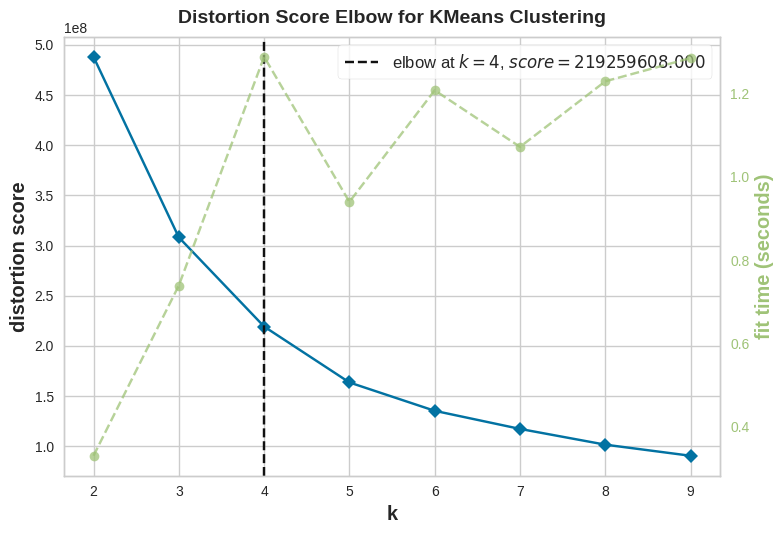

Kmeans labels: {0, 1, 2, 3}
Kmeans optimal: KMeans(n_clusters=4, n_init=10, random_state=42)
Number of samples per cluster Counter({0: 23507, 1: 21477, 3: 20496, 2: 16258})


In [ ]:
Xt_transformed = preprocess_data(Xm, data_outlier, nominal_columns, ordinal_columns, numeric_columns, binary_columns, tsne)
km_labels, kmeans_optimal = apply_kmeans_clustering(Xt_transformed, (2,10), 42)
print("Kmeans labels:", set(km_labels))
print("Kmeans optimal:", kmeans_optimal)
print("Number of samples per cluster", Counter(km_labels))

In [ ]:
tsne_ev = evaluate_clustering(kmeans_optimal, ym, Xt_transformed)
tsne_ev

,Silouette Score,V-Measure Score,ARI
0,0.0208,0.0073,0.0011


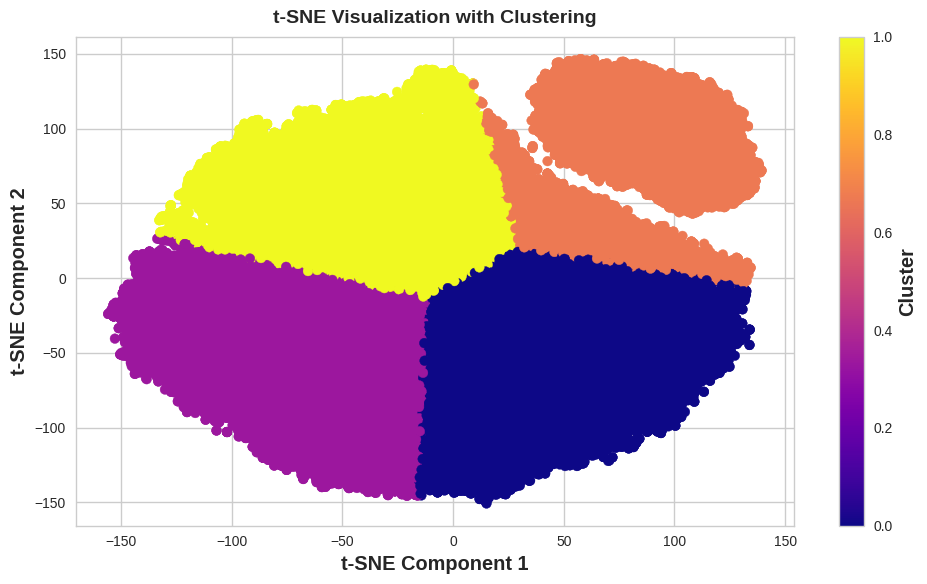

In [ ]:
plot_reduced_data(Xt_transformed, km_labels, algorithm_name='t-SNE', dimensions=2)

**UMAP**

Transformed Data Shape: (81738, 2)


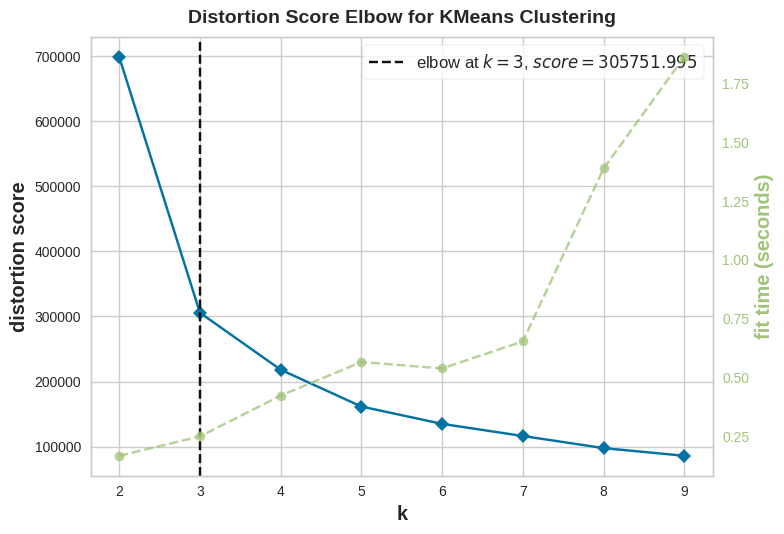

Kmeans labels: {0, 1, 2}
Kmeans optimal: KMeans(n_clusters=3, n_init=10, random_state=42)
Number of samples per cluster Counter({2: 37139, 0: 33049, 1: 11550})


In [ ]:
Xu_transformed = preprocess_data(Xm, data_outlier, nominal_columns, ordinal_columns, numeric_columns, binary_columns, umap)
km_labels, kmeans_optimal = apply_kmeans_clustering(Xu_transformed, (2,10), 42)
print("Kmeans labels:", set(km_labels))
print("Kmeans optimal:", kmeans_optimal)
print("Number of samples per cluster", Counter(km_labels))

In [ ]:
umap_ev= evaluate_clustering(kmeans_optimal, ym, Xu_transformed)
print(umap_ev)

   Silouette Score  V-Measure Score     ARI
0           0.0129           0.0015  0.0048


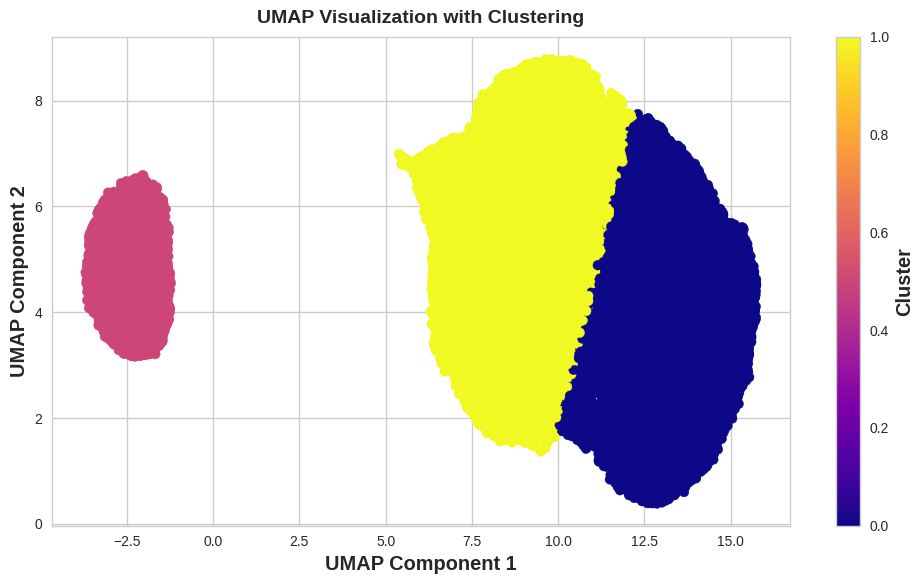

In [ ]:
plot_reduced_data(Xu_transformed, km_labels, algorithm_name='UMAP', dimensions=2)

**DBSCAN**

To address computational constraints, this section utilizes the StratifiedShuffleSplit class to split the preprocessed data (X_transformed) and target labels (y) into training and testing sets. Subsequently, the k-Nearest Neighbors (kNN) method is employed to estimate an initial value for the epsilon hyperparameter of the DBSCAN algorithm. Finally, a grid search is conducted to find the optimal combination of epsilon and minimum samples hyperparameters that maximizes the Silhouette Score, a metric for evaluating clustering performance.

In [ ]:
X = Xm_transformed
y = ym


sss = StratifiedShuffleSplit(n_splits=1, test_size=10000, random_state=0)

for train_index, sample_index in sss.split(X, y):
    X_sample, y_sample = X[sample_index], y[sample_index]




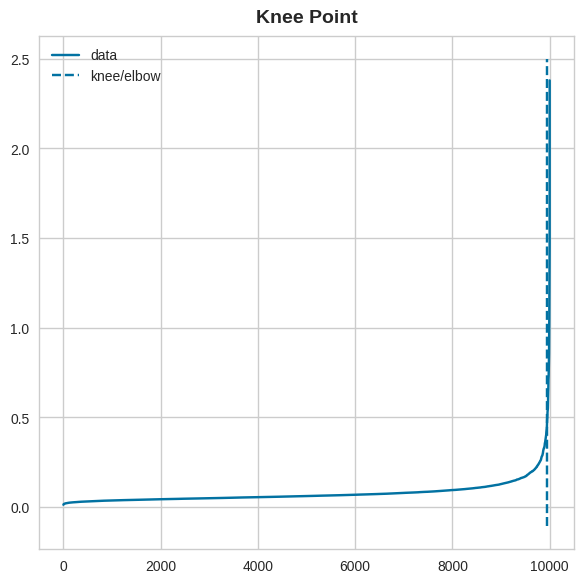

0.4254641118533439


In [ ]:

# n_neighbors = 5 as kneighbors function returns distance of point to itself (i.e. first column will be zeros)
nbrs = NearestNeighbors(n_neighbors = 4).fit(X_sample)
# Find the k-neighbors of a point
neigh_dist, neigh_ind = nbrs.kneighbors(X_sample)
# sort the neighbor distances (lengths to points) in ascending order
sort_neigh_dist = np.sort(neigh_dist, axis = 0)
k_dist = sort_neigh_dist[:, 3]
kneedle = KneeLocator(x = range(1, len(neigh_dist)+1), y = k_dist, S = 1.0,
                      curve = "concave", direction = "increasing", online=True)
kneedle.plot_knee()
plt.show()


# get the estimate of knee point
print(kneedle.knee_y)



In [ ]:
param_grid = {
    'eps': np.linspace(0.01, 1, num=20),
    'min_samples': np.arange(2, 10, step=1)
}

# The best parameter values and the best score
best_params = None
best_score = -1

# Create parameters grid
grid = ParameterGrid(param_grid)

# Run Grid Search
for params in grid:
    # Create and train the DBSCAN model with the current parameters
    dbscan = DBSCAN(eps=params['eps'], min_samples=params['min_samples'])
    clusters = dbscan.fit_predict(X_sample)


    if len(set(clusters)) > 1:
        score = silhouette_score(X_sample, clusters)
        if score > best_score:
            best_score = score
            best_params = params

# Display the best parameters and the best score
print(f'Best Parameters: {best_params}')
print(f'Best Silhouette Score: {best_score}')

Best Parameters: {'eps': 1.0, 'min_samples': 3}
Best Silhouette Score: 0.6128264106758343


In [ ]:
# check unique clusters
set(dbscan.labels_)
Counter(dbscan.labels_)

Counter({0: 9998, -1: 2})

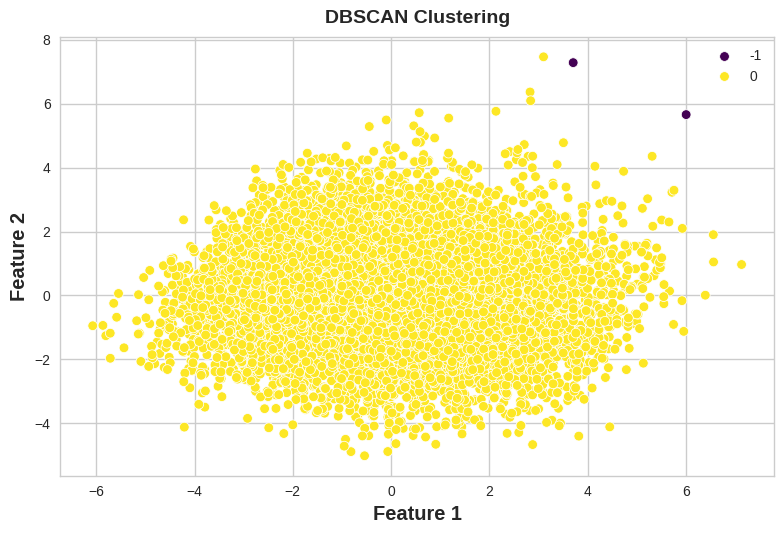

In [ ]:
# Data visualization
sns.scatterplot(x=X_sample[:, 0], y=X_sample[:, 1], hue=dbscan.labels_, palette='viridis')

plt.title('DBSCAN Clustering')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')


plt.show()

In [ ]:
# df['Labels'] = dbscan.labels_

**OPTICS**

In [ ]:

optic = OPTICS(min_samples=4, xi=.05, min_cluster_size=.05)
optic.fit(Xm_transformed)

# Extract the clusters
optic_labels = clustering.labels_



In [ ]:
# Print the cluster labels
print("Cluster Labels:", set(optic_labels))
Counter(optic.labels_)


Cluster Labels: {0, -1}


Counter({0: 81695, -1: 43})

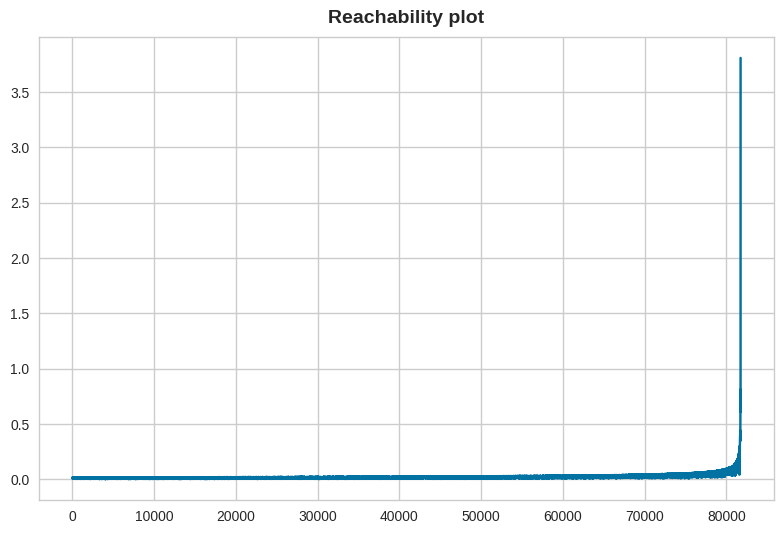

In [ ]:
reachability = clustering.reachability_[clustering.ordering_]
plt.plot(reachability)
plt.title('Reachability plot')
plt.show()

In [ ]:
def objective(trial):
    # Definition of parameter ranges
    min_samples = trial.suggest_int('min_samples', 2, 10)
    xi = trial.suggest_float('xi', 0.01, 0.1)
    min_cluster_size = trial.suggest_float('min_cluster_size', 0.01, 0.1)

    # Create OPTICS model with suggested parameters
    model = OPTICS(min_samples=min_samples, xi=xi, min_cluster_size=min_cluster_size)
    model.fit(Xm_transformed)

    labels = model.labels_


    score = silhouette_score(Xm_transformed, labels) if len(set(labels)) > 1 else -1
     # Determine the number of clusters
    num_clusters = len(np.unique(labels))

    # Print the number of clusters
    print(f"Number of Clusters: {num_clusters}")
    # Count samples in each cluster
    cluster_counts = np.bincount(labels)

    # Print cluster counts (optional)
    print(f"Cluster Counts: {cluster_counts}")

    return score

# Create a study to optimize and run experiments
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=10)

# Display the best parameters
print(study.best_params)


[I 2024-05-12 19:14:24,544] A new study created in memory with name: no-name-c5c3cf63-08d8-47d0-825c-b1537c2f54fe
[I 2024-05-12 19:26:45,004] Trial 0 finished with value: 0.5796784479583579 and parameters: {'min_samples': 2, 'xi': 0.024279358554986433, 'min_cluster_size': 0.05315041852773559}. Best is trial 0 with value: 0.5796784479583579.
[I 2024-05-12 19:38:56,187] Trial 1 finished with value: 0.5609181482798624 and parameters: {'min_samples': 4, 'xi': 0.011685996881751405, 'min_cluster_size': 0.053360981528015806}. Best is trial 0 with value: 0.5796784479583579.
[I 2024-05-12 19:50:57,159] Trial 2 finished with value: 0.7122118907808199 and parameters: {'min_samples': 3, 'xi': 0.07513230757589007, 'min_cluster_size': 0.09546984908199066}. Best is trial 2 with value: 0.7122118907808199.
[I 2024-05-12 20:01:27,920] Trial 3 finished with value: -1.0 and parameters: {'min_samples': 7, 'xi': 0.05597783560824859, 'min_cluster_size': 0.014040870523233648}. Best is trial 2 with value: 0.71

{'min_samples': 3, 'xi': 0.07513230757589007, 'min_cluster_size': 0.09546984908199066}


In [ ]:
best_params = study.best_params
best_score = study.best_value
print(f"Best Silhouette Score: {best_score}")

Best Silhouette Score: 0.7122118907808199


In [ ]:
cluster_counts = study.best_trial.user_attrs['cluster_counts']
print(f"Best Cluster Counts: {cluster_counts}")

KeyError: 'cluster_counts'

In [ ]:
num_clusters = study.best_trial.user_attrs['num_clusters']
print(f"Best Number of Clusters: {num_clusters}")

KeyError: 'num_clusters'

**KMODE**

In this section, we employed the k-modes clustering algorithm to optimize the clustering cost. We created a new dataset containing only categorical columns to determine the optimal number of clusters. The algorithm was run with different initialization methods (random, Cao, and Huang) and the number of clusters assigned to each category was displayed.

In [ ]:
X = data.copy()
y = X.pop("bad_loans")
category_columns = X.select_dtypes(exclude='number')



def is_binary(column):
    return column.nunique() == 2

# We use the apply function to apply the is_binary function to each column
binary_columns = category_columns.apply(is_binary)
# binary_columns = category_columns.loc[:, binary_columns]

# Among the category columns, we select those that are not binary
kmode_data = category_columns.loc[:, ~category_columns.apply(is_binary)]


print(kmode_data)


      grade sub_grade_num home_ownership             purpose
0         B           0.4           RENT         credit_card
1         C           1.0           RENT      small_business
2         A           0.8           RENT             wedding
3         E           0.2           RENT                 car
4         F           0.4            OWN      small_business
...     ...           ...            ...                 ...
81733     G           0.4       MORTGAGE             medical
81734     D           0.6           RENT               other
81735     B           1.0       MORTGAGE  debt_consolidation
81736     D           0.4       MORTGAGE  debt_consolidation
81737     D           1.0       MORTGAGE  debt_consolidation

[81738 rows x 4 columns]


In [ ]:
data.shape[1]

19

Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 0, cost: 200093.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 2, iteration: 1/100, moves: 0, cost: 200093.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 3, iteration: 1/100, moves: 0, cost: 200093.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 4, iteration: 1/100, moves: 0, cost: 200093.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 5, iteration: 1/100, moves: 0, cost: 200093.0
Best run was number 1
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 0, cost: 172358.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 2, iteration: 1/100, moves: 12306, cost: 177428.0
Init: initializing centroids
Init: initializing clusters
Startin

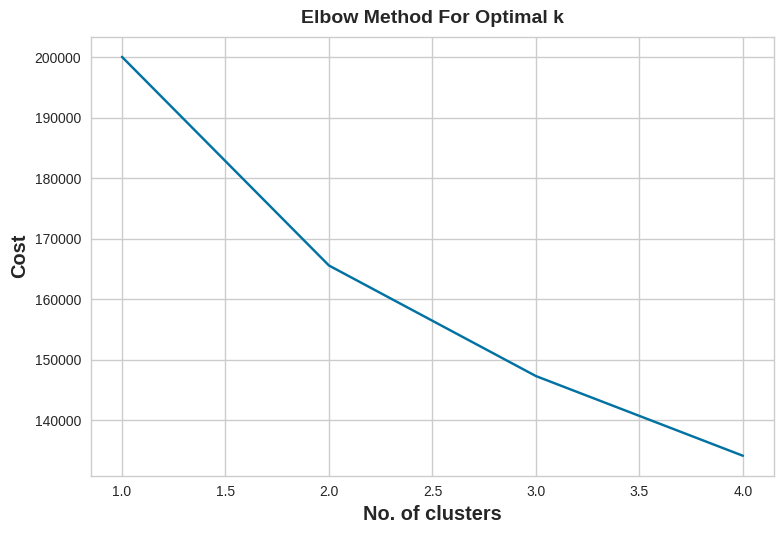

In [ ]:
cost = []
K = range(1,5)
for num_clusters in list(K):
    kmode = KModes(n_clusters=num_clusters, init = "random", n_init = 5, verbose=1)
    kmode.fit_predict(kmode_data)
    cost.append(kmode.cost_)

plt.plot(K, cost, 'bx-')
plt.xlabel('No. of clusters')
plt.ylabel('Cost')
plt.title('Elbow Method For Optimal k')
plt.show()

In [ ]:
# Find the elbow point using KneeLocator
for k in tqdm(range(2,11))
cost = []
K = range(1, 10)
for num_clusters in list(K):
    kmode = KModes(n_clusters=num_clusters, init="random", n_init=5, verbose=1)
    kmode.fit_predict(kmode_data)
    cost.append(kmode.cost_)
kn = KneeLocator(K, cost, curve='convex', direction='decreasing')
optimal_k = kn.knee

# Display the optimal number of clusters
print(f"The optimal number of clusters is: {optimal_k}")

# Draw a cost diagram showing the optimal number of clusters
plt.plot(K, cost, 'bx-')
plt.xlabel('No. of clusters')
plt.ylabel('Cost')
plt.title('Elbow Method For Optimal k')
plt.axvline(x=optimal_k, color='r', linestyle='--')
plt.show()

Using K-Mode with "Random" initialization

In [ ]:
kmode_random = KModes(n_clusters=3, init = "random", n_init = 1, verbose=1)
clusters_random = kmode_random.fit_predict(kmode_data)
clusters_random

Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 31402, cost: 148090.0
Run 1, iteration: 2/100, moves: 7, cost: 148090.0


array([1, 1, 0, ..., 0, 0, 0], dtype=uint16)

Using K-Mode with "Cao" initialization

In [ ]:
kmode_cao = KModes(n_clusters=3, init = "Cao", n_init = 1, verbose=1)
clusters_cao = kmode_cao.fit_predict(kmode_data)
clusters_cao

Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 0, cost: 146805.0


array([2, 1, 0, ..., 0, 0, 0], dtype=uint16)

Using K-Mode with "Huang" initialization

In [ ]:
kmode_huang = KModes(n_clusters=3, init = "Huang", n_init = 1, verbose=1)
clusters_huang = kmode_huang.fit_predict(kmode_data)
clusters_huang

Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 16328, cost: 152682.0


array([1, 0, 0, ..., 2, 2, 1], dtype=uint16)

In [ ]:
kmode_data.insert(0, "Cluster", clusters_huang, True)
kmode_data.head(3)

,Cluster,grade,sub_grade_num,home_ownership,purpose
0,1,B,0.4,RENT,credit_card
1,0,C,1.0,RENT,small_business
2,0,A,0.8,RENT,wedding


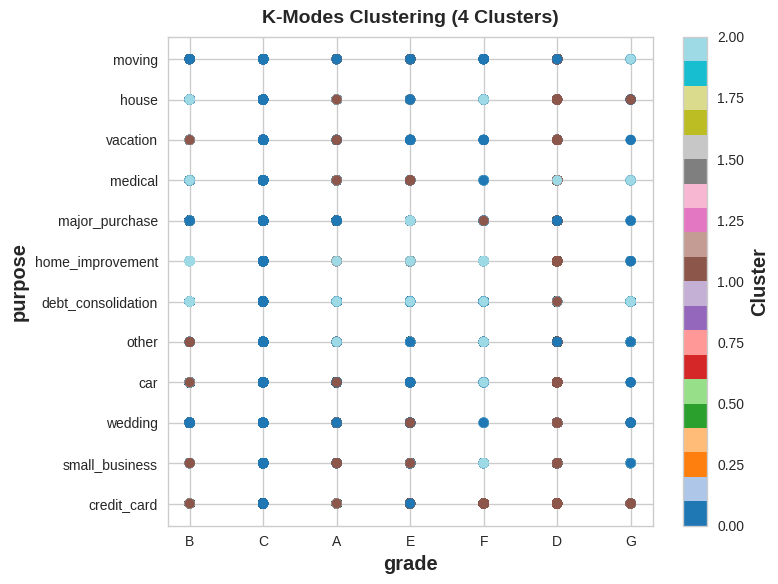

In [ ]:
plt.figure(figsize=(8, 6))
plt.scatter(kmode_data['grade'], kmode_data['purpose'], c=clusters_huang, cmap='tab20')
plt.xlabel('grade')
plt.ylabel('purpose')
plt.title('K-Modes Clustering (4 Clusters)')
plt.colorbar(label='Cluster')
plt.show()

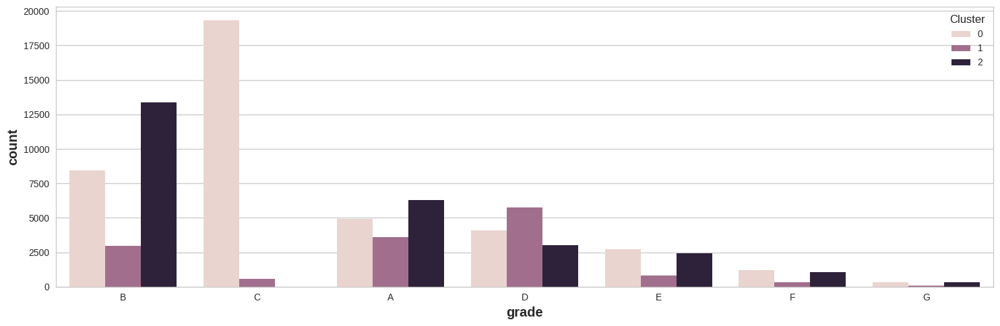

In [ ]:
plt.subplots(figsize = (15,5))
sns.countplot(x=kmode_data['grade'],order=kmode_data['grade'].value_counts().index,hue=kmode_data['Cluster'])
plt.show()

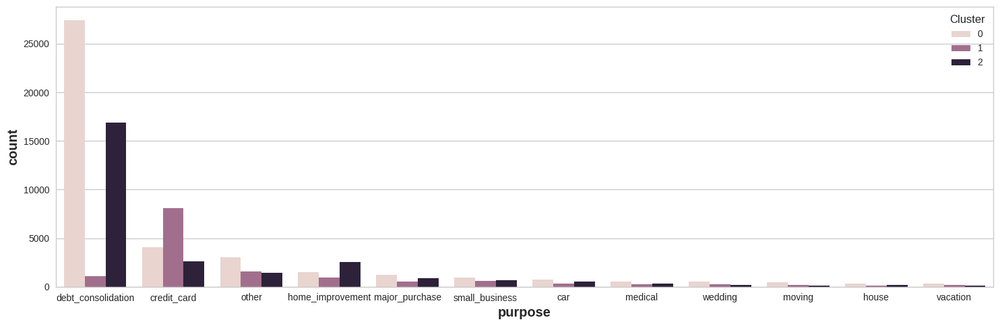

In [ ]:
plt.subplots(figsize = (15,5))
sns.countplot(x=kmode_data['purpose'],order=kmode_data['purpose'].value_counts().index,hue=kmode_data['Cluster'])
plt.show()

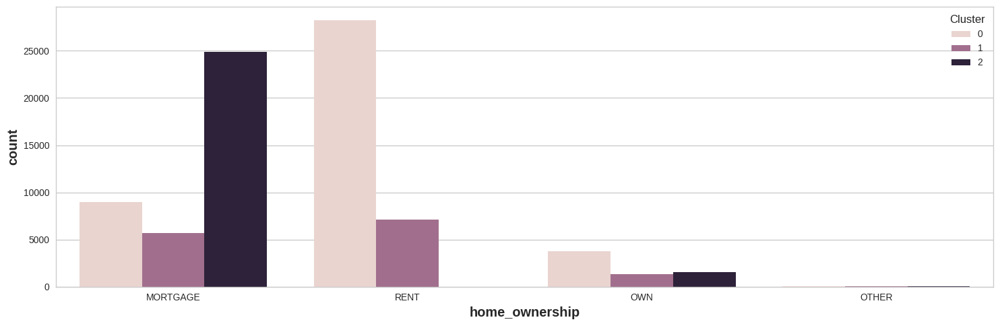

In [ ]:
plt.subplots(figsize = (15,5))
sns.countplot(x=kmode_data['home_ownership'],order=kmode_data['home_ownership'].value_counts().index,hue=kmode_data['Cluster'])
plt.show()

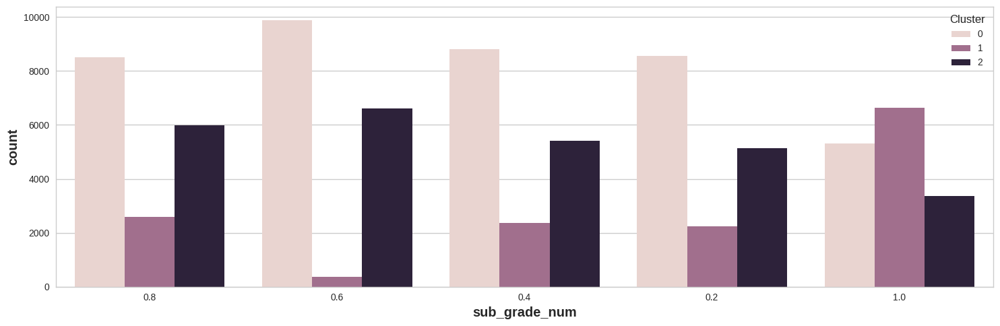

In [ ]:
plt.subplots(figsize = (15,5))
sns.countplot(x=kmode_data['sub_grade_num'],order=kmode_data['sub_grade_num'].value_counts().index,hue=kmode_data['Cluster'])
plt.show()

#**Clustering-2**


**k-prototype**

In [ ]:
X = data.copy()
true_label = X.pop('bad_loans')
numerical = data.select_dtypes(include='number')
categorical = data.select_dtypes(exclude='number')

In [ ]:
for c in numerical.columns:
    pt = PowerTransformer(method='yeo-johnson')
    numerical.loc[:, c] = pt.fit_transform(np.array(numerical[c]).reshape(-1, 1))

categorical = pd.get_dummies(categorical)

In [ ]:
#Percentage of columns which are categorical is used as weight parameter in embeddings later
categorical_weight = len(data.select_dtypes(exclude='number').columns) / data.shape[1]

#Embedding numerical & categorical
fit1 = UMAP(metric='l2').fit(numerical)
fit2 = UMAP(metric='dice').fit(categorical)

In [ ]:
# Assuming fit1 and fit2 are already fitted UMAP models
# Create the intersection of the two graphs
intersection = umap.umap_.general_simplicial_set_intersection(fit1.graph_, fit2.graph_, weight=categorical_weight)

# Reset the local connectivity of the intersection
intersection = umap.umap_.reset_local_connectivity(intersection)

# Define the additional required parameters
densmap_kwds = {}  # Dictionary of keyword arguments for DensMAP, empty if not used
output_dens = False  # Boolean indicating whether to output density information
gamma = 1.0  # Typical default value for gamma in UMAP
densmap = False  # Set to True if using DensMAP features, False otherwise

# Create the embedding using simplicial_set_embedding
embedding = umap.umap_.simplicial_set_embedding(
    data=fit1._raw_data,
    graph=intersection,
    n_components=fit1.n_components,
    initial_alpha=fit1._initial_alpha,
    a=fit1._a,
    b=fit1._b,
    negative_sample_rate=fit1.negative_sample_rate,
    n_epochs=200,
    init='random',
    random_state=np.random,
    metric=fit1.metric,
    metric_kwds=fit1._metric_kwds,
    parallel=False,
    verbose=fit1.verbose,  # Add verbosity if required
    densmap=densmap,
    densmap_kwds=densmap_kwds,
    output_dens=output_dens,
    gamma=gamma
)


In [ ]:
embedding

(array([[-0.917795  ,  1.135467  ],
        [-1.2333063 ,  0.03687614],
        [-0.36809215, -0.9165162 ],
        ...,
        [-5.4368773 ,  8.775877  ],
        [ 0.23168354, 18.786688  ],
        [19.490795  ,  3.588064  ]], dtype=float32),
 {})

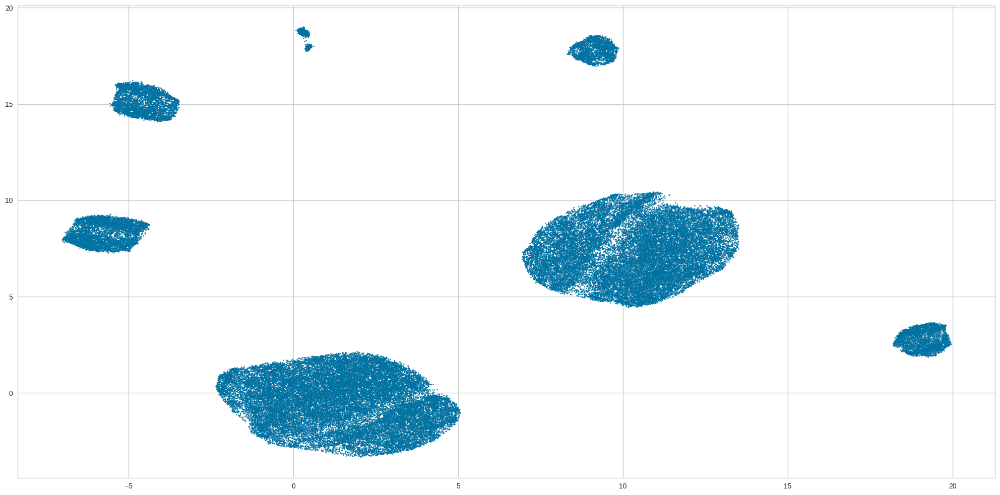

In [ ]:
plt.figure(figsize=(20, 10))
plt.scatter(*embedding[0].T, s=2, cmap='Spectral', alpha=1.0)
plt.show()

In [ ]:
#One-Hot-Encoding
data_k = pd.get_dummies(X)

#Pre-processing
for c in data_k.columns:
    pt = PowerTransformer()
    data_k.loc[:, c] = pt.fit_transform(np.array(data_k[c]).reshape(-1, 1))


#Elbow method to choose the optimal number of clusters
sse = {}
for k in tqdm(range(2, 11)):
    kmeans = KMeans(n_clusters=k, max_iter=1000, random_state=42).fit(data_k)
    sse[k] = kmeans.inertia_ # Inertia: Sum of distances of samples to their closest cluster center

# Using KneeLocator to find the optimal number of clusters
x = list(sse.keys())
y = list(sse.values())
kn = KneeLocator(x, y, curve='convex', direction='decreasing')
optimal_k = kn.knee

# Printing the optimal number of clusters
print(f"The optimal number of clusters is: {optimal_k}")

# Plotting the Elbow Plot
fig = go.Figure(data=go.Scatter(x=x, y=y))
fig.add_vline(x=optimal_k, line_width=2, line_dash="dash", line_color="red")  # Adding a vertical line at the optimal k
fig.update_layout(
    title="Elbow Method for Optimal k",
    xaxis_title="Number of Clusters (k)",
    yaxis_title="Inertia",
    xaxis=dict(tickmode='linear')
)
fig.show()

100%|██████████| 48/48 [01:03<00:00,  1.33s/it]

The optimal number of clusters is: 11


In [ ]:
# Training KMeans with the optimal number of clusters
kmeans = KMeans(n_clusters=optimal_k, max_iter=1000).fit(data_k)
kmeans_labels = kmeans.labels_

# If you want to see the cluster centers
cluster_centers = kmeans.cluster_centers_

print(f"Cluster centers:\n {cluster_centers}")

Cluster centers:
 [[ 6.94016456e-02  2.00499828e-01  1.09107521e-01  9.61001417e-02
  -4.05984102e-01  1.52494667e-01 -1.24029089e-02 -3.19174634e-01
   2.25153916e-01 -4.70445607e-01 -6.59493326e-01  1.76115473e+00
  -4.31836769e-01 -2.82017816e-01 -1.81652377e-01 -9.57778981e-02
   9.16918808e-02  7.10701910e-02 -3.01271399e-02 -7.47364314e-02
  -5.72372532e-02  3.74548080e-01 -3.74548080e-01 -2.11756723e-02
  -2.19896407e-02  6.82340692e-03  1.92660733e-02 -2.14575668e-02
  -4.68699139e-01  3.81466025e-01  1.63018717e-02  3.79041756e-03
   4.22208546e-04 -5.84943369e-04 -9.89156239e-02  2.05977740e-02
  -7.18731583e-03 -8.50495681e-02  1.67433241e-02 -4.05984700e-01
   4.05984700e-01 -8.36095753e-02  8.36095753e-02 -4.29312403e-02
   4.29312403e-02 -3.19174634e-01  3.19174634e-01]
 [-4.86325641e-02  3.51520332e-02  5.42093780e-02  1.93232576e-01
  -4.05984102e-01 -6.02451998e-02 -2.10523108e-01 -3.19174634e-01
   1.68885503e-01 -4.64848862e-01  4.58062969e-01 -5.67809279e-01
   3.72

In [ ]:
unique_clusters = np.unique(kmeans_labels)
print(f"Number of unique clusters: {len(unique_clusters)}")
print(f"Unique clusters: {unique_clusters}")

Number of unique clusters: 11
Unique clusters: [ 0  1  2  3  4  5  6  7  8  9 10]


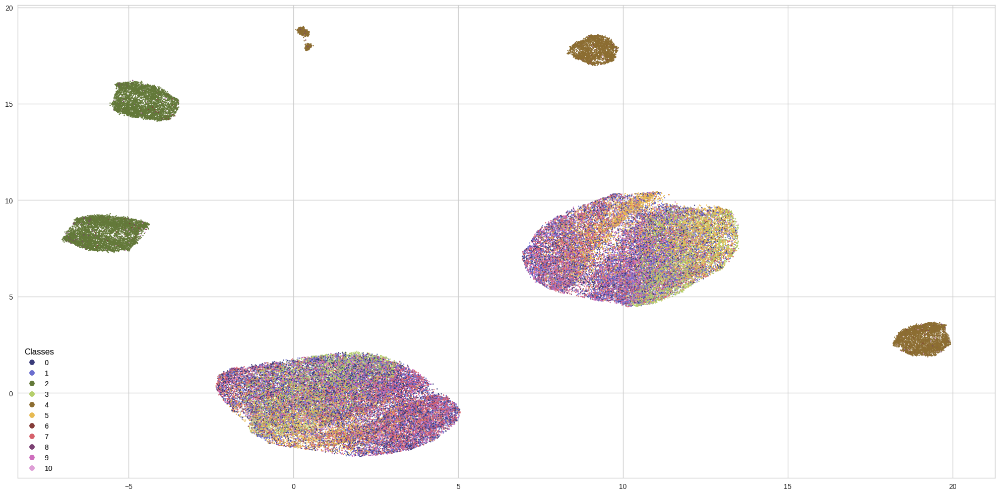

In [ ]:
fig, ax = plt.subplots()
fig.set_size_inches((20, 10))
scatter = ax.scatter(embedding[0][:, 0], embedding[0][:, 1], s=2, c=kmeans_labels, cmap='tab20b', alpha=1.0)

# produce a legend with the unique colors from the scatter
legend1 = ax.legend(*scatter.legend_elements(num=11),
                    loc="lower left", title="Classes")
ax.add_artist(legend1)


In [ ]:
results_df = evaluate_clustering(kmeans, true_label, data_k)
print(results_df)

   Silouette Score  V-Measure Score    ARI
0           0.0171           0.0014  0.002


In [ ]:
# getting categorical columns and their indices.
catColumnsPos = [X.columns.get_loc(col) for col in list(X.select_dtypes('category').columns)]
print('Categorical columns           : {}'.format(list(X.select_dtypes('category').columns)))
print('Categorical columns position  : {}'.format(catColumnsPos))

Categorical columns           : ['grade', 'sub_grade_num', 'short_emp', 'home_ownership', 'purpose', 'delinq_2yrs_zero', 'last_delinq_none', 'last_major_derog_none', 'pub_rec_zero']
Categorical columns position  : [1, 2, 3, 5, 7, 10, 12, 13, 16]


In [ ]:
kprot_data = data.copy()
#Pre-processing

for c in data.select_dtypes(include='number').columns:
    pt = PowerTransformer()
    kprot_data[c] =  pt.fit_transform(np.array(kprot_data[c]).reshape(-1, 1))
 #make sure to specify correct indices
# categorical_columns= [1,2,3,5,7,10,12,13,16]
#Actual clustering
kproto = KPrototypes(n_clusters= 5, init='Cao', n_jobs = 4)
clusters = kproto.fit_predict(kprot_data, categorical=catColumnsPos)

#Prints the count of each cluster group
pd.Series(clusters).value_counts()

#OPTIONAL: Elbow plot with cost (will take a LONG time)
costs = []
n_clusters = []
clusters_assigned = []

for i in tqdm(range(2, 6)):
    try:
        kproto = KPrototypes(n_clusters= i, init='Cao', verbose=2)
        clusters = kproto.fit_predict(kprot_data, categorical=catColumnsPos)
        costs.append(kproto.cost_)
        n_clusters.append(i)
        clusters_assigned.append(clusters)
    except:
        print(f"Can't cluster with {i} clusters")

fig = go.Figure(data=go.Scatter(x=n_clusters, y=costs ))
fig.show()

  9%|▊         | 2/23 [00:00<00:01, 15.12it/s]

Initialization method and algorithm are deterministic. Setting n_init to 1.
Can't cluster with 2 clusters
Initialization method and algorithm are deterministic. Setting n_init to 1.
Can't cluster with 3 clusters
Initialization method and algorithm are deterministic. Setting n_init to 1.
Can't cluster with 4 clusters
Initialization method and algorithm are deterministic. Setting n_init to 1.


 26%|██▌       | 6/23 [00:00<00:01, 15.31it/s]

Can't cluster with 5 clusters
Initialization method and algorithm are deterministic. Setting n_init to 1.
Can't cluster with 6 clusters
Initialization method and algorithm are deterministic. Setting n_init to 1.
Can't cluster with 7 clusters
Initialization method and algorithm are deterministic. Setting n_init to 1.
Can't cluster with 8 clusters
Initialization method and algorithm are deterministic. Setting n_init to 1.


 43%|████▎     | 10/23 [00:00<00:00, 15.91it/s]

Can't cluster with 9 clusters
Initialization method and algorithm are deterministic. Setting n_init to 1.
Can't cluster with 10 clusters
Initialization method and algorithm are deterministic. Setting n_init to 1.
Can't cluster with 11 clusters
Initialization method and algorithm are deterministic. Setting n_init to 1.
Can't cluster with 12 clusters
Initialization method and algorithm are deterministic. Setting n_init to 1.


 61%|██████    | 14/23 [00:00<00:00, 16.02it/s]

Can't cluster with 13 clusters
Initialization method and algorithm are deterministic. Setting n_init to 1.
Can't cluster with 14 clusters
Initialization method and algorithm are deterministic. Setting n_init to 1.
Can't cluster with 15 clusters
Initialization method and algorithm are deterministic. Setting n_init to 1.
Can't cluster with 16 clusters
Initialization method and algorithm are deterministic. Setting n_init to 1.


 78%|███████▊  | 18/23 [00:01<00:00, 15.53it/s]

Can't cluster with 17 clusters
Initialization method and algorithm are deterministic. Setting n_init to 1.
Can't cluster with 18 clusters
Initialization method and algorithm are deterministic. Setting n_init to 1.
Can't cluster with 19 clusters
Initialization method and algorithm are deterministic. Setting n_init to 1.
Can't cluster with 20 clusters
Initialization method and algorithm are deterministic. Setting n_init to 1.


100%|██████████| 23/23 [00:01<00:00, 15.70it/s]

Can't cluster with 21 clusters
Initialization method and algorithm are deterministic. Setting n_init to 1.
Can't cluster with 22 clusters
Initialization method and algorithm are deterministic. Setting n_init to 1.
Can't cluster with 23 clusters
Initialization method and algorithm are deterministic. Setting n_init to 1.
Can't cluster with 24 clusters


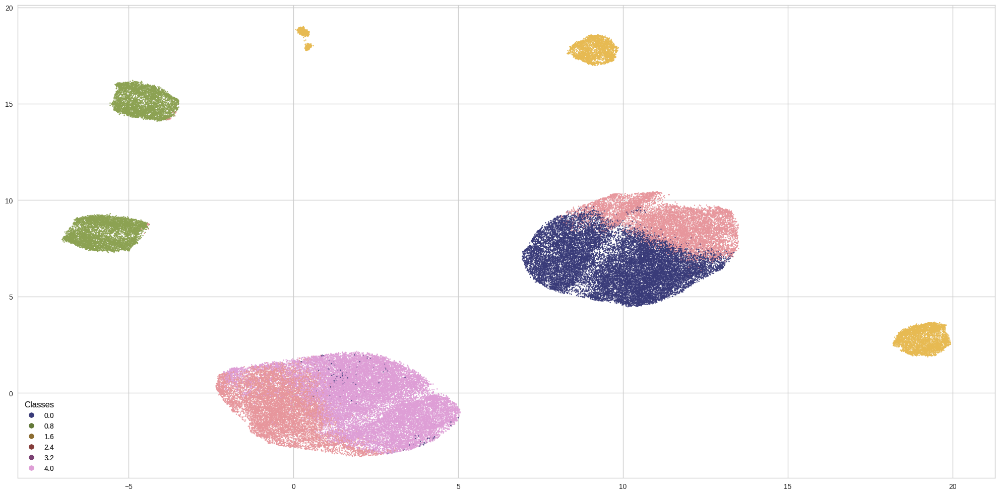

In [ ]:
fig, ax = plt.subplots()
fig.set_size_inches((20, 10))
scatter = ax.scatter(embedding[0][:, 0], embedding[0][:, 1], s=2, c=clusters, cmap='tab20b', alpha=1.0)

# produce a legend with the unique colors from the scatter
legend1 = ax.legend(*scatter.legend_elements(num=5),
                    loc="lower left", title="Classes")
ax.add_artist(legend1)

In [ ]:
#Setting the objects to category
lgbm_data = data.copy()
# for c in lgbm_data.select_dtypes(include='object'):
#     lgbm_data[c] = lgbm_data[c].astype('category')

#KMeans clusters
clf_km = LGBMClassifier(colsample_by_tree=0.8)
cv_scores_km = cross_val_score(clf_km, lgbm_data, kmeans_labels, scoring='f1_weighted')
print(f'CV F1 score for K-Means clusters is {np.mean(cv_scores_km)}')

[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009262 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1166
[LightGBM] [Info] Number of data points in the train set: 65390, number of used features: 19
[LightGBM] [Info] Start training from score -2.086532
[LightGBM] [Info] Start training from score -1.838948
[LightGBM] [Info] Start training from score -2.076601
[LightGBM] [Info] Start training from score -2.358242
[LightGBM] [Info] Start training from score -2.407283
[LightGBM] [Info] Start training from score -2.023735
[LightGBM] [Info] Start training from score -4.645584
[LightGBM] [Info] Start training from score -1.936791
[LightGBM] [Info] Start training from score -4.704618
[LightGBM] [Info] Start training from score -

In [ ]:
precision = precision_score(true_label, kmeans_labels, average='weighted')
recall = recall_score(true_label, kmeans_labels, average='weighted')
f1 = f1_score(true_label, kmeans_labels, average='weighted')

print("Precision:", precision)
print("Recall:", recall)
print("F1-score:", f1)

Precision: 0.6808060495890715
Recall: 0.13586092148082898
F1-score: 0.21060506144178068


In [ ]:
ari = adjusted_rand_score(true_label, kmeans_labels)


ami = adjusted_mutual_info_score(true_label, kmeans_labels)

print("Adjusted Rand Index (ARI):", ari)
print("Adjusted Mutual Information (AMI):", ami)

Adjusted Rand Index (ARI): 0.0024092245562414606
Adjusted Mutual Information (AMI): 0.008625431871010475


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015840 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1169
[LightGBM] [Info] Number of data points in the train set: 81738, number of used features: 19
[LightGBM] [Info] Start training from score -2.086439
[LightGBM] [Info] Start training from score -1.838954
[LightGBM] [Info] Start training from score -2.076632
[LightGBM] [Info] Start training from score -2.358281
[LightGBM] [Info] Start training from score -2.407187
[LightGBM] [Info] Start training from score -2.023788
[LightGBM] [Info] Start training from score -4.645591
[LightGBM] [Info] Start training from score -1.936776
[LightGBM] [Info] Start training from score -4.704624
[LightGBM] [Info] Start training from score -

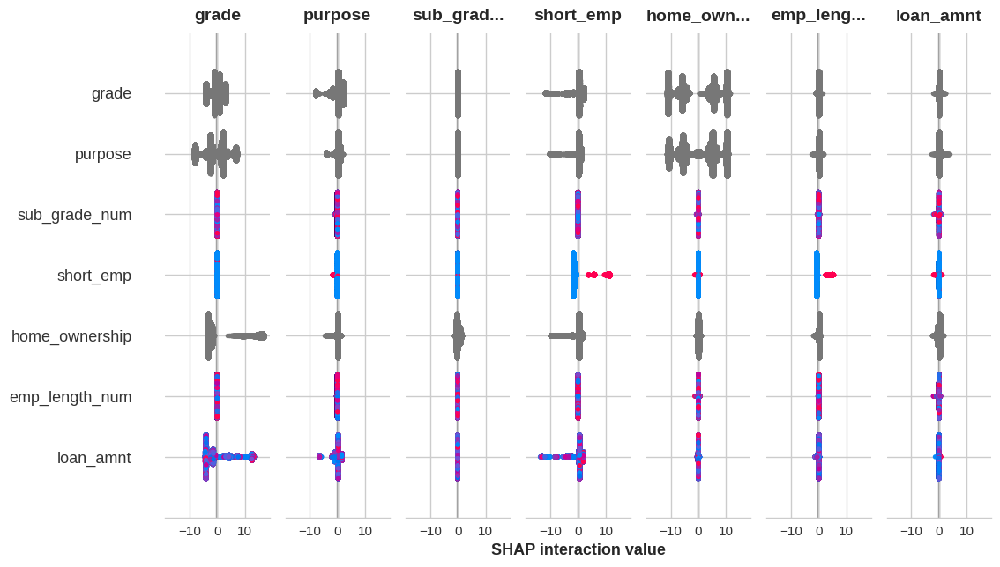

In [ ]:
#Fit the model
clf_km.fit(lgbm_data, kmeans_labels)

#SHAP values
explainer_km = shap.TreeExplainer(clf_km)
shap_values_km = explainer_km.shap_values(lgbm_data)
shap.summary_plot(shap_values_km, lgbm_data, plot_type="bar", plot_size=(15, 10))